# Motivation

The main idea behind the project was to explore the Star Wars universe and more specifically to see how the movies changed from 1977 to 2005. 
The data that we used came from the Star Wars Wikia page and the script of the six movies.
Finally, we wanted to discover how important are our characters and why the episodes IV, V and VI are considered the best in the Star Wars universe.

Link to webpage: https://chrypapado.github.io/Star_Wars/
  
Link to video: [Social Graphs and Interactions (Short Video Presentation)](https://www.youtube.com/watch?v=0QLFTrSzWdM&ab_channel=%CE%A7%CF%81%CF%85%CF%83%CF%8C%CF%83%CF%84%CE%BF%CE%BC%CE%BF%CF%82%CE%A0%CE%B1%CF%80%CE%B1%CE%B4%CF%8C%CF%80%CE%BF%CF%85%CE%BB%CE%BF%CF%82)

<span style="color:red">In order to run the notebook successfully you need to have in the same directory the folder **Files**, which contains the dictionary for the LabMT sentiment analysis and the images for the wordclouds</span>

# Basic stats. Let's understand the dataset better

As we had two different datasets, we wanted to perform similar analysis and see how the Wikia page differs from the movies. First we had to clear everything, as it mostly consists of text. So we downloaded every character from the Wikia data source and we also downloaded every script and edited in order to be useful. We splited the movies into scenes, and extracted every line a character would say.

From the Wikia page we created two networks, one for the whole universe and one that only concentrates to the characters that took part in the movie. 

The first network had 4001 nodes with 12706 edges, while creating 447 communities. The second network had 218 nodes with 1128 edges and 26 communities.

Then we created the networks for the movies. Firstly we considered all the movies an one and created a network with 223 nodes, 1404 edges and 22 communities. Then, as we wanted to compare the two trilogies that took place in completely different years, we splitted the movies into two trilogies and created a network for the first trilogy with 115 nodes, 780 edges and 10 communities, with the second trilogy to have 120 nodes, 630 edges and 18 communities.

Furthermore, we dig deeper to every episode individually to explore more possibillities.

### Libraries

In [1]:
import re
import os
import ast
import nltk
import json
import urllib
import httplib2
import requests
import numpy as np
import pandas as pd
from PIL import Image
import networkx as nx
from pathlib import Path
from nltk import FreqDist
from fa2 import ForceAtlas2
from string import punctuation
from nltk import word_tokenize
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from nltk.corpus import stopwords
from urllib.request import urlopen
import community as community_louvain
from bs4 import BeautifulSoup, SoupStrainer
from nltk.tokenize import WordPunctTokenizer
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

from bokeh.plotting import figure
from bokeh.palettes import Viridis
from bokeh.plotting import from_networkx
from bokeh.io import output_notebook, show, save, output_file
from bokeh.models import Plot, Range1d, Circle, ColumnDataSource, MultiLine, HoverTool

### Scripts

In [2]:
def community_name(G, node_to_partition_id, partition_id):
    
    nodes_in_partition = [node for node in G.nodes() 
                          if node_to_partition_id[node] == partition_id]
    sub_G = G.subgraph(nodes_in_partition)
    node_to_connectivity = [(node, sub_G.degree(node)) for node in sub_G.nodes()]
    top_node = sorted(node_to_connectivity, key=lambda t: t[1], reverse=True)[:1]
    return top_node

def frequent(text):
    stopword = stopwords.words()
    #content = [w for w in text if w.lower() not in stopword]
    content = [w for w in text]
    cfd = FreqDist(content)
    mostcommon = cfd.most_common(100)
    return mostcommon

def sentiment_function(tokens, LabMT_dict):
    text = nltk.Text(tokens)
    freq_text = nltk.FreqDist(text)
    hapiness = {k:v for k,v in LabMT_dict.items() if k in tokens}
    hapiness_dict = dict(sorted(hapiness.items()))
    freq_all = sum(freq_text.values())
    hapiness_norm = {k:v/freq_all for k,v in freq_text.items()}
    hapiness_dict_norm = dict(sorted(hapiness_norm.items()))
    sentiment = sum(hapiness_dict[k]*hapiness_dict_norm[k] for k in hapiness_dict)
    return sentiment

def compute_sentiment_VADER(tokens):
    analyzer = SentimentIntensityAnalyzer()
    sentiment = np.mean([analyzer.polarity_scores(sentence)['compound'] for sentence in tokens])
    return sentiment

#### Create the directories

In [3]:
Path("HTML").mkdir(parents=True, exist_ok=True)
Path("Data").mkdir(parents=True, exist_ok=True)
Path("Data/Characters").mkdir(parents=True, exist_ok=True)
Path("Data/Episodes").mkdir(parents=True, exist_ok=True)
Path("Data/Scripts").mkdir(parents=True, exist_ok=True)
Path("Images").mkdir(parents=True, exist_ok=True)
Path("Images/Networks").mkdir(parents=True, exist_ok=True)
Path("Images/Plots").mkdir(parents=True, exist_ok=True)
Path("Images/Wordclouds").mkdir(parents=True, exist_ok=True)
Path("Images/Wordclouds/Episode_I").mkdir(parents=True, exist_ok=True)
Path("Images/Wordclouds/Episode_II").mkdir(parents=True, exist_ok=True)
Path("Images/Wordclouds/Episode_III").mkdir(parents=True, exist_ok=True)
Path("Images/Wordclouds/Episode_IV").mkdir(parents=True, exist_ok=True)
Path("Images/Wordclouds/Episode_V").mkdir(parents=True, exist_ok=True)
Path("Images/Wordclouds/Episode_VI").mkdir(parents=True, exist_ok=True)
Path("Images/Wordclouds/Overall").mkdir(parents=True, exist_ok=True)
Path("Token_Char").mkdir(parents=True, exist_ok=True)
Path("Token_Char/Episode_I").mkdir(parents=True, exist_ok=True)
Path("Token_Char/Episode_II").mkdir(parents=True, exist_ok=True)
Path("Token_Char/Episode_III").mkdir(parents=True, exist_ok=True)
Path("Token_Char/Episode_IV").mkdir(parents=True, exist_ok=True)
Path("Token_Char/Episode_V").mkdir(parents=True, exist_ok=True)
Path("Token_Char/Episode_VI").mkdir(parents=True, exist_ok=True)
Path("Token_Char/Overall").mkdir(parents=True, exist_ok=True)

## Wikia Data Source

#### Extract every planet that characters reside

Due to the fact that, in the Star Wars wikia page there isn't any available source that could classify the characters in a few important categories, it was decided that it would be most interesting to be sorted by the planet on which they reside

In [4]:
planets = []

page_title = "https://starwars.fandom.com/wiki/Category:Individuals_by_planet"
title = f"titles={page_title}"
page = requests.get(page_title)
soup = BeautifulSoup(page.content, "html.parser")
planet_pattern = re.compile(r'/wiki/(.*)')
for link in soup.find_all("a", {"class": "category-page__member-link"}):
    href = link.get("href")
    name =  planet_pattern.match(href).group(1)
    planets.append(name)

#### Extract these characters along with the information on where they reside

In [5]:
char = pd.DataFrame(columns = ['Name', 'Residence'])

for planet in planets:
    characters = []

    page_title = "https://starwars.fandom.com/wiki/" + planet   
    title = f"titles={page_title}"
    page = requests.get(page_title)
    soup = BeautifulSoup(page.content, "html.parser")
    character_pattern = re.compile(r'/wiki/(.*)')
    category_pattern = re.compile(r'Category:')
    legend_pattern = re.compile(r'(.*)/Legends')
    for link in soup.find_all("a", {"class": "category-page__member-link"}):
        href = link.get("href")
        name =  character_pattern.match(href).group(1)
        if not category_pattern.match(name) and not legend_pattern.match(name):
            characters.append(name)
    temp_char = pd.DataFrame(characters, columns=['Name'])
    temp_char['Residence'] = planet[9:]
    char = char.append(temp_char)

#### Add characters from planets with more than one page

There are planets, where their pages are more than one and with the above method the characters on the next pages are not added. So the below code will be implemented in order to add them all

In [6]:
rest_pages = {'Alderaanians' : ['https://starwars.fandom.com/wiki/Category:Alderaanians?from=Othona%2C+Dalus%0ADalus+Othona'],
              'Corellians' : ['https://starwars.fandom.com/wiki/Category:Corellians?from=Forte%2C+Crale%0ACrale+Forte', 'https://starwars.fandom.com/wiki/Category:Corellians?from=Mullawny%2C+Stax%0AStax+Mullawny', 'https://starwars.fandom.com/wiki/Category:Corellians?from=Vergesso%2C+Ecile%0AEcile+Vergesso'],
              'Coruscanti' : ['https://starwars.fandom.com/wiki/Category:Coruscanti?from=Jool', 'https://starwars.fandom.com/wiki/Category:Coruscanti?from=Sel%27Sabagno%2C+Elan%0AElan+Sel%27Sabagno%2FLegends'],
              'Naboo' : ['https://starwars.fandom.com/wiki/Category:Naboo?from=Unidentified+Naboo+girl'],
              'Tatooinians' : ['https://starwars.fandom.com/wiki/Category:Tatooinians?from=Drow%2C+Vek%0AVek+Drow', 'https://starwars.fandom.com/wiki/Category:Tatooinians?from=Kithaba%2FLegends', 'https://starwars.fandom.com/wiki/Category:Tatooinians?from=Rile%2C+Chastina%0AChastina+Rile', 'https://starwars.fandom.com/wiki/Category:Tatooinians?from=Venn%2C+Tanis%0ATanis+Venn']}

for k in rest_pages.keys():
    planet = 'Category:' + k
    for page_title in rest_pages[k]:
        characters = []
        title = f"titles={page_title}"
        page = requests.get(page_title)
        soup = BeautifulSoup(page.content, "html.parser")
        character_pattern = re.compile(r'/wiki/(.*)')
        category_pattern = re.compile(r'Category:')
        legend_pattern = re.compile(r'(.*)/Legends')
        for link in soup.find_all("a", {"class": "category-page__member-link"}):
            href = link.get("href")
            name =  character_pattern.match(href).group(1)
            if not category_pattern.match(name) and not legend_pattern.match(name):
                characters.append(name)
        temp_char = pd.DataFrame(characters, columns=['Name'])
        temp_char['Residence'] = planet[9:]
        char = char.append(temp_char)

#### Create the DataFrame for the characters

In [7]:
char['Name'] = char['Name'].str.replace('%C3%A9','é')
char['Name'] = char['Name'].str.replace('%C3%B3','ó')
char['Name'] = char['Name'].str.replace('%C3%A7','ç')
char['Name'] = char['Name'].str.replace('%C3%A1','á')
char['Name'] = char['Name'].str.replace('%60','`')
char['Name'] = char['Name'].str.replace('%22','"')
char['Name'] = char['Name'].str.replace('%27',"'")
char['Residence'] = char['Residence'].str.replace('%27',"'")
char = char[char['Name']!='User:Hk_47/WiP2']
char = char.drop_duplicates(subset='Name')
char = char.sort_values(by=['Name'])
char = char[~char['Name'].str.contains('/')]
char = char.reset_index(drop=True)
char['Name'] = char['Name'].str.replace('_'," ")
char['Residence'] = char['Residence'].str.replace('_'," ")

#### Create the characters directory with every character's page

In [8]:
temp_name = char['Name'].str.replace(' ',"_")

for i in range(len(char)):
    baseurl = "https://starwars.fandom.com/api.php?"
    action = "action=query"
    title = "titles=" + urllib.parse.quote_plus(temp_name[i])
    content = "prop=revisions&rvprop=content&rvslots=*"
    dataformat = "format=json"
    query = "{}{}&{}&{}&{}".format(baseurl, action, content, title, dataformat)
    
    response = urlopen(query)
    source = response.read()
    query_json = json.loads(source)
    text_name = temp_name[i] + '.txt'
    temp = './Data/Characters/' + text_name
    with open(temp, 'w') as outfile:
        json.dump(query_json, outfile)

#### Add attributes to every character

In [9]:
for filename in os.listdir(os.path.join(os.getcwd(), 'Data/Characters')):
    with open(os.path.join(os.path.join(os.getcwd(), 'Data/Characters'), filename), 'r') as f:
        contents = f.read()
        query_json = ast.literal_eval(contents)
        page_id = list(query_json['query']['pages'].keys())[0]
        string = query_json['query']['pages'][page_id]['revisions'][0]['slots']['main']['*']
        
        name = filename[:-4].replace('_',' ')
        
        # Add homeworld attribute
        if re.findall('homeworld=\[\[(.*?)\/(?:.*?)?\]\]', string) != []:
            homeworld = re.findall('homeworld=\[\[(.*?)\/(?:.*?)?\]\]', string)
        elif re.findall('homeworld=\[\[(.*?)\]\]', string) != []:
            homeworld = re.findall('homeworld=\[\[(.*?)\]\]', string)
        else:
            homeworld = ['Unknown']
        char.loc[char['Name']==name, 'Homeworld'] = homeworld
        
        # Add species attribute
        if re.findall('species=\[\[(.*?)(?:\/.*?)?(?:\|.*?)?(?:\(.*?)?\]\]', string) != []:
            species = re.findall('species=\[\[(.*?)(?:\/.*?)?(?:\|.*?)?(?:\(.*?)?\]\]', string)
        else:
            species = ['Unknown']
        char.loc[char['Name']==name, 'Species'] = species[0]
        
        # Add gender
        if re.findall('gender=\[\[Gender(?:\/.*?)?\|(.*?)\]\]', string) != []:
            gender = re.findall('gender=\[\[Gender(?:\/.*?)?\|(.*?)\]\]', string)[0] 
            gender = gender.replace('Masculine Programming', 'Masculine programming').replace('Males', 'Male').replace('male', 'Male').replace('feMale', 'Female').replace('FeMale', 'Female').replace('Females', 'Female')
        else:
            gender = 'Unknown'
        char.loc[char['Name']==name, 'Gender'] = gender

#### Download the episodes pages

In [10]:
episodes = ['Episode I', 'Episode II', 'Episode III', 'Episode IV', 'Episode V', 'Episode VI']
episodes_pages = ['Star_Wars:_Episode_I_The_Phantom_Menace',
                  'Star_Wars:_Episode_II_Attack_of_the_Clones',
                  'Star_Wars:_Episode_III_Revenge_of_the_Sith',
                  'Star_Wars:_Episode_IV_A_New_Hope',
                  'Star_Wars:_Episode_V_The_Empire_Strikes_Back',
                  'Star_Wars:_Episode_VI_Return_of_the_Jedi']

for i in range(len(episodes)):
    baseurl = "https://starwars.fandom.com/api.php?"
    action = "action=query"
    title = "titles=" + urllib.parse.quote_plus(episodes_pages[i])
    content = "prop=revisions&rvprop=content&rvslots=*"
    dataformat = "format=json"
    query = "{}{}&{}&{}&{}".format(baseurl, action, content, title, dataformat)
    
    response = urlopen(query)
    source = response.read()
    query_json = json.loads(source)
    text_name = episodes[i] + '.txt'
    temp = './Data/Episodes/' + text_name
    with open(temp, 'w') as outfile:
        json.dump(query_json, outfile)

#### Find the characters from the six episodes 

In [11]:
for filename in os.listdir(os.path.join(os.getcwd(), 'Data/Episodes')):
    with open(os.path.join(os.path.join(os.getcwd(), 'Data/Episodes'), filename), 'r') as f:
        contents = f.read()
        query_json = ast.literal_eval(contents)
        page_id = list(query_json['query']['pages'].keys())[0]
        string = query_json['query']['pages'][page_id]['revisions'][0]['slots']['main']['*']
        pattern = '\[\[(.*?)(?:\|.*?)?\]\]'
        temp = re.findall(pattern, string)
        temp = list(char[char['Name'].isin(temp)]['Name'].drop_duplicates())
        char[filename[:-4]] = 0
        char.loc[char['Name'].isin(temp), filename[:-4]] = 1

#### Rearrange columns and create trilogy columns

In [12]:
columns = ['Name', 'Homeworld', 'Residence', 'Species', 'Gender', 
           'Episode I', 'Episode II', 'Episode III', 'Episode IV', 'Episode V', 'Episode VI']

char = char[columns]

char.loc[:,'First Trilogy'] = 0
char.loc[:,'Second Trilogy'] = 0
idx = (char['Episode I']==1)|(char['Episode II']==1)|(char['Episode III']==1)
char.loc[idx, 'First Trilogy'] = 1
idx = (char['Episode IV']==1)|(char['Episode V']==1)|(char['Episode VI']==1)
char.loc[idx, 'Second Trilogy'] = 1

#### Save dataframe

In [13]:
char.to_csv('./Data/Characters.csv', index=False)

## Scripts

#### Download the scripts of the six episodes

In [14]:
http = httplib2.Http()

scripts = []
films = ['https://imsdb.com/scripts/Star-Wars-The-Phantom-Menace.html',
         'https://imsdb.com/scripts/Star-Wars-Attack-of-the-Clones.html',
         'https://imsdb.com/scripts/Star-Wars-A-New-Hope.html',
         'https://imsdb.com/scripts/Star-Wars-The-Empire-Strikes-Back.html',
         'https://imsdb.com/scripts/Star-Wars-Return-of-the-Jedi.html']

for film in films:
    film_name = film.strip('http://www.imsdb.com/scripts/')
    film_name = film_name.replace('.html','')
    film_name = film_name.replace(':', '')
    status, response = http.request(film)
    filename ='./Data/Scripts/' + film_name + '.txt'
    for link in BeautifulSoup(response, parse_only = SoupStrainer('pre')):
        scripts = link.text
        with open(filename, "w", encoding='utf-8', errors='ignore') as f:
            for script in scripts:
                f.write(script)

scripts = []                
film = 'https://imsdb.com/scripts/Star-Wars-Revenge-of-the-Sith.html'
film_name = film.strip('http://www.imsdb.com/scripts/')
film_name = film_name.replace('.html','')
film_name = film_name.replace(':', '')
status, response = http.request(film)
filename ='./Data/Scripts/' + film_name + '.txt'
for link in BeautifulSoup(response, parse_only = SoupStrainer('body')):
    scripts = link.text
    scripts = scripts[scripts.find('STAR WARS'):]
    with open(filename, "w", encoding='utf-8', errors='ignore') as f:
        for script in scripts:
            f.write(script)

#### Create the dataframes

In [15]:
data_movie = pd.DataFrame(columns=['Scene_Title','Scene_Description', 'Scene_Characters', 'Scene_Dialogue', 'Movie'])
data_lines = pd.DataFrame(columns=['Character', 'Line', 'Movie'])

#### Functions to help us with the script

#### Split the script into rows

In [16]:
def split_script_to_rows(script):
    temp_script = []
    for row in script:
        row = re.sub(r'\(.*\)', '', row)
        row = re.sub(r'\-|\#\d+', '', row)
        temp_script.append(row.replace('\t', ' ').lstrip(" "))
    return temp_script

#### Find the name of every scene

In [17]:
def find_scenes(temp_script):
    scenes = []
    for row in temp_script:
        scene = re.search(r'(((INT\.|EXT\.)\s[A-Z]+)|((INT\.|EXT\.)\s+[A-Z]+\W+.+))', row)
        if scene:
            scenes.append(row[:-1])
    return scenes

def find_scenes_EP_VI(temp_script):
    scenes = []
    for row in temp_script:
        scene = re.search(r'(INT|EXT)', row)
        if scene:
            scenes.append(row[:-1])
    return scenes

#### Find the character from every line

In [18]:
def find_lines_character(temp_script):
    characters = []
    for row in temp_script:
        char = re.findall(r'(^[A-Z]+[A-Z]+\n)|(^[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\n)', row)
        if char:
            untupled_char = [tuple(filter(None, i)) for i in char]
            characters.append(untupled_char)
    characters = [x[0][0][:-1] for x in characters]
    return characters

def find_lines_character_EP_I(temp_script):
    characters = []
    for row in temp_script:
        char = re.findall(r'(^[A-Z]+[A-Z]+ :)|(^[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+ :)|(^[A-Za-z0-9_-]+ :)', row)
        if char:
            untupled_char = [tuple(filter(None, i)) for i in char]
            characters.append(untupled_char)
    characters = [x[0][0][:-1] for x in characters]
    return characters

def find_lines_character_EP_III(temp_script):
    characters = []
    for row in temp_script:
        char = re.findall(r'(^[A-Z]+[A-Z]+:)|(^[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+:)', row)
        if char:
            untupled_char = [tuple(filter(None, i)) for i in char]
            characters.append(untupled_char)
    characters = [x[0][0][:-1] for x in characters]
    return characters

#### All the script by adding a keyword to every change of scene

In [19]:
def change_scene(script):
    text = []
    for row in script:
        row = row.replace('\t', ' ').lstrip(" ")
        row = re.sub(r'(((INT\.|EXT\.)\s[A-Z]+)|((INT\.|EXT\.)\s+[A-Z]+\W+.+))', 'SPLIT', row)
        row = re.sub(r'^\W+', r'', row)
        row = re.sub(r"[^a-zA-Z0-9.,?'&\n ]+", '', row)
        text.append(row)

    text = "".join([s for s in text if s.strip()])
    text = re.sub(r'\nTHE END\n(.|\n)*', '', text)
    return text

def change_scene_EP_VI(script):
    text = []
    for row in script:
        row = row.replace('\t', ' ').lstrip(" ")
        row = re.sub(r'(INT|EXT)', 'SPLIT', row)
        row = re.sub(r'^\W+', r'', row)
        row = re.sub(r"[^a-zA-Z0-9.,?'&\n ]+", '', row)
        text.append(row)
    text = "".join([s for s in text if s.strip()])
    text = re.sub(r'\nTHE END\n(.|\n)*', '', text)
    return text

#### Script's dialogues

In [20]:
def every_dialogue(text, characters, movie):
    scene_dialogue, scene_description, char_turn = [], [], []
    every_lines_char, every_chars_line = [], []
    scenes_loop = text.split('SPLIT')[1:]
    for scene in scenes_loop:
        scene_line = re.compile('(\n[A-Z]+[A-Z]+\n)|(\n[A-Z]+[A-Z]+\s+\n)|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+\n)\
        |(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\n)|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\n)\
        |(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\n)|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\s+\n)').split(scene)
        scene_line = [x for x in scene_line if x != None]
        char_line = re.findall('(\n[A-Z]+[A-Z]+\n)|(\n[A-Z]+[A-Z]+\s+\n)|(\n[A-Z]+\.\s+[A-Z]+\n)|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+\n)\
        |(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\n)|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\n)|(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\n)\
        |(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\n)|(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\s+\n)|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\s+\n)\
        |(\n[A-Z]+[A-Z]+\s+\&\s+[A-Z]+[A-Z]+\n)|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\n)', scene)
        tupled_char = []
        for line in char_line:
            temp_line = tuple(filter(None, line))
            tupled_char.append(temp_line)
        untupled_char = [x[0] for x in tupled_char]
        ordered_char = []
        for c in untupled_char:
            temp_char = c.replace('\n', '').strip()
            if temp_char in characters:
                ordered_char.append(c)
        dial=False
        temp_scene_description = []
        for i in range(len(scene_line)):
            if scene_line[i] in ordered_char:
                dial = True
                continue
            if dial==True:
                dial=False
                continue
            temp_scene_description.append(scene_line[i])
        scene_description.append(temp_scene_description)
        if ordered_char != []:
            temp_dialogue = []
            temp_char_turn = [] 
            for i, line in enumerate(scene_line):
                if line in ordered_char:
                    every_lines_char.append(line)
                    every_chars_line.append(scene_line[i+1])
                    temp_char_turn.append(line)
                    temp_dialogue.append(scene_line[i+1])
                    every_lines_char = [re.sub(r'\n', r' ', y).strip() for y in every_lines_char]
                    every_chars_line = [re.sub(r'\n', r' ', y) for y in every_chars_line]
                    every_chars_line = [re.sub(r'into comlink', r'', y) for y in every_chars_line]
                    every_chars_line = [re.sub(r'over comlink', r'', y) for y in every_chars_line]
                    temp_char_turn = [re.sub(r'\n', r' ', y).strip() for y in temp_char_turn]
                    temp_dialogue = [re.sub(r'\n', r' ', dial) for dial in temp_dialogue]
                    temp_dialogue = [re.sub(r'into comlink', r'', dial) for dial in temp_dialogue]
                    temp_dialogue = [re.sub(r'over comlink', r'', dial) for dial in temp_dialogue]
            scene_dialogue.append(temp_dialogue)
            char_turn.append(temp_char_turn)
        else:    
            scene_dialogue.append(None)
            char_turn.append(None)
    #scene_description = [re.sub(r'\n', r' ', x).strip() for x in scene_description]
    movie = [movie]*len(scenes)
    movie_data = list(zip(scenes, scene_description, char_turn, scene_dialogue, movie))
    dial_data = list(zip(every_lines_char, every_chars_line, movie))
    return movie_data, dial_data

def every_dialogue_EP_I(text, characters, movie):
    scene_dialogue, scene_description, char_turn = [], [], []
    every_lines_char, every_chars_line = [], []
    scenes_loop = text.split('SPLIT')[1:]
    for scene in scenes_loop:
        scene_line = re.compile('(\n[A-Z]+[A-Z]+  )|(\n[A-Z]+[A-Z]+\s+  )|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+  )\
        |(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+  )|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+  )\
        |(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+  )|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\s+)|(?=(\n[A-Z][a-z]+\s+[A-Z][a-z]+))').split(scene)
        scene_line = [x for x in scene_line if x != None]
        char_line = re.findall('(\n[A-Z]+[A-Z]+  )|(\n[A-Z]+[A-Z]+\s+  )|(\n[A-Z]+\.\s+[A-Z]+  )|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+  )\
        |(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+  )|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+  )|(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+  )\
        |(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+  )|(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\s+  )|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\s+  )\
        |(\n[A-Z]+[A-Z]+\s+\&\s+[A-Z]+[A-Z]+  )|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+  )', scene)
        tupled_char = []
        for line in char_line:
            temp_line = tuple(filter(None, line))
            tupled_char.append(temp_line)
        untupled_char = [x[0] for x in tupled_char]
        ordered_char = []
        for c in untupled_char:
            temp_char = c.replace('\n', '').strip()
            if temp_char in characters:
                ordered_char.append(c)
        dial=False
        temp_scene_description = []
        for i in range(len(scene_line)):
            if scene_line[i] in ordered_char:
                dial = True
                continue
            if dial==True:
                dial=False
                continue
            temp_scene_description.append(scene_line[i])
        scene_description.append(temp_scene_description)
        if ordered_char != []:
            temp_dialogue = []
            temp_char_turn = []
            for i, line in enumerate(scene_line):
                if line in ordered_char:
                    every_lines_char.append(line)
                    every_chars_line.append(scene_line[i+1])
                    temp_char_turn.append(line)
                    temp_dialogue.append(scene_line[i+1])
                    every_lines_char = [re.sub(r'\n', r' ', y).strip() for y in every_lines_char]
                    every_chars_line = [re.sub(r'\n', r' ', y) for y in every_chars_line]
                    temp_char_turn = [re.sub(r'\n', r' ', y).strip() for y in temp_char_turn]
                    temp_dialogue = [re.sub(r'\n', r' ', dial) for dial in temp_dialogue]
            scene_dialogue.append(temp_dialogue)
            char_turn.append(temp_char_turn)
        else:    
            scene_dialogue.append(None)
            char_turn.append(None)
    #scene_description = [re.sub(r'\n', r' ', x).strip() for x in scene_description]
    movie = [movie]*len(scenes)
    movie_data = list(zip(scenes, scene_description, char_turn, scene_dialogue, movie))
    dial_data = list(zip(every_lines_char, every_chars_line, movie))
    return movie_data, dial_data

def every_dialogue_EP_III(text, characters, movie):
    scene_dialogue, scene_description, char_turn = [], [], []
    every_lines_char, every_chars_line = [], []
    scenes_loop = text.split('SPLIT')[1:]
    for scene in scenes_loop:
        scene_line = re.compile('(\n[A-Z]+[A-Z])|(\n[A-Z]+[A-Z]+\s)|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s)\
        |(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z])|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z])\
        |(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z])|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\s+)').split(scene)
        scene_line = [x for x in scene_line if x != None]
        char_line = re.findall('(\n[A-Z]+[A-Z])|(\n[A-Z]+[A-Z]+\s)|(\n[A-Z]+\.\s+[A-Z])|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s)\
        |(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+[A-Z]+[A-Z])|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z])|(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\s+[A-Z]+[A-Z])\
        |(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z])|(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\s)|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\s)\
        |(\n[A-Z]+[A-Z]+\s+\&\s+[A-Z]+[A-Z])|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z])', scene)
        tupled_char = []
        for line in char_line:
            temp_line = tuple(filter(None, line))
            tupled_char.append(temp_line)
        untupled_char = [x[0] for x in tupled_char]
        ordered_char = []
        for c in untupled_char:
            temp_char = c.replace('\n', '').strip()
            if temp_char in characters:
                ordered_char.append(c)
        dial=False
        temp_scene_description = []
        for i in range(len(scene_line)):
            if scene_line[i] in ordered_char:
                dial = True
                continue
            if dial==True:
                dial=False
                continue
            temp_scene_description.append(scene_line[i])
        scene_description.append(temp_scene_description)
        if ordered_char != []:
            temp_dialogue = []
            temp_char_turn = []
            for i, line in enumerate(scene_line):
                if line in ordered_char:
                    every_lines_char.append(line)
                    every_chars_line.append(scene_line[i+1])
                    temp_char_turn.append(line)
                    temp_dialogue.append(scene_line[i+1])
                    every_lines_char = [re.sub(r'\n', r' ', y).strip() for y in every_lines_char]
                    every_chars_line = [re.sub(r'\n', r' ', y) for y in every_chars_line]
                    temp_char_turn = [re.sub(r'\n', r' ', y).strip() for y in temp_char_turn]
                    temp_dialogue = [re.sub(r'\n', r' ', dial) for dial in temp_dialogue]
            scene_dialogue.append(temp_dialogue)
            char_turn.append(temp_char_turn)
        else:    
            scene_dialogue.append(None)
            char_turn.append(None)
    #scene_description = [re.sub(r'\n', r' ', x).strip() for x in scene_description]
    movie = [movie]*len(scenes)
    movie_data = list(zip(scenes, scene_description, char_turn, scene_dialogue, movie))
    dial_data = list(zip(every_lines_char, every_chars_line, movie))
    return movie_data, dial_data

### The Phantom Menace

In [21]:
with open('./Data/Scripts/Star-Wars-The-Phantom-Menace.txt', "r", encoding='utf-8', errors='ignore') as f:
    script = [row for row in f]
    
scenes = find_scenes(split_script_to_rows(script))
characters = find_lines_character_EP_I(split_script_to_rows(script))
# Remove space after name and remove a non-character name (Hardcoded)
characters = [x[:-1] for x in characters]
characters.pop(0)

text = change_scene(script)
temp_movie, temp_dial = every_dialogue_EP_I(text, characters, 'Episode I')
temp_movie = pd.DataFrame(temp_movie, columns=['Scene_Title','Scene_Description', 'Scene_Characters', 'Scene_Dialogue', 'Movie'])
temp_dial = pd.DataFrame(temp_dial, columns=['Character', 'Line', 'Movie'])

data_movie = pd.concat([data_movie, temp_movie], axis=0)
data_lines = pd.concat([data_lines, temp_dial], axis=0)

### Attack of the Clones

In [22]:
with open('./Data/Scripts/Star-Wars-Attack-of-the-Clones.txt', "r", encoding='utf-8', errors='ignore') as f:
    script = [row for row in f]

scenes = find_scenes(split_script_to_rows(script))
characters = find_lines_character(split_script_to_rows(script))
text = change_scene(script)
temp_movie, temp_dial = every_dialogue(text, characters, 'Episode II')
temp_movie = pd.DataFrame(temp_movie, columns=['Scene_Title','Scene_Description', 'Scene_Characters', 'Scene_Dialogue', 'Movie'])
temp_dial = pd.DataFrame(temp_dial, columns=['Character', 'Line', 'Movie'])

data_movie = pd.concat([data_movie, temp_movie], axis=0)
data_lines = pd.concat([data_lines, temp_dial], axis=0)

### Revenge of the Sith

In [23]:
with open('./Data/Scripts/Star-Wars-Revenge-of-the-Sith.txt', "r", encoding='utf-8', errors='ignore') as f:
    script = [row for row in f]
    
scenes = find_scenes(split_script_to_rows(script))
characters = find_lines_character_EP_III(split_script_to_rows(script))
text = change_scene(script)
temp_movie, temp_dial = every_dialogue_EP_III(text, characters, 'Episode III')
temp_movie = pd.DataFrame(temp_movie, columns=['Scene_Title','Scene_Description', 'Scene_Characters', 'Scene_Dialogue', 'Movie'])
temp_dial = pd.DataFrame(temp_dial, columns=['Character', 'Line', 'Movie'])

data_movie = pd.concat([data_movie, temp_movie], axis=0)
data_lines = pd.concat([data_lines, temp_dial], axis=0)

### A New Hope

In [24]:
with open('./Data/Scripts/Star-Wars-A-New-Hope.txt', "r", encoding='utf-8', errors='ignore') as f:
    script = [row for row in f]
    
scenes = find_scenes(split_script_to_rows(script))
characters = find_lines_character(split_script_to_rows(script))
text = change_scene(script)
temp_movie, temp_dial = every_dialogue(text, characters, 'Episode IV')
temp_movie = pd.DataFrame(temp_movie, columns=['Scene_Title','Scene_Description', 'Scene_Characters', 'Scene_Dialogue', 'Movie'])
temp_dial = pd.DataFrame(temp_dial, columns=['Character', 'Line', 'Movie'])

data_movie = pd.concat([data_movie, temp_movie], axis=0)
data_lines = pd.concat([data_lines, temp_dial], axis=0)

### The Empire Strikes Back

In [25]:
with open('./Data/Scripts/Star-Wars-The-Empire-Strikes-Back.txt', "r", encoding='utf-8', errors='ignore') as f:
    script = [row for row in f]
    
scenes = find_scenes(split_script_to_rows(script))
characters = find_lines_character(split_script_to_rows(script))
text = change_scene(script)
temp_movie, temp_dial = every_dialogue(text, characters, 'Episode V')
temp_movie = pd.DataFrame(temp_movie, columns=['Scene_Title','Scene_Description', 'Scene_Characters', 'Scene_Dialogue', 'Movie'])
temp_dial = pd.DataFrame(temp_dial, columns=['Character', 'Line', 'Movie'])

data_movie = pd.concat([data_movie, temp_movie], axis=0)
data_lines = pd.concat([data_lines, temp_dial], axis=0)

### Return of the Jedi

In [26]:
with open('./Data/Scripts/Star-Wars-Return-of-the-Jedi.txt', "r", encoding='utf-8', errors='ignore') as f:
    script = [row for row in f]

scenes = find_scenes_EP_VI(split_script_to_rows(script))
characters = find_lines_character(split_script_to_rows(script))
text = change_scene_EP_VI(script)
temp_movie, temp_dial = every_dialogue(text, characters, 'Episode VI')
temp_movie = pd.DataFrame(temp_movie, columns=['Scene_Title','Scene_Description', 'Scene_Characters', 'Scene_Dialogue', 'Movie'])
temp_dial = pd.DataFrame(temp_dial, columns=['Character', 'Line', 'Movie'])

data_movie = pd.concat([data_movie, temp_movie], axis=0)
data_lines = pd.concat([data_lines, temp_dial], axis=0)

#### Save dataframes

In [27]:
data_movie.to_pickle('./Data/Movies.pkl')

#### Create dataframe for line and character

In [28]:
temp_df = data_movie.reset_index(drop=True)
dial = pd.DataFrame(columns=['Character', 'Line', 'Movie'])

for row in range(len(temp_df)):
    scene = temp_df.loc[row]
    if scene['Scene_Characters']!=None:
        for i in range(len(scene['Scene_Characters'])):
            temp_char = scene['Scene_Characters'][i]
            temp_line = scene['Scene_Dialogue'][i]
            temp_movie = scene['Movie']
            temp_dial = pd.DataFrame({"Character":[temp_char],
                                      "Line":[temp_line],
                                      "Movie":[temp_movie]})
            dial = dial.append(temp_dial, ignore_index = True)

#### Save dataframe

In [29]:
dial.to_pickle('./Data/Dialogues.pkl')

## Wikia's Network

#### Load data

In [30]:
char = pd.read_csv('./Data/Characters.csv')

#### Create the network

In [31]:
G = nx.DiGraph()

for filename in os.listdir(os.path.join(os.getcwd(), 'Data/Characters')):
    with open(os.path.join(os.path.join(os.getcwd(), 'Data/Characters'), filename), 'r') as f:
        contents = f.read()
        query_json = ast.literal_eval(contents)
        page_id = list(query_json['query']['pages'].keys())[0]
        string = query_json['query']['pages'][page_id]['revisions'][0]['slots']['main']['*']
                
        # Add nodes
        name = filename[:-4].replace('_',' ')
        G.add_node(name)
                
        # Add homeworld attribute
        G.nodes[name]['Homeworld'] = char.loc[char['Name']==name, 'Homeworld'].values[0]
        
        # Add species attribute
        G.nodes[name]['Species'] = char.loc[char['Name']==name, 'Species'].values[0]
        
        # Add gender
        G.nodes[name]['Gender'] = char.loc[char['Name']==name, 'Gender'].values[0]
        
        # Add edges
        pattern = '\[\[(.*?)(?:\|.*?)?\]\]'
        temp = re.findall(pattern, string)
        temp = list(char[char['Name'].isin(temp)]['Name'].drop_duplicates())
        for i in temp:
            G.add_edge(name, i)
            
G.remove_nodes_from(list(nx.isolates(G)))

#### Number of nodes

In [32]:
print("Number of nodes in the network:", G.number_of_nodes())

Number of nodes in the network: 4006


#### Number of edges

In [33]:
print("Number of links in the network:", G.number_of_edges())

Number of links in the network: 12715


#### In-degree network

In [34]:
connections_in = sorted(dict(G.in_degree()).items(), key = lambda x: x[1], reverse = True)
print('In Degree Connections:')
for character, in_degree in connections_in[:10]:
    node = G.nodes[character]
    print(character.ljust(30), 'In-degree:', in_degree)

In Degree Connections:
Leia Organa Solo               In-degree: 246
Anakin Skywalker               In-degree: 147
Darth Sidious                  In-degree: 127
Leia Skywalker Organa Solo     In-degree: 104
Han Solo                       In-degree: 100
Luke Skywalker                 In-degree: 99
Darth Caedus                   In-degree: 90
Mara Jade Skywalker            In-degree: 81
Obi-Wan Kenobi                 In-degree: 74
Corran Horn                    In-degree: 68


#### Out-degree network

In [35]:
connections_out = sorted(dict(G.out_degree()).items(), key = lambda x: x[1], reverse = True)
print('\nOut Degree Connections:')
for character, out_degree in connections_out[:10]:
    node = G.nodes[character]
    print(character.ljust(30), 'Out-degree:', out_degree)


Out Degree Connections:
Darth Caedus                   Out-degree: 94
Anakin Skywalker               Out-degree: 87
Corran Horn                    Out-degree: 82
Leia Skywalker Organa Solo     Out-degree: 79
Jaina Solo Fel                 Out-degree: 65
Leia Organa Solo               Out-degree: 62
Tycho Celchu                   Out-degree: 56
Luke Skywalker                 Out-degree: 55
Obi-Wan Kenobi                 Out-degree: 50
Ezra Bridger                   Out-degree: 50


#### Visualize network

100%|██████████| 1000/1000 [00:50<00:00, 19.72it/s]


BarnesHut Approximation  took  21.79  seconds
Repulsion forces  took  26.28  seconds
Gravitational forces  took  0.21  seconds
Attraction forces  took  0.21  seconds
AdjustSpeedAndApplyForces step  took  1.05  seconds


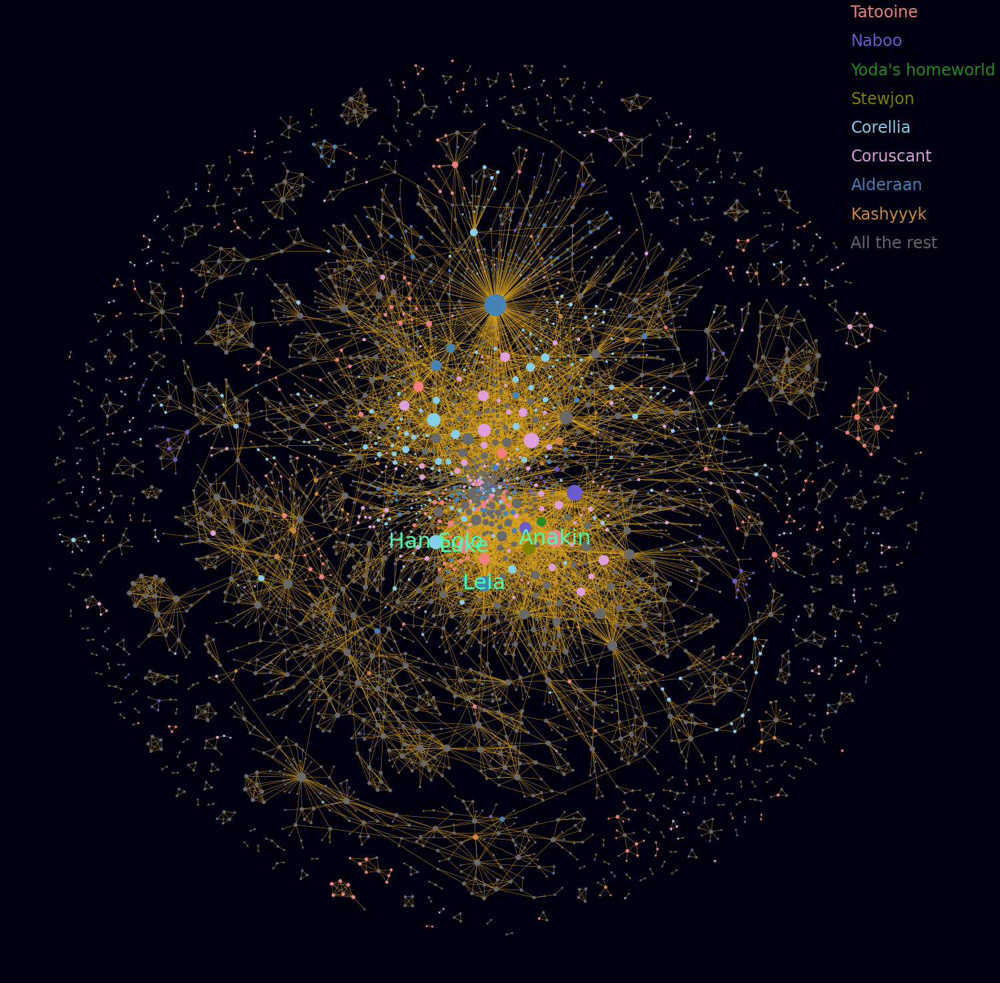

In [36]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*4 for degree in dict(G.degree()).values()]
node_colors = ['lightcoral' if temp == 'Tatooine' 
               else 'slateblue' if temp == 'Naboo' 
               else 'forestgreen' if temp == "Yoda's homeworld"
               else 'olive' if temp == 'Stewjon'
               else 'skyblue' if temp == 'Corellia'
               else 'plum' if temp == 'Coruscant'
               else 'steelblue' if temp == 'Alderaan'
               else 'peru' if temp == 'Kashyyyk'
               else 'dimgrey' for _, temp in nx.get_node_attributes(G, 'Homeworld').items()]

# Plotting
fig = plt.figure(figsize = (20, 20))
nx.draw(G, pos = positions, node_size = node_sizes, node_color = node_colors, edge_color='goldenrod', width = 0.5)
#nx.draw_networkx_labels(G, positions, {"Anakin Skywalker": "Anakin", "Leia Organa Solo": "Leia"}, 
#                        font_size=26, font_color='silver', font_weight='bold')
nx.draw_networkx_labels(G, positions, {"Anakin Skywalker": "Anakin", "Leia Skywalker Organa Solo": "Leia", 
                                       'Luke Skywalker': 'Luke', 'Han Solo':'Han Solo'}, 
                        font_size=32, font_color='#49F8B2')


plt.figtext(0.88, 1, 'Tatooine', size=24, color='lightcoral')
plt.figtext(0.88, 0.97, 'Naboo', size=24, color='slateblue')
plt.figtext(0.88, 0.94, "Yoda's homeworld", size=24, color='forestgreen')
plt.figtext(0.88, 0.91, 'Stewjon', size=24, color='olive')
plt.figtext(0.88, 0.88, 'Corellia', size=24, color='skyblue')
plt.figtext(0.88, 0.85, 'Coruscant', size=24, color='plum')
plt.figtext(0.88, 0.82, 'Alderaan', size=24, color='steelblue')
plt.figtext(0.88, 0.79, 'Kashyyyk', size=24, color='peru')
plt.figtext(0.88, 0.76, 'All the rest', size=24, color='dimgrey')
fig.set_facecolor("#00000F")
plt.savefig("Images/Networks/Big_Network.jpg", format="JPG")
plt.show()

#### Calculate the nodes with the highest degree centrality

In [37]:
d_centrality = sorted(nx.degree_centrality(G).items(), 
                      key=lambda t: t[1], 
                      reverse=True)

for i in d_centrality[:5]:
    print(i)

('Leia Organa Solo', 0.06392009987515605)
('Anakin Skywalker', 0.03895131086142322)
('Darth Sidious', 0.03295880149812734)
('Darth Caedus', 0.030711610486891385)
('Leia Skywalker Organa Solo', 0.030711610486891385)


#### Calculate number of communities and the value of modularity

In [38]:
partition = community_louvain.best_partition(G)
communities_louvain = [[node for node in partition if partition[node] == cat] for cat in set(partition.values())]
modularity_louvain = nx.algorithms.community.modularity(G,communities_louvain)

print(f'Number of Communities: {len(set(partition.values()))}')
print(f'Value of Modularity: {modularity_louvain}')

Number of Communities: 450
Value of Modularity: 0.8376572907691267


### Network based on the six episodes

As there are too many nodes and edges it is better to concentrate to more specific nodes. As a result it was decided to select only the characters that appeared in the first six episodes.

#### Create the dataset

In [39]:
small_data = char[(char['First Trilogy']==1)|(char['Second Trilogy']==1)].reset_index(drop=True)

small_data.loc[(small_data['First Trilogy']==1) & (small_data['Second Trilogy']==0), 'Trilogy'] = 'First three episodes'
small_data.loc[(small_data['First Trilogy']==0) & (small_data['Second Trilogy']==1), 'Trilogy'] = 'Last three episodes'
small_data.loc[(small_data['First Trilogy']==1) & (small_data['Second Trilogy']==1), 'Trilogy'] = 'Both'

#### Create the network

In [40]:
G = nx.DiGraph()
for filename in os.listdir(os.path.join(os.getcwd(), 'Data/Characters')):
    if filename[:-4].replace('_',' ') in small_data['Name'].values:
        with open(os.path.join(os.path.join(os.getcwd(), 'Data/Characters'), filename), 'r') as f:
            contents = f.read()
            query_json = ast.literal_eval(contents)
            page_id = list(query_json['query']['pages'].keys())[0]
            string = query_json['query']['pages'][page_id]['revisions'][0]['slots']['main']['*']

            # Add nodes
            name = filename[:-4].replace('_',' ')
            G.add_node(name)

            # Add homeworld attribute
            G.nodes[name]['Homeworld'] = small_data.loc[small_data['Name']==name, 'Homeworld'].values[0]

            # Add species attribute
            G.nodes[name]['Species'] = small_data.loc[small_data['Name']==name, 'Species'].values[0]

            # Add gender
            G.nodes[name]['Gender'] = small_data.loc[small_data['Name']==name, 'Gender'].values[0]
            
            # Add trilogy
            G.nodes[name]['Trilogy'] = small_data.loc[small_data['Name']==name, 'Trilogy'].values[0]
            
            # Add edges
            pattern = '\[\[(.*?)(?:\|.*?)?\]\]'
            temp = re.findall(pattern, string)
            temp = list(small_data[small_data['Name'].isin(temp)]['Name'].drop_duplicates())
            for i in temp:
                G.add_edge(name, i)

G.remove_nodes_from(list(nx.isolates(G)))

#### Number of nodes

In [41]:
print("Number of nodes in the network:", G.number_of_nodes())

Number of nodes in the network: 218


#### Number of edges

In [42]:
print("Number of links in the network:", G.number_of_edges())

Number of links in the network: 1128


#### In-degree network

In [43]:
connections_in = sorted(dict(G.in_degree()).items(), key = lambda x: x[1], reverse = True)
print('In Degree Connections:')
for character, in_degree in connections_in[:5]:
    node = G.nodes[character]
    print(character.ljust(30), 'In-degree:', in_degree)

In Degree Connections:
Anakin Skywalker               In-degree: 71
Luke Skywalker                 In-degree: 64
Han Solo                       In-degree: 51
Darth Sidious                  In-degree: 46
Leia Skywalker Organa Solo     In-degree: 45


#### Out-degree network

In [44]:
connections_out = sorted(dict(G.out_degree()).items(), key = lambda x: x[1], reverse = True)
print('\nOut Degree Connections:')
for character, out_degree in connections_out[:5]:
    node = G.nodes[character]
    print(character.ljust(30), 'Out-degree:', out_degree)


Out Degree Connections:
Anakin Skywalker               Out-degree: 50
Luke Skywalker                 Out-degree: 39
Leia Skywalker Organa Solo     Out-degree: 31
Obi-Wan Kenobi                 Out-degree: 29
R2-D2                          Out-degree: 28


#### Visualize the network

100%|██████████| 1000/1000 [00:01<00:00, 777.41it/s]


BarnesHut Approximation  took  0.34  seconds
Repulsion forces  took  0.79  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.02  seconds
AdjustSpeedAndApplyForces step  took  0.06  seconds


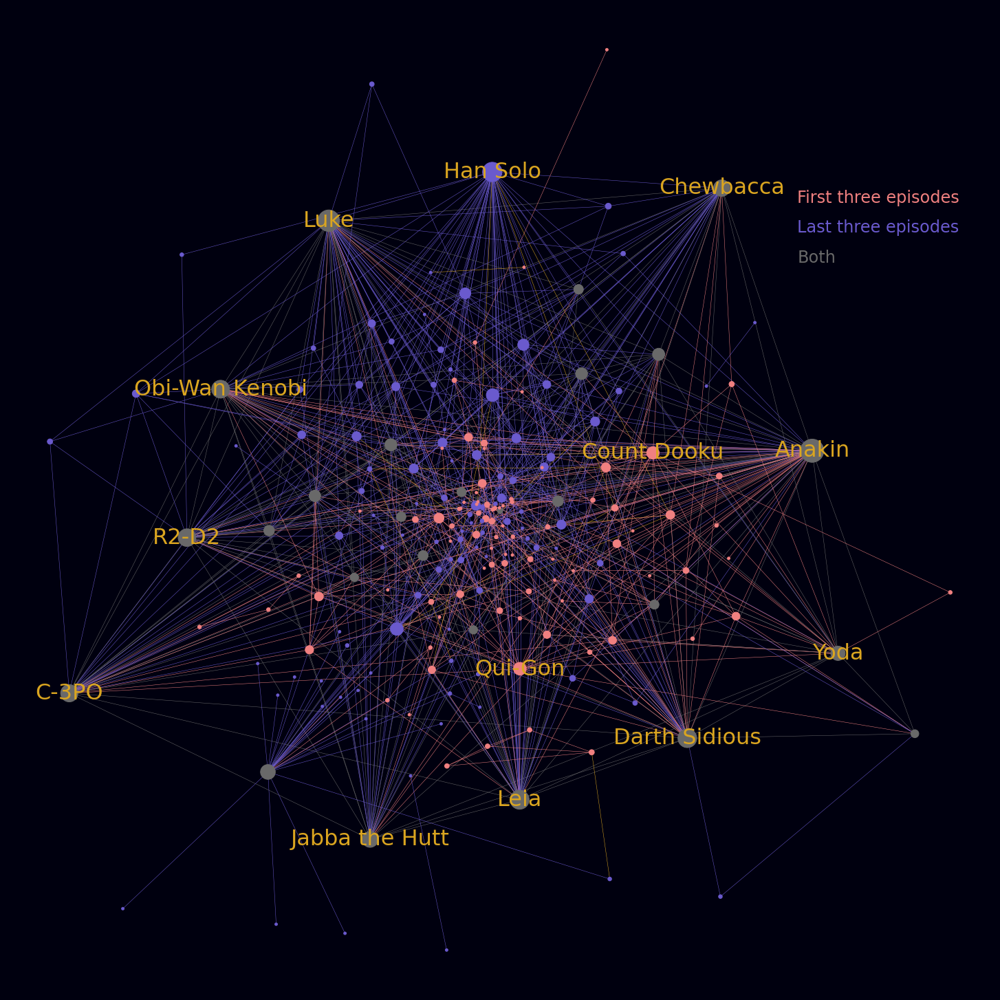

In [45]:
G = G.to_undirected()

# Function for colored edges
def edge_color(graph, node1, node2):
    role1, role2 = graph.nodes[node1]['Trilogy'], graph.nodes[node2]['Trilogy']
    if role1 == role2 == 'First three episodes':
        return 'lightcoral'
    elif role1 == role2 == 'Last three episodes':
        return 'slateblue'
    elif role1 == role2 == 'Both':
        return 'dimgrey'
    elif ((role1=='First three episodes') & (role2=='Both'))|((role2=='First three episodes') & (role1=='Both')):
        return 'lightcoral'
    elif ((role1=='Last three episodes') & (role2=='Both'))|((role2=='Last three episodes') & (role1=='Both')):
        return 'slateblue'
    else: 
        return 'goldenrod'

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_colors = [edge_color(G, node1, node2) for node1, node2 in G.edges]
node_colors = ['lightcoral' if temp == 'First three episodes' 
               else 'slateblue' if temp == 'Last three episodes' 
               else 'dimgrey' for _, temp in nx.get_node_attributes(G, 'Trilogy').items()]

# Plotting
fig = plt.figure(figsize = (20, 20))
nx.draw(G, pos=positions, node_size=node_sizes, node_color=node_colors, edge_color=edge_colors, width = 0.5)
nx.draw_networkx_labels(G, positions, {"Anakin Skywalker": "Anakin", "Leia Skywalker Organa Solo": "Leia", 
                                       'Luke Skywalker': 'Luke', 'Han Solo':'Han Solo', 'C-3PO':'C-3PO', 'R2-D2':'R2-D2',
                                       'Darth Sidious':'Darth Sidious','Obi-Wan Kenobi':'Obi-Wan Kenobi',
                                       'Chewbacca':'Chewbacca', 'Jabba Desilijic Tiure':'Jabba the Hutt',
                                       'Yoda':'Yoda', 'Dooku':'Count Dooku', 'Qui-Gon Jinn':'Qui-Gon'}, 
                        font_size=32, font_color='goldenrod')

plt.figtext(0.80, 0.8, 'First three episodes', size=24, color='lightcoral')
plt.figtext(0.80, 0.77, 'Last three episodes', size=24, color='slateblue')
plt.figtext(0.80, 0.74, 'Both', size=24, color='dimgrey')
fig.set_facecolor("#00000F")
plt.savefig("Images/Networks/Small_Network.png", format="PNG")
plt.show()

#### Calculate the nodes with the highest degree centrality

In [46]:
d_centrality = sorted(nx.degree_centrality(G).items(), 
                      key=lambda t: t[1], 
                      reverse=True)

for i in d_centrality[:5]:
    print(i)

('Anakin Skywalker', 0.35023041474654376)
('Luke Skywalker', 0.2995391705069124)
('Han Solo', 0.24423963133640553)
('Leia Skywalker Organa Solo', 0.2350230414746544)
('Darth Sidious', 0.2304147465437788)


#### Calculate number of communities and the value of modularity

In [47]:
partition = community_louvain.best_partition(G)
communities_louvain = [[node for node in partition if partition[node] == cat] for cat in set(partition.values())]
modularity_louvain = nx.algorithms.community.modularity(G,communities_louvain)

print(f'Number of Communities: {len(set(partition.values()))}')
print(f'Value of Modularity: {modularity_louvain}')

Number of Communities: 26
Value of Modularity: 0.3858523755628712


#### Distribution of communities

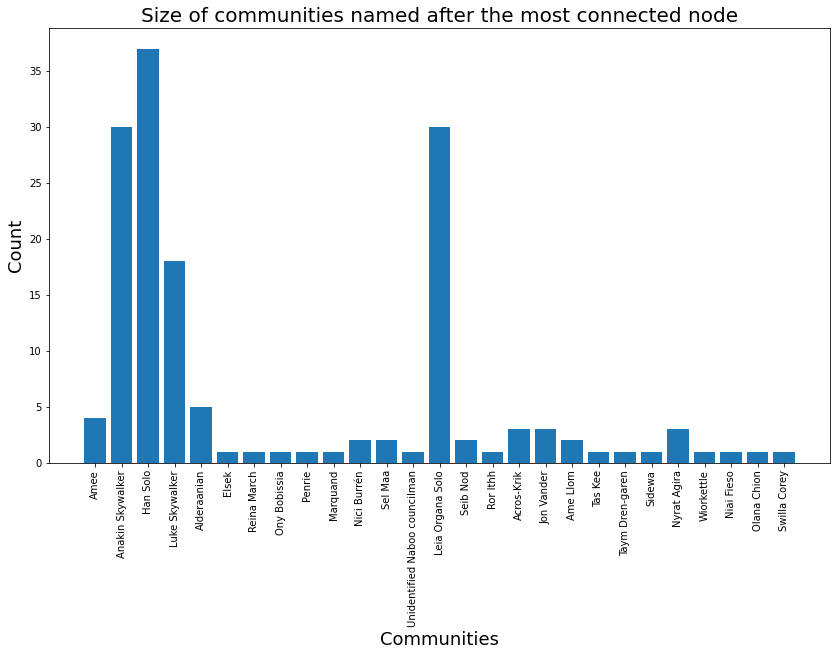

In [48]:
node_to_partition_id = community_louvain.best_partition(G)
partition_id_to_name = {partition_id: community_name(G, node_to_partition_id, partition_id) 
                        for partition_id in set(node_to_partition_id.values())}

community_size = {}
for key in partition_id_to_name.keys():
    community_size[partition_id_to_name[key][0][0]] = partition_id_to_name[key][0][1]
    
plt.figure(figsize=(14,8))
plt.bar(*zip(*community_size.items()))
plt.title('Size of communities named after the most connected node', fontsize=20)
plt.xlabel('Communities', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.xticks(rotation=90)
plt.savefig("Images/Plots/Dist_Community_Small_Network.png", format="PNG")
plt.show()

## Episode Scripts

#### Load data

In [49]:
data_scenes = pd.read_pickle('Data/Movies.pkl')
data_lines = pd.read_pickle('Data/Dialogues.pkl')

#### Count dialogues between characters

In [50]:
temp_data = data_scenes.reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-50-0a268db1d1fd>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [51]:
G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge]) 

#### Number of nodes

In [52]:
print("Number of nodes in the network:", G.number_of_nodes())

Number of nodes in the network: 223


#### Number of edges

In [53]:
print("Number of links in the network:", G.number_of_edges())

Number of links in the network: 1404


#### Degree network

In [54]:
connections_in = sorted(dict(G.in_degree()).items(), key = lambda x: x[1], reverse = True)
print('In Degree Connections:')
for character, in_degree in connections_in[:10]:
    node = G.nodes[character]
    print(character.ljust(30), 'Degree:', in_degree)

In Degree Connections:
ANAKIN                         Degree: 68
OBIWAN                         Degree: 52
THREEPIO                       Degree: 51
LUKE                           Degree: 48
PADME                          Degree: 41
QUIGON                         Degree: 35
LEIA                           Degree: 33
VADER                          Degree: 32
HAN                            Degree: 32
JAR JAR                        Degree: 27


#### Visualize the network

100%|██████████| 1000/1000 [00:01<00:00, 727.19it/s]


BarnesHut Approximation  took  0.36  seconds
Repulsion forces  took  0.84  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.02  seconds
AdjustSpeedAndApplyForces step  took  0.07  seconds


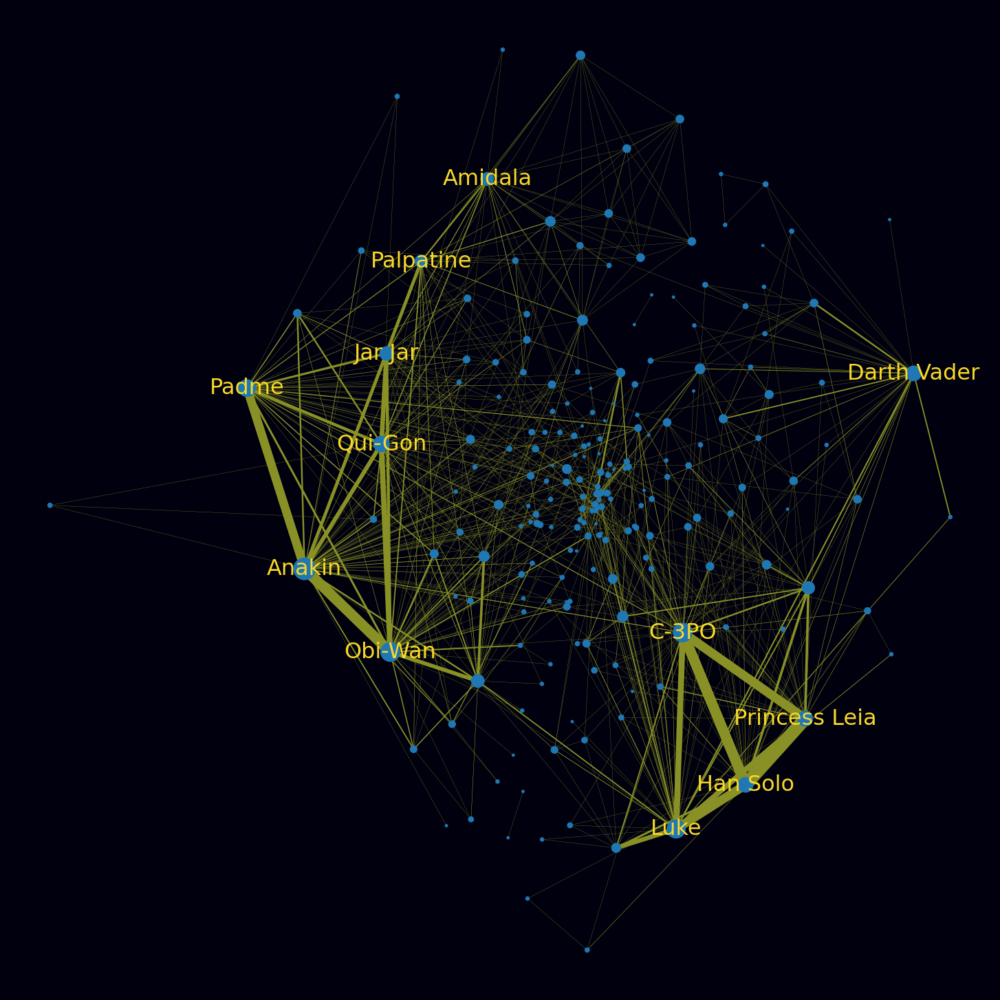

In [55]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

# Plotting
fig = plt.figure(figsize = (20, 20))
nx.draw(G, pos=positions, node_size=node_sizes, edge_color='#899126', width = edge_sizes)
nx.draw_networkx_labels(G, positions, {"ANAKIN": "Anakin", "QUIGON": "Qui-Gon", 'AMIDALA': 'Amidala',
                                       'OBIWAN':'Obi-Wan', 'PALPATINE':'Palpatine', 'PADME':'Padme',
                                       'JAR JAR':'Jar Jar', 'LUKE':'Luke', 'THREEPIO':'C-3PO', 
                                       'LEIA':'Princess Leia', 'VADER':'Darth Vader', 'HAN':'Han Solo'}, 
                        font_size=32, font_color='#F8D827')

fig.set_facecolor("#00000F")
plt.savefig("Images/Networks/All_Episodes.png", format="PNG")
plt.show()

#### Calculate the nodes with the highest degree centrality

In [56]:
d_centrality = sorted(nx.degree_centrality(G).items(), 
                      key=lambda t: t[1], 
                      reverse=True)

for i in d_centrality[:5]:
    print(i)

('ANAKIN', 0.3063063063063063)
('OBIWAN', 0.23423423423423423)
('THREEPIO', 0.22972972972972971)
('LUKE', 0.21621621621621623)
('PADME', 0.18468468468468469)


#### Calculate number of communities and the value of modularity

In [57]:
partition = community_louvain.best_partition(G)
communities_louvain = [[node for node in partition if partition[node] == cat] for cat in set(partition.values())]
modularity_louvain = nx.algorithms.community.modularity(G,communities_louvain)

print(f'Number of Communities: {len(set(partition.values()))}')
print(f'Value of Modularity: {modularity_louvain}')

Number of Communities: 21
Value of Modularity: 0.5241700147377439


#### Sized communities

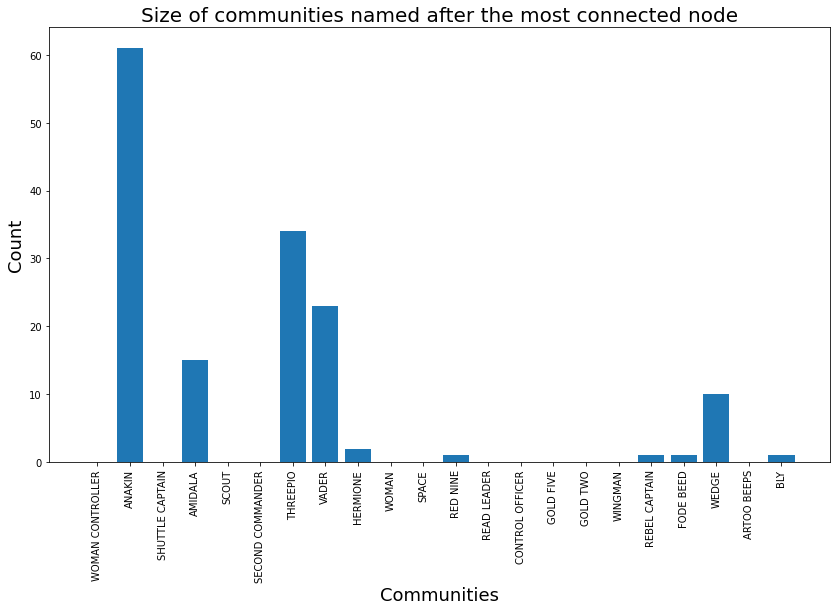

In [58]:
node_to_partition_id = community_louvain.best_partition(G)
partition_id_to_name = {partition_id: community_name(G, node_to_partition_id, partition_id) 
                        for partition_id in set(node_to_partition_id.values())}

community_size = {}
for key in partition_id_to_name.keys():
    community_size[partition_id_to_name[key][0][0]] = partition_id_to_name[key][0][1]
    
plt.figure(figsize=(14,8))
plt.bar(*zip(*community_size.items()))
plt.title('Size of communities named after the most connected node', fontsize=20)
plt.xlabel('Communities', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.xticks(rotation=90)
#plt.savefig("Images/Plots/Dist_Community_Small_Network.png", format="PNG")
plt.show()

### First Trilogy

#### Count dialogues between characters

In [59]:
temp_data = data_scenes[(data_scenes['Movie']=='Episode I') | (data_scenes['Movie']=='Episode II') | (data_scenes['Movie']=='Episode III')].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-59-6bd15483fe2f>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [60]:
G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge]) 

#### Number of nodes

In [61]:
print("Number of nodes in the network:", G.number_of_nodes())

Number of nodes in the network: 115


#### Number of edges

In [62]:
print("Number of links in the network:", G.number_of_edges())

Number of links in the network: 780


#### Degree network

In [63]:
connections_in = sorted(dict(G.in_degree()).items(), key = lambda x: x[1], reverse = True)
print('In Degree Connections:')
for character, in_degree in connections_in[:10]:
    node = G.nodes[character]
    print(character.ljust(30), 'In-degree:', in_degree)

In Degree Connections:
ANAKIN                         In-degree: 65
OBIWAN                         In-degree: 52
PADME                          In-degree: 41
QUIGON                         In-degree: 35
JAR JAR                        In-degree: 27
AMIDALA                        In-degree: 24
PALPATINE                      In-degree: 23
YODA                           In-degree: 22
MACE WINDU                     In-degree: 16
BAIL ORGANA                    In-degree: 15


#### Visualize the network

100%|██████████| 1000/1000 [00:00<00:00, 1901.30it/s]


BarnesHut Approximation  took  0.11  seconds
Repulsion forces  took  0.32  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.01  seconds
AdjustSpeedAndApplyForces step  took  0.04  seconds


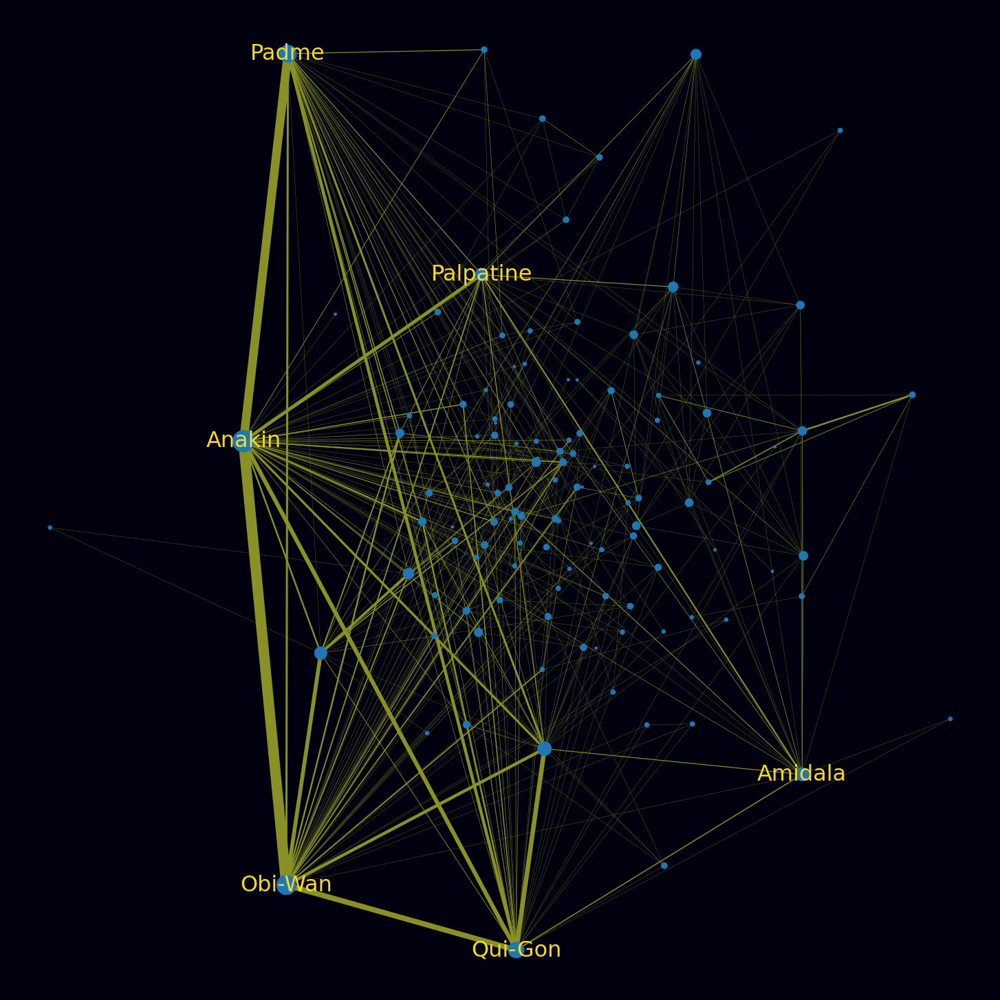

In [64]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

# Plotting
fig = plt.figure(figsize = (20, 20))
nx.draw(G, pos=positions, node_size=node_sizes, edge_color='#899126', width = edge_sizes)
nx.draw_networkx_labels(G, positions, {"ANAKIN": "Anakin", "QUIGON": "Qui-Gon", 'AMIDALA': 'Amidala',
                                       'OBIWAN':'Obi-Wan', 'PALPATINE':'Palpatine', 'PADME':'Padme',}, 
                        font_size=32, font_color='#F8D827')

fig.set_facecolor("#00000F")
plt.savefig("Images/Networks/First_Trilogy.png", format="PNG")
plt.show()

#### Calculate the nodes with the highest degree centrality

In [65]:
d_centrality = sorted(nx.degree_centrality(G).items(), 
                      key=lambda t: t[1], 
                      reverse=True)

for i in d_centrality[:5]:
    print(i)

('ANAKIN', 0.5701754385964912)
('OBIWAN', 0.45614035087719296)
('PADME', 0.35964912280701755)
('QUIGON', 0.3070175438596491)
('JAR JAR', 0.23684210526315788)


#### Calculate number of communities and the value of modularity

In [66]:
partition = community_louvain.best_partition(G)
communities_louvain = [[node for node in partition if partition[node] == cat] for cat in set(partition.values())]
modularity_louvain = nx.algorithms.community.modularity(G,communities_louvain)

print(f'Number of Communities: {len(set(partition.values()))}')
print(f'Value of Modularity: {modularity_louvain}')

Number of Communities: 10
Value of Modularity: 0.31880521459364186


### Second Trilogy

#### Count dialogues between characters

In [67]:
temp_data = data_scenes[(data_scenes['Movie']=='Episode IV') | (data_scenes['Movie']=='Episode V') | (data_scenes['Movie']=='Episode VI')].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-67-50adc2ee4891>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


### Episode I

#### Load data

In [68]:
data_scenes = pd.read_pickle('Data/Movies.pkl')
data_lines = pd.read_pickle('Data/Dialogues.pkl')

#### Count dialogues between characters

In [69]:
temp_data = data_scenes[data_scenes['Movie']=='Episode I'].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-69-b9111778f07a>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [70]:
G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge]) 

#### Number of nodes

In [71]:
print("Number of nodes in the network:", G.number_of_nodes())

Number of nodes in the network: 60


#### Number of edges

In [72]:
print("Number of links in the network:", G.number_of_edges())

Number of links in the network: 422


#### Degree network

In [73]:
connections_in = sorted(dict(G.in_degree()).items(), key = lambda x: x[1], reverse = True)
print('In Degree Connections:')
for character, in_degree in connections_in[:10]:
    node = G.nodes[character]
    print(character.ljust(30),  in_degree)

In Degree Connections:
QUIGON                         34
ANAKIN                         31
AMIDALA                        22
JAR JAR                        22
PADME                          22
OBIWAN                         17
PALPATINE                      12
NUTE                           11
VALORUM                        11
KITSTER                        10


#### Visualize the network

100%|██████████| 1000/1000 [00:00<00:00, 5012.65it/s]


BarnesHut Approximation  took  0.05  seconds
Repulsion forces  took  0.10  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.02  seconds


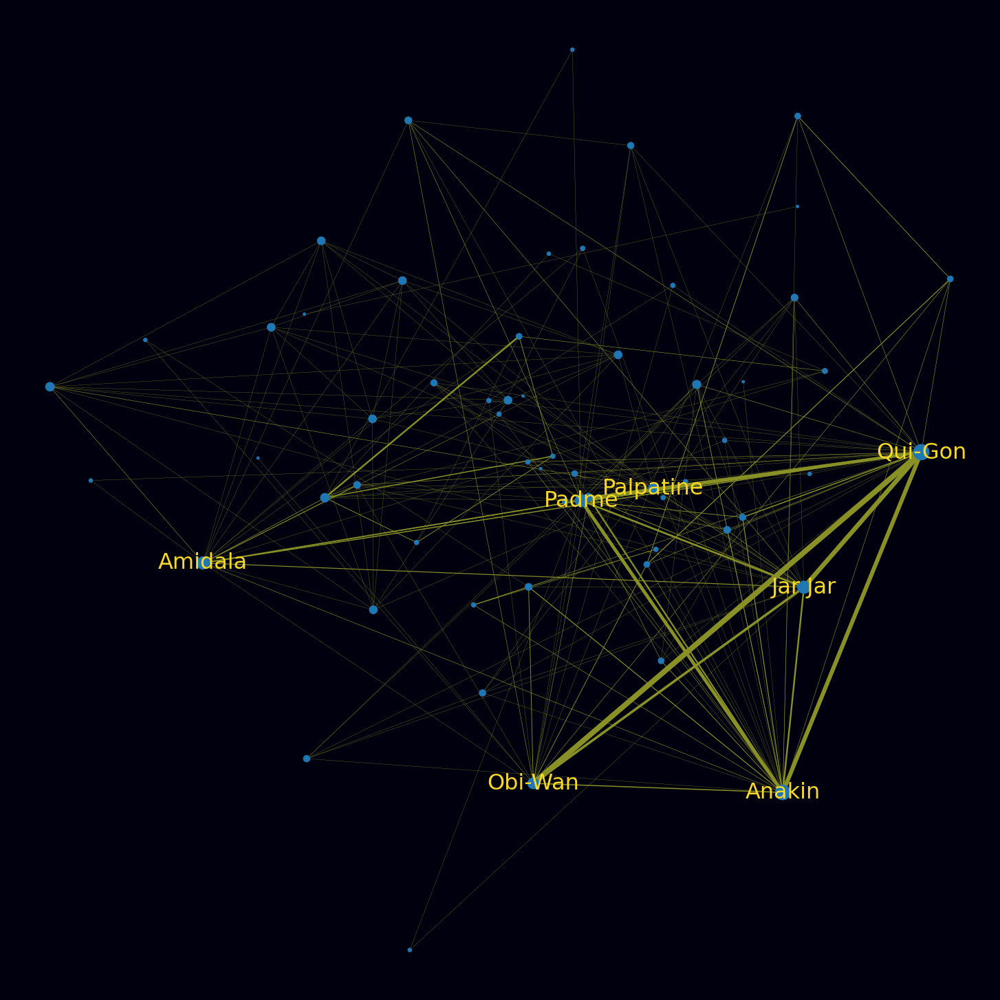

In [74]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

# Plotting
fig = plt.figure(figsize = (20, 20))
nx.draw(G, pos=positions, node_size=node_sizes, edge_color='#899126', width = edge_sizes)
nx.draw_networkx_labels(G, positions, {"ANAKIN": "Anakin", "QUIGON": "Qui-Gon", 'AMIDALA': 'Amidala',
                                       'OBIWAN':'Obi-Wan', 'PALPATINE':'Palpatine', 'PADME':'Padme',
                                       'JAR JAR':'Jar Jar'}, 
                        font_size=32, font_color='#F8D827')

fig.set_facecolor("#00000F")
plt.savefig("Images/Networks/Episode_I.png", format="PNG")
plt.show()

#### Calculate the nodes with the highest degree centrality

In [75]:
d_centrality = sorted(nx.degree_centrality(G).items(), 
                      key=lambda t: t[1], 
                      reverse=True)

for i in d_centrality[:10]:
    print(i)

('QUIGON', 0.576271186440678)
('ANAKIN', 0.5254237288135594)
('AMIDALA', 0.3728813559322034)
('JAR JAR', 0.3728813559322034)
('PADME', 0.3728813559322034)
('OBIWAN', 0.288135593220339)
('PALPATINE', 0.2033898305084746)
('NUTE', 0.1864406779661017)
('VALORUM', 0.1864406779661017)
('KITSTER', 0.1694915254237288)


#### Calculate number of communities and the value of modularity

In [76]:
partition = community_louvain.best_partition(G)
communities_louvain = [[node for node in partition if partition[node] == cat] for cat in set(partition.values())]
modularity_louvain = nx.algorithms.community.modularity(G,communities_louvain)

print(f'Number of Communities: {len(set(partition.values()))}')
print(f'Value of Modularity: {modularity_louvain}')

Number of Communities: 6
Value of Modularity: 0.35696499521331737


#### Distribution of communities

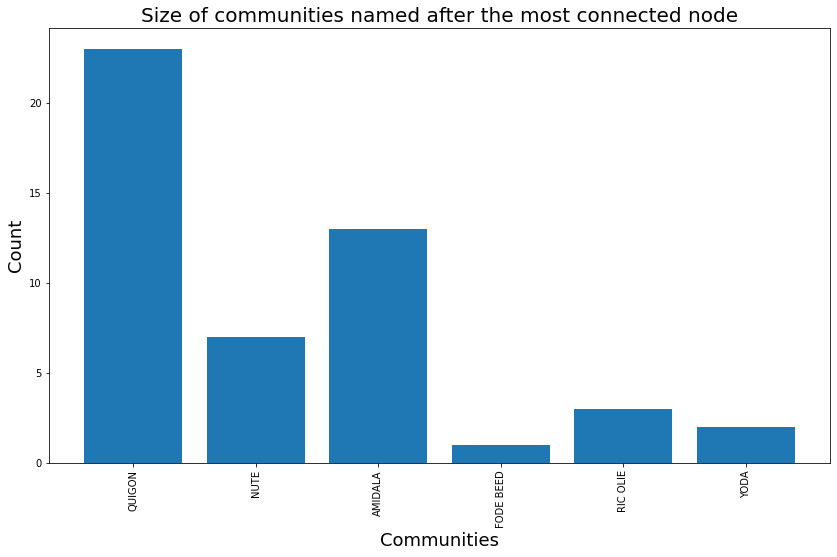

In [77]:
node_to_partition_id = community_louvain.best_partition(G)
partition_id_to_name = {partition_id: community_name(G, node_to_partition_id, partition_id) 
                        for partition_id in set(node_to_partition_id.values())}

community_size = {}
for key in partition_id_to_name.keys():
    community_size[partition_id_to_name[key][0][0]] = partition_id_to_name[key][0][1]
    
plt.figure(figsize=(14,8))
plt.bar(*zip(*community_size.items()))
plt.title('Size of communities named after the most connected node', fontsize=20)
plt.xlabel('Communities', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.xticks(rotation=90)
plt.savefig("Images/Plots/Dist_Community_Ep_I.png", format="PNG")
plt.show()

### Episode II

#### Load data

In [78]:
data_scenes = pd.read_pickle('Data/Movies.pkl')
data_lines = pd.read_pickle('Data/Dialogues.pkl')

#### Count dialogues between characters

In [79]:
temp_data = data_scenes[data_scenes['Movie']=='Episode II'].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-79-142af85c9983>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [80]:
G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge]) 

#### Number of nodes

In [81]:
print("Number of nodes in the network:", G.number_of_nodes())

Number of nodes in the network: 59


#### Number of edges

In [82]:
print("Number of links in the network:", G.number_of_edges())

Number of links in the network: 330


#### Degree network

In [83]:
connections_in = sorted(dict(G.in_degree()).items(), key = lambda x: x[1], reverse = True)
print('In Degree Connections:')
for character, in_degree in connections_in[:10]:
    node = G.nodes[character]
    print(character.ljust(30), in_degree)

In Degree Connections:
OBIWAN                         34
ANAKIN                         31
PADME                          18
YODA                           17
MACE WINDU                     14
COUNT DOOKU                    11
PALPATINE                      10
JAR JAR                        9
MAS AMEDDA                     8
BAIL ORGANA                    8


#### Visualize the network

100%|██████████| 1000/1000 [00:00<00:00, 5699.32it/s]

BarnesHut Approximation  took  0.05  seconds
Repulsion forces  took  0.09  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.02  seconds


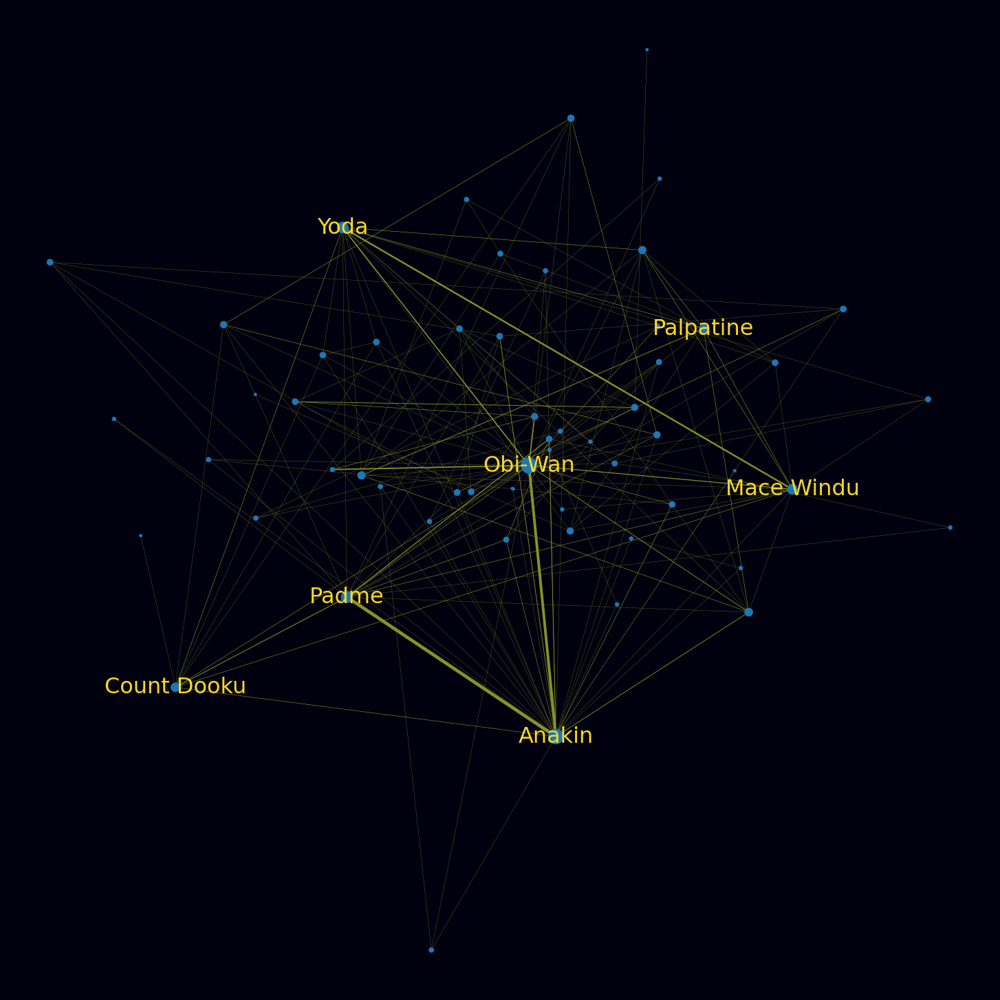

In [84]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

# Plotting
fig = plt.figure(figsize = (20, 20))
nx.draw(G, pos=positions, node_size=node_sizes, edge_color='#899126', width = edge_sizes)
nx.draw_networkx_labels(G, positions, {"ANAKIN": "Anakin", 'PADME': 'Padme', 'YODA':'Yoda', 'MACE WINDU':'Mace Windu',
                                       'OBIWAN':'Obi-Wan', 'PALPATINE':'Palpatine', 'COUNT DOOKU':'Count Dooku'}, 
                        font_size=32, font_color='#F8D827')

fig.set_facecolor("#00000F")
plt.savefig("Images/Networks/Episode_II.png", format="PNG")
plt.show()

#### Calculate the nodes with the highest degree centrality

In [85]:
d_centrality = sorted(nx.degree_centrality(G).items(), 
                      key=lambda t: t[1], 
                      reverse=True)

for i in d_centrality[:10]:
    print(i)

('OBIWAN', 0.5862068965517241)
('ANAKIN', 0.5344827586206896)
('PADME', 0.3103448275862069)
('YODA', 0.29310344827586204)
('MACE WINDU', 0.24137931034482757)
('COUNT DOOKU', 0.1896551724137931)
('PALPATINE', 0.1724137931034483)
('JAR JAR', 0.15517241379310345)
('MAS AMEDDA', 0.13793103448275862)
('BAIL ORGANA', 0.13793103448275862)


#### Calculate number of communities and the value of modularity

In [86]:
partition = community_louvain.best_partition(G)
communities_louvain = [[node for node in partition if partition[node] == cat] for cat in set(partition.values())]
modularity_louvain = nx.algorithms.community.modularity(G,communities_louvain)

print(f'Number of Communities: {len(set(partition.values()))}')
print(f'Value of Modularity: {modularity_louvain}')

Number of Communities: 5
Value of Modularity: 0.41841888427734375


#### Distribution of communities

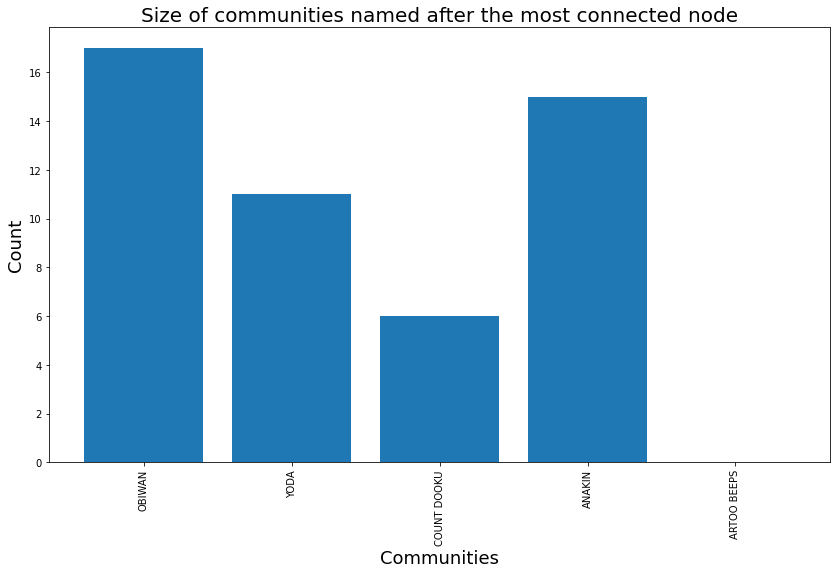

In [87]:
node_to_partition_id = community_louvain.best_partition(G)
partition_id_to_name = {partition_id: community_name(G, node_to_partition_id, partition_id) 
                        for partition_id in set(node_to_partition_id.values())}

community_size = {}
for key in partition_id_to_name.keys():
    community_size[partition_id_to_name[key][0][0]] = partition_id_to_name[key][0][1]
    
plt.figure(figsize=(14,8))
plt.bar(*zip(*community_size.items()))
plt.title('Size of communities named after the most connected node', fontsize=20)
plt.xlabel('Communities', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.xticks(rotation=90)
plt.savefig("Images/Plots/Dist_Community_Ep_II.png", format="PNG")
plt.show()

### Episode III

#### Load data

In [88]:
data_scenes = pd.read_pickle('Data/Movies.pkl')
data_lines = pd.read_pickle('Data/Dialogues.pkl')

#### Count dialogues between characters

In [89]:
temp_data = data_scenes[data_scenes['Movie']=='Episode III'].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-89-8bccb6f29194>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [90]:
G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge]) 

#### Number of nodes

In [91]:
print("Number of nodes in the network:", G.number_of_nodes())

Number of nodes in the network: 21


#### Number of edges

In [92]:
print("Number of links in the network:", G.number_of_edges())

Number of links in the network: 92


#### Degree network

In [93]:
connections_in = sorted(dict(G.in_degree()).items(), key = lambda x: x[1], reverse = True)
print('In Degree Connections:')
for character, in_degree in connections_in[:10]:
    node = G.nodes[character]
    print(character.ljust(30), in_degree)

In Degree Connections:
ANAKIN                         14
OBIWAN                         12
BAIL                           10
PADME                          8
YODA                           7
PALPATINE                      6
MACE                           5
PILOT                          4
CAPTAIN                        4
THREEPIO                       3


#### Visualize the network

100%|██████████| 1000/1000 [00:00<00:00, 15902.15it/s]

BarnesHut Approximation  took  0.02  seconds
Repulsion forces  took  0.02  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.01  seconds


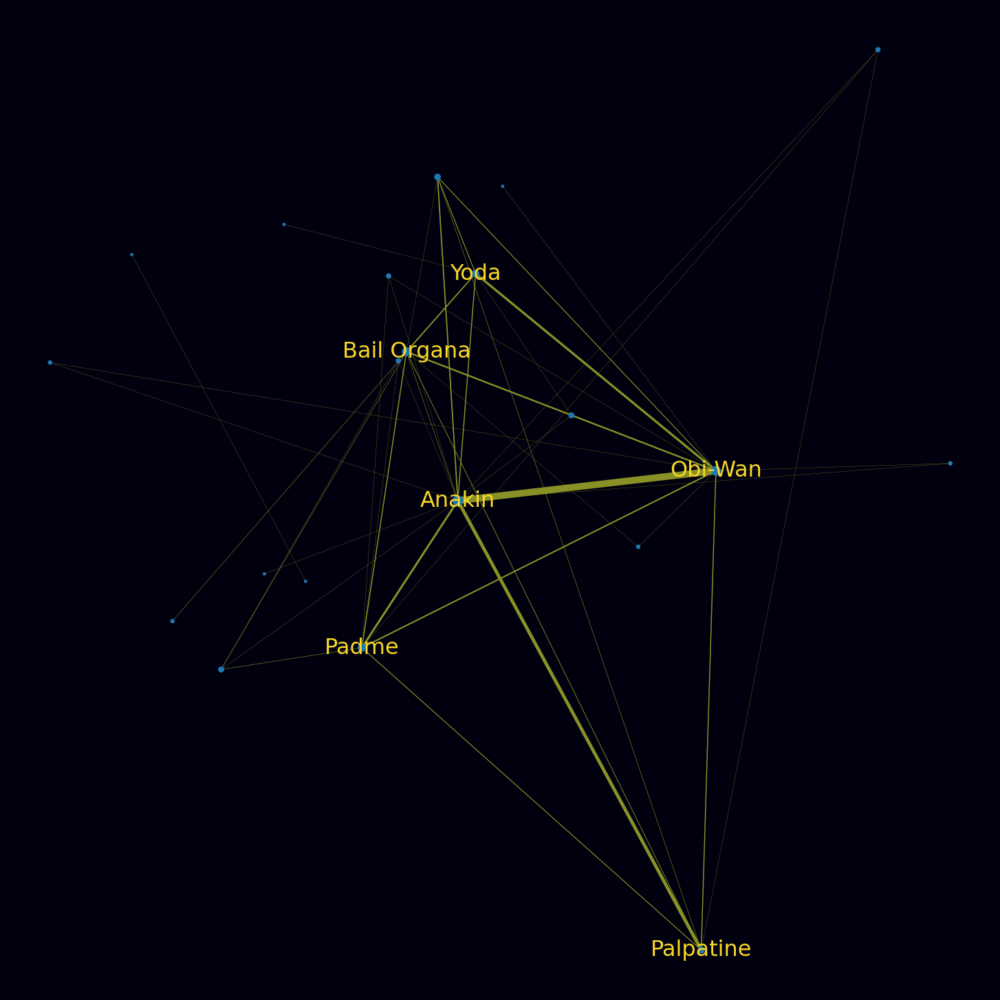

In [94]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

# Plotting
fig = plt.figure(figsize = (20, 20))
nx.draw(G, pos=positions, node_size=node_sizes, edge_color='#899126', width = edge_sizes)
nx.draw_networkx_labels(G, positions, {"ANAKIN": "Anakin", 'PADME': 'Padme', 'BAIL':'Bail Organa',
                                       'OBIWAN':'Obi-Wan', 'PALPATINE':'Palpatine', 'YODA':'Yoda'}, 
                        font_size=32, font_color='#F8D827')

fig.set_facecolor("#00000F")
plt.savefig("Images/Networks/Episode_III.png", format="PNG")
plt.show()

#### Calculate the nodes with the highest degree centrality

In [95]:
d_centrality = sorted(nx.degree_centrality(G).items(), 
                      key=lambda t: t[1], 
                      reverse=True)

for i in d_centrality[:10]:
    print(i)

('ANAKIN', 0.7000000000000001)
('OBIWAN', 0.6000000000000001)
('BAIL', 0.5)
('PADME', 0.4)
('YODA', 0.35000000000000003)
('PALPATINE', 0.30000000000000004)
('MACE', 0.25)
('PILOT', 0.2)
('CAPTAIN', 0.2)
('THREEPIO', 0.15000000000000002)


#### Calculate number of communities and the value of modularity

In [96]:
partition = community_louvain.best_partition(G)
communities_louvain = [[node for node in partition if partition[node] == cat] for cat in set(partition.values())]
modularity_louvain = nx.algorithms.community.modularity(G,communities_louvain)

print(f'Number of Communities: {len(set(partition.values()))}')
print(f'Value of Modularity: {modularity_louvain}')

Number of Communities: 4
Value of Modularity: 0.08252098310060603


#### Distribution of communities

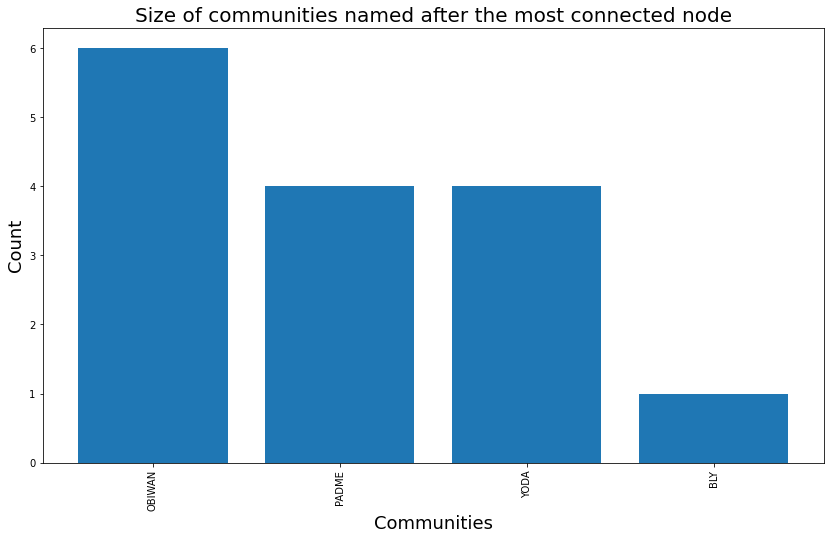

In [97]:
node_to_partition_id = community_louvain.best_partition(G)
partition_id_to_name = {partition_id: community_name(G, node_to_partition_id, partition_id) 
                        for partition_id in set(node_to_partition_id.values())}

community_size = {}
for key in partition_id_to_name.keys():
    community_size[partition_id_to_name[key][0][0]] = partition_id_to_name[key][0][1]
    
plt.figure(figsize=(14,8))
plt.bar(*zip(*community_size.items()))
plt.title('Size of communities named after the most connected node', fontsize=20)
plt.xlabel('Communities', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.xticks(rotation=90)
plt.savefig("Images/Plots/Dist_Community_Ep_III.png", format="PNG")
plt.show()

### Episode IV

#### Load data

In [98]:
data_scenes = pd.read_pickle('Data/Movies.pkl')
data_lines = pd.read_pickle('Data/Dialogues.pkl')

#### Count dialogues between characters

In [99]:
temp_data = data_scenes[data_scenes['Movie']=='Episode IV'].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-99-ed89f51252f9>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [100]:
G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge]) 

#### Number of nodes

In [101]:
print("Number of nodes in the network:", G.number_of_nodes())

Number of nodes in the network: 61


#### Number of edges

In [102]:
print("Number of links in the network:", G.number_of_edges())

Number of links in the network: 284


#### Degree network

In [103]:
connections_in = sorted(dict(G.in_degree()).items(), key = lambda x: x[1], reverse = True)
print('In Degree Connections:')
for character, in_degree in connections_in[:10]:
    node = G.nodes[character]
    print(character.ljust(30), in_degree)

In Degree Connections:
LUKE                           31
THREEPIO                       20
LEIA                           16
VADER                          15
HAN                            13
BIGGS                          12
BEN                            11
TARKIN                         10
TROOPER                        9
FIRST TROOPER                  8


#### Visualize the network

100%|██████████| 1000/1000 [00:00<00:00, 4642.92it/s]


BarnesHut Approximation  took  0.05  seconds
Repulsion forces  took  0.11  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.02  seconds


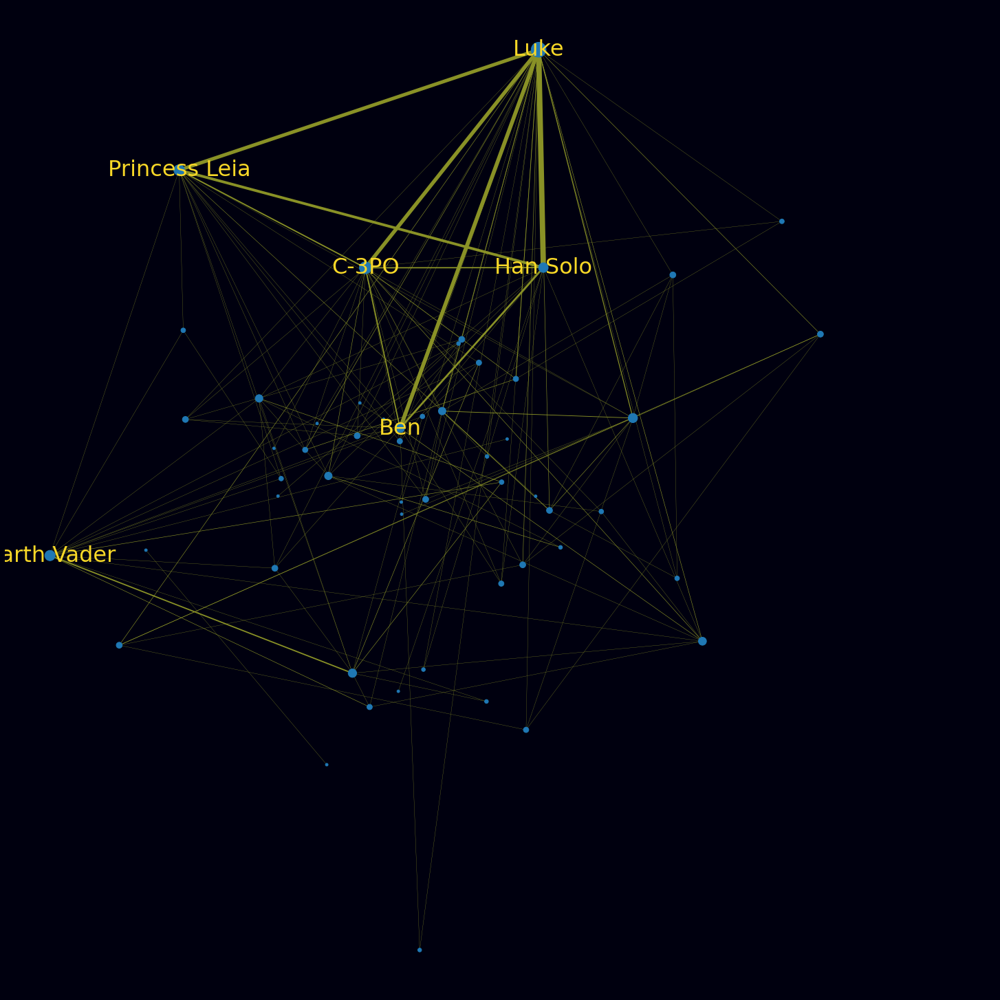

In [104]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

# Plotting
fig = plt.figure(figsize = (20, 20))
nx.draw(G, pos=positions, node_size=node_sizes, edge_color='#899126', width = edge_sizes)
nx.draw_networkx_labels(G, positions, {'LUKE':'Luke', 'THREEPIO':'C-3PO', 'LEIA':'Princess Leia',
                                       'VADER':'Darth Vader', 'HAN':'Han Solo', 'BEN': 'Ben'}, 
                        font_size=32, font_color='#F8D827')

fig.set_facecolor("#00000F")
plt.savefig("Images/Networks/Episode_IV.png", format="PNG")
plt.show()

#### Calculate the nodes with the highest degree centrality

In [105]:
d_centrality = sorted(nx.degree_centrality(G).items(), 
                      key=lambda t: t[1], 
                      reverse=True)

for i in d_centrality[:10]:
    print(i)

('LUKE', 0.5166666666666666)
('THREEPIO', 0.3333333333333333)
('LEIA', 0.26666666666666666)
('VADER', 0.25)
('HAN', 0.21666666666666667)
('BIGGS', 0.2)
('BEN', 0.18333333333333332)
('TARKIN', 0.16666666666666666)
('TROOPER', 0.15)
('FIRST TROOPER', 0.13333333333333333)


#### Calculate number of communities and the value of modularity

In [106]:
partition = community_louvain.best_partition(G)
communities_louvain = [[node for node in partition if partition[node] == cat] for cat in set(partition.values())]
modularity_louvain = nx.algorithms.community.modularity(G,communities_louvain)

print(f'Number of Communities: {len(set(partition.values()))}')
print(f'Value of Modularity: {modularity_louvain}')

Number of Communities: 13
Value of Modularity: 0.34172413793103457


#### Distribution of communities

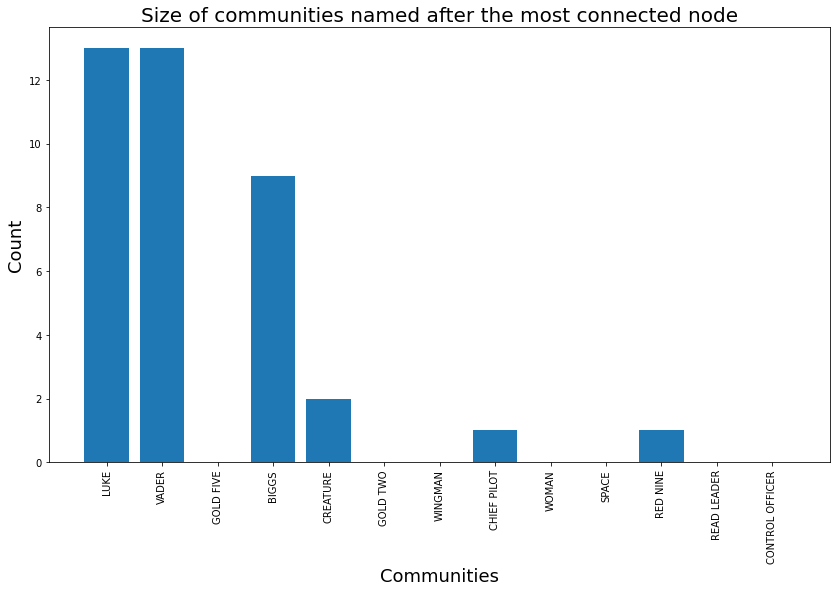

In [107]:
node_to_partition_id = community_louvain.best_partition(G)
partition_id_to_name = {partition_id: community_name(G, node_to_partition_id, partition_id) 
                        for partition_id in set(node_to_partition_id.values())}

community_size = {}
for key in partition_id_to_name.keys():
    community_size[partition_id_to_name[key][0][0]] = partition_id_to_name[key][0][1]
    
plt.figure(figsize=(14,8))
plt.bar(*zip(*community_size.items()))
plt.title('Size of communities named after the most connected node', fontsize=20)
plt.xlabel('Communities', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.xticks(rotation=90)
plt.savefig("Images/Plots/Dist_Community_Ep_IV.png", format="PNG")
plt.show()

### Episode V

#### Load data

In [108]:
data_scenes = pd.read_pickle('Data/Movies.pkl')
data_lines = pd.read_pickle('Data/Dialogues.pkl')

#### Count dialogues between characters

In [109]:
temp_data = data_scenes[data_scenes['Movie']=='Episode V'].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-109-5031c6ed11ea>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [110]:
G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge]) 

#### Number of nodes

In [111]:
print("Number of nodes in the network:", G.number_of_nodes())

Number of nodes in the network: 48


#### Number of edges

In [112]:
print("Number of links in the network:", G.number_of_edges())

Number of links in the network: 206


#### Degree network

In [113]:
connections_in = sorted(dict(G.in_degree()).items(), key = lambda x: x[1], reverse = True)
print('In Degree Connections:')
for character, in_degree in connections_in[:10]:
    node = G.nodes[character]
    print(character.ljust(30), in_degree)

In Degree Connections:
HAN                            17
THREEPIO                       16
LEIA                           15
VADER                          15
LUKE                           14
LANDO                          9
BOBA FETT                      9
PIETT                          7
ANNOUNCER                      6
IMPERIAL OFFICER               6


#### Visualize the network

100%|██████████| 1000/1000 [00:00<00:00, 6785.26it/s]

BarnesHut Approximation  took  0.04  seconds
Repulsion forces  took  0.07  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.01  seconds


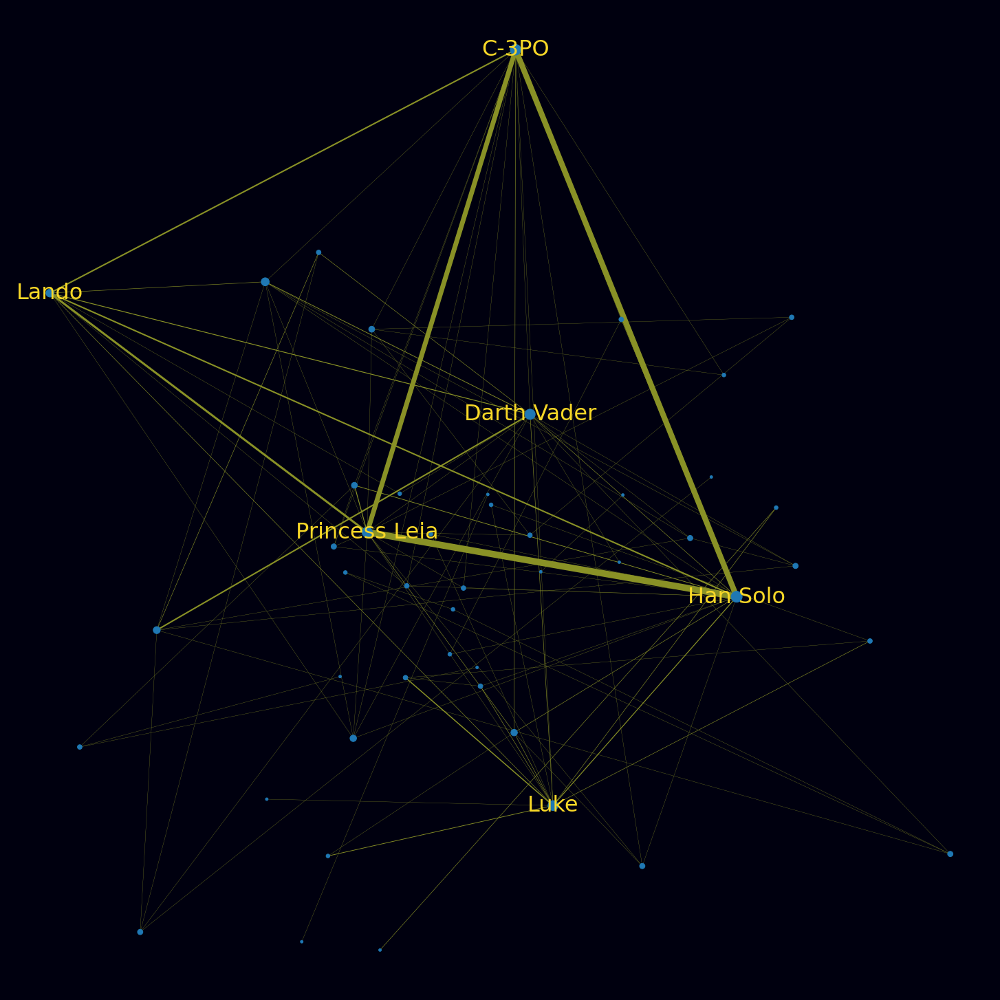

In [114]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

# Plotting
fig = plt.figure(figsize = (20, 20))
nx.draw(G, pos=positions, node_size=node_sizes, edge_color='#899126', width = edge_sizes)
nx.draw_networkx_labels(G, positions, {'HAN':'Han Solo', 'THREEPIO':'C-3PO', 'LUKE':'Luke',
                                       'VADER':'Darth Vader', 'LEIA':'Princess Leia', 'LANDO':'Lando'}, 
                        font_size=32, font_color='#F8D827')

fig.set_facecolor("#00000F")
plt.savefig("Images/Networks/Episode_V.png", format="PNG")
plt.show()

#### Calculate the nodes with the highest degree centrality

In [115]:
d_centrality = sorted(nx.degree_centrality(G).items(), 
                      key=lambda t: t[1], 
                      reverse=True)

for i in d_centrality[:10]:
    print(i)

('HAN', 0.36170212765957444)
('THREEPIO', 0.3404255319148936)
('LEIA', 0.3191489361702128)
('VADER', 0.3191489361702128)
('LUKE', 0.2978723404255319)
('LANDO', 0.19148936170212766)
('BOBA FETT', 0.19148936170212766)
('PIETT', 0.14893617021276595)
('ANNOUNCER', 0.1276595744680851)
('IMPERIAL OFFICER', 0.1276595744680851)


#### Calculate number of communities and the value of modularity

In [116]:
partition = community_louvain.best_partition(G)
communities_louvain = [[node for node in partition if partition[node] == cat] for cat in set(partition.values())]
modularity_louvain = nx.algorithms.community.modularity(G,communities_louvain)

print(f'Number of Communities: {len(set(partition.values()))}')
print(f'Value of Modularity: {modularity_louvain}')

Number of Communities: 8
Value of Modularity: 0.37389286863452387


#### Distribution of communities

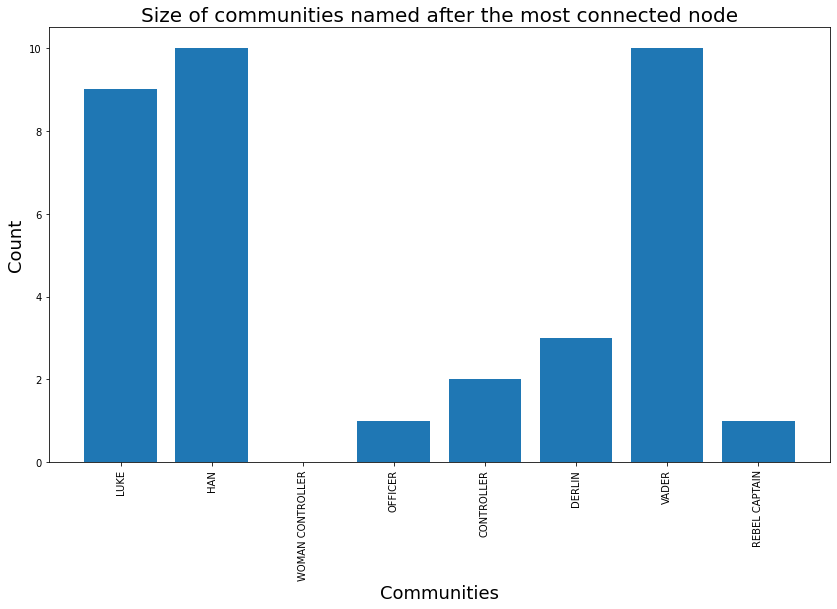

In [117]:
node_to_partition_id = community_louvain.best_partition(G)
partition_id_to_name = {partition_id: community_name(G, node_to_partition_id, partition_id) 
                        for partition_id in set(node_to_partition_id.values())}

community_size = {}
for key in partition_id_to_name.keys():
    community_size[partition_id_to_name[key][0][0]] = partition_id_to_name[key][0][1]
    
plt.figure(figsize=(14,8))
plt.bar(*zip(*community_size.items()))
plt.title('Size of communities named after the most connected node', fontsize=20)
plt.xlabel('Communities', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.xticks(rotation=90)
plt.savefig("Images/Plots/Dist_Community_Ep_V", format="PNG")
plt.show()

### Episode VI

#### Load data

In [118]:
data_scenes = pd.read_pickle('Data/Movies.pkl')
data_lines = pd.read_pickle('Data/Dialogues.pkl')

#### Count dialogues between characters

In [119]:
temp_data = data_scenes[data_scenes['Movie']=='Episode VI'].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-119-a19f029431c7>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [120]:
G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge]) 

#### Number of nodes

In [121]:
print("Number of nodes in the network:", G.number_of_nodes())

Number of nodes in the network: 41


#### Number of edges

In [122]:
print("Number of links in the network:", G.number_of_edges())

Number of links in the network: 200


#### Degree network

In [123]:
connections_in = sorted(dict(G.in_degree()).items(), key = lambda x: x[1], reverse = True)
print('In Degree Connections:')
for character, in_degree in connections_in[:10]:
    node = G.nodes[character]
    print(character.ljust(30), in_degree)

In Degree Connections:
LANDO                          17
LUKE                           16
THREEPIO                       16
HAN                            11
LEIA                           11
ACKBAR                         11
WEDGE                          10
VADER                          8
COMMANDER                      8
MON MOTHMA                     7


#### Visualize the network

100%|██████████| 1000/1000 [00:00<00:00, 8106.49it/s]

BarnesHut Approximation  took  0.03  seconds
Repulsion forces  took  0.06  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.01  seconds


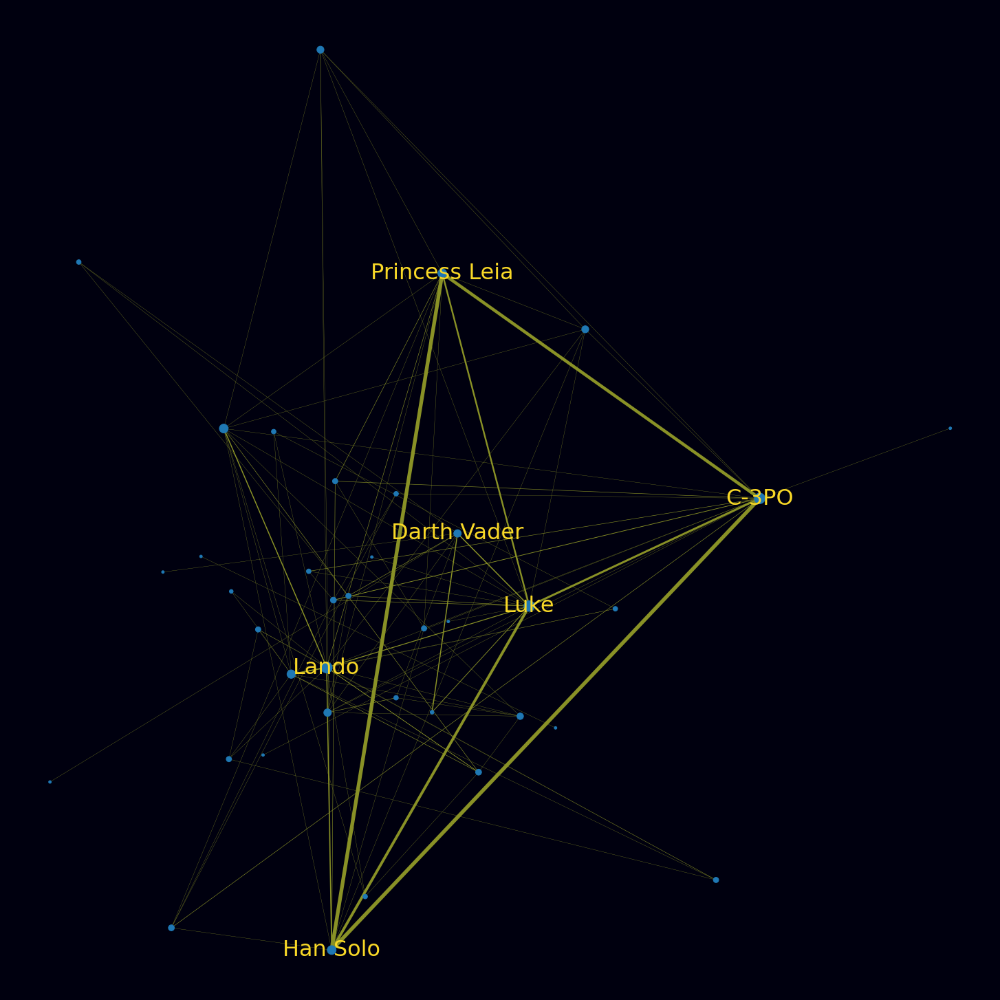

In [124]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

# Plotting
fig = plt.figure(figsize = (20, 20))
nx.draw(G, pos=positions, node_size=node_sizes, edge_color='#899126', width = edge_sizes)
nx.draw_networkx_labels(G, positions, {'HAN':'Han Solo', 'THREEPIO':'C-3PO', 'LUKE':'Luke',
                                       'VADER':'Darth Vader', 'LEIA':'Princess Leia', 'LANDO':'Lando'}, 
                        font_size=32, font_color='#F8D827')

fig.set_facecolor("#00000F")
plt.savefig("Images/Networks/Episode_VI.png", format="PNG")
plt.show()

#### Calculate the nodes with the highest degree centrality

In [125]:
d_centrality = sorted(nx.degree_centrality(G).items(), 
                      key=lambda t: t[1], 
                      reverse=True)

for i in d_centrality[:10]:
    print(i)

('LANDO', 0.42500000000000004)
('LUKE', 0.4)
('THREEPIO', 0.4)
('HAN', 0.275)
('LEIA', 0.275)
('ACKBAR', 0.275)
('WEDGE', 0.25)
('VADER', 0.2)
('COMMANDER', 0.2)
('MON MOTHMA', 0.17500000000000002)


#### Calculate number of communities and the value of modularity

In [126]:
partition = community_louvain.best_partition(G)
communities_louvain = [[node for node in partition if partition[node] == cat] for cat in set(partition.values())]
modularity_louvain = nx.algorithms.community.modularity(G,communities_louvain)

print(f'Number of Communities: {len(set(partition.values()))}')
print(f'Value of Modularity: {modularity_louvain}')

Number of Communities: 7
Value of Modularity: 0.35410529416715764


#### Distribution of communities

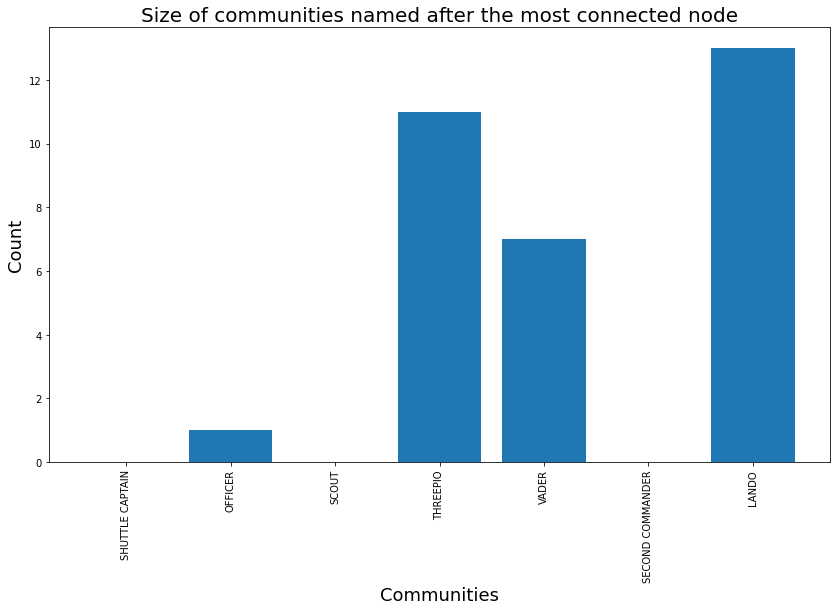

In [127]:
node_to_partition_id = community_louvain.best_partition(G)
partition_id_to_name = {partition_id: community_name(G, node_to_partition_id, partition_id) 
                        for partition_id in set(node_to_partition_id.values())}

community_size = {}
for key in partition_id_to_name.keys():
    community_size[partition_id_to_name[key][0][0]] = partition_id_to_name[key][0][1]
    
plt.figure(figsize=(14,8))
plt.bar(*zip(*community_size.items()))
plt.title('Size of communities named after the most connected node', fontsize=20)
plt.xlabel('Communities', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.xticks(rotation=90)
plt.savefig("Images/Plots/Dist_Community_Ep_VI.png", format="PNG")
plt.show()

# Tools, theory and analysis. Describe the process of theory to insight

## Mentioned Characters

The first thing we tried to do in our analysis was to try to find some kind of an out-degree connection. As we created the edges between the dialofues that are characters had, both in and out degree was the same. So in order to figure out some kind of an out degree connection, we found how many times is a character mentioned in the show. Either by talking to him, or by people refering to him. We also took account when the script is refering to a specific character and describes what is hapenning as it gives more value to the character.

### Episode I

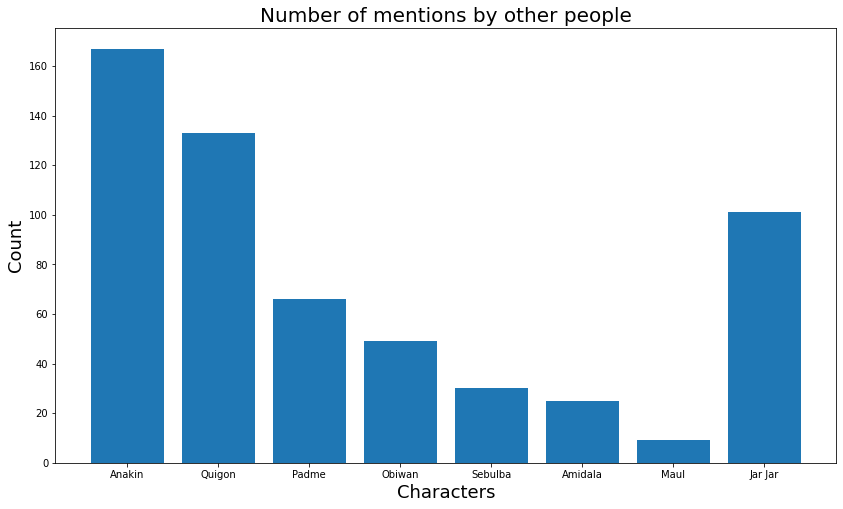

In [128]:
temp_data = data_scenes[data_scenes['Movie']=='Episode I'].reset_index(drop=True)

characters = ['Jar', 'Anakin', 'Quigon', 'Padme', 'Obiwan', 'Sebulba', 'Amidala', 'Maul']

# Creating a list with every scene line
all_words = []
for scene in temp_data['Scene_Dialogue']:
    if scene != None:
        for phrase in scene:
            all_words.append(phrase)

# Creating one big string
string = ''.join(all_words)            

# Split string by every word
splitted_string = re.split(r"[\b\W\b]+", string)
splitted_string.remove('')

# Keep the words that start with a capital letter
names = []
for w in splitted_string:
    if w[0].isupper():
        w = w.title()
        names.append(w)

# Count the occurencies
names = frequent(names)

# Keep specific characters
char_dict = {}
for i in range(len(names)):
    if names[i][0] in characters:
        if names[i][0] == 'Jar':
            char_dict[names[i][0]] = names[i][1]/2
        else:
            char_dict[names[i][0]] = names[i][1]

#Configurations            
char_dict['Jar Jar'] = char_dict.pop('Jar')

# Plotting
plt.figure(figsize=(14,8))
plt.bar(*zip(*char_dict.items()))
plt.title('Number of mentions by other people', fontsize=20)
plt.xlabel('Characters', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.savefig("Images/Plots/Mentions_Ep_I.png", format="PNG")
plt.show()

### Episode II

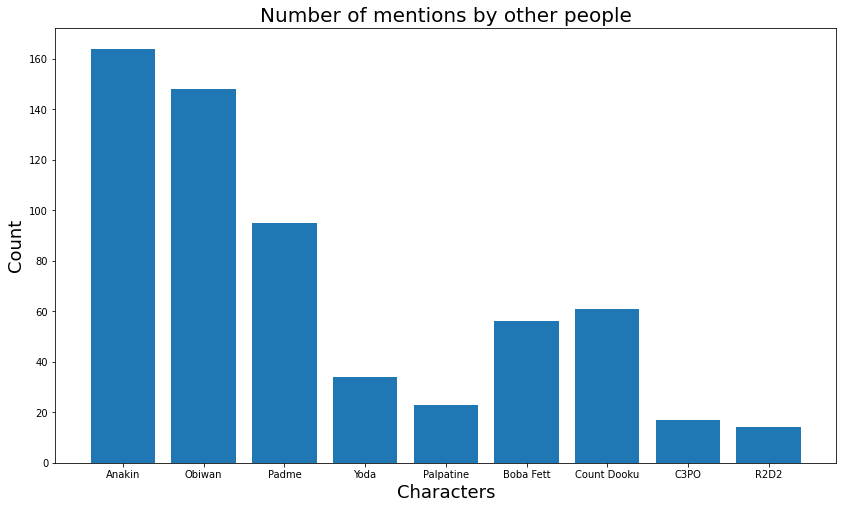

In [129]:
temp_data = data_scenes[data_scenes['Movie']=='Episode II'].reset_index(drop=True)

characters = ['Anakin', 'Padme', 'Obiwan', 'Dooku', 'Fett', 'Yoda', 'C3Po', 'Artoo', 'Chancellor', 'Palpatine']

# Creating a list with every scene line
all_words = []
for scene in temp_data['Scene_Dialogue']:
    if scene != None:
        for phrase in scene:
            all_words.append(phrase)

# Creating one big string
string = ''.join(all_words)            

# Split string by every word
splitted_string = re.split(r"[\b\W\b]+", string)
splitted_string.remove('')

# Keep the words that start with a capital letter
names = []
for w in splitted_string:
    if w[0].isupper():
        w = w.title()
        names.append(w)

# Count the occurencies
names = frequent(names)

# Keep specific characters
char_dict = {}
for i in range(len(names)):
    if names[i][0] in characters:
        if names[i][0] == 'Jar':
            char_dict[names[i][0]] = names[i][1]/2
        else:
            char_dict[names[i][0]] = names[i][1]
            
# Configurations
char_dict['Palpatine'] += char_dict['Chancellor']
char_dict.pop('Chancellor', None)
char_dict['Boba Fett'] = char_dict.pop('Fett')
char_dict['Count Dooku'] = char_dict.pop('Dooku')
char_dict['C3PO'] = char_dict.pop('C3Po')
char_dict['R2D2'] = char_dict.pop('Artoo')

# Plotting
plt.figure(figsize=(14,8))
plt.bar(*zip(*char_dict.items()))
plt.title('Number of mentions by other people', fontsize=20)
plt.xlabel('Characters', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.savefig("Images/Plots/Mentions_Ep_II.png", format="PNG")
plt.show()

### Episode III

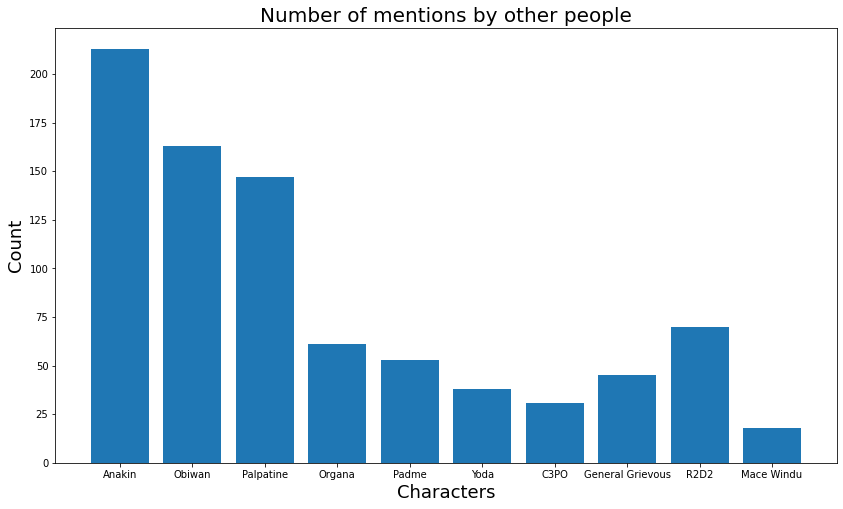

In [130]:
temp_data = data_scenes[data_scenes['Movie']=='Episode III'].reset_index(drop=True)

characters = ['Anakin', 'Padme', 'Obiwan', 'Chancellor', 'Artoo', 'Organa', 'Palpatine', 'Grievous', 'Yoda', 
               'C3Po', 'Windu', 'Threepio']

# Creating a list with every scene line
all_words = []
for scene in temp_data['Scene_Dialogue']:
    if scene != None:
        for phrase in scene:
            all_words.append(phrase)

# Creating one big string
string = ''.join(all_words)            

# Split string by every word
splitted_string = re.split(r"[\b\W\b]+", string)
splitted_string.remove('')

# Keep the words that start with a capital letter
names = []
for w in splitted_string:
    if w != '':
        if w[0].isupper():
            w = w.title()
            names.append(w)

# Count the occurencies
names = frequent(names)

# Keep specific characters
char_dict = {}
for i in range(len(names)):
    if names[i][0] in characters:
        if names[i][0] == 'Jar':
            char_dict[names[i][0]] = names[i][1]/2
        else:
            char_dict[names[i][0]] = names[i][1]

# Configurations
char_dict['Palpatine'] += char_dict['Chancellor']
char_dict.pop('Chancellor', None)
char_dict['C3PO'] = char_dict.pop('C3Po')
char_dict['C3PO'] += char_dict['Threepio']
char_dict.pop('Threepio', None)
char_dict['General Grievous'] = char_dict.pop('Grievous')
char_dict['R2D2'] = char_dict.pop('Artoo')     
char_dict['Mace Windu'] = char_dict.pop('Windu')       

# Plotting
plt.figure(figsize=(14,8))
plt.bar(*zip(*char_dict.items()))
plt.title('Number of mentions by other people', fontsize=20)
plt.xlabel('Characters', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.savefig("Images/Plots/Mentions_Ep_III.png", format="PNG")
plt.show()

### Episode IV

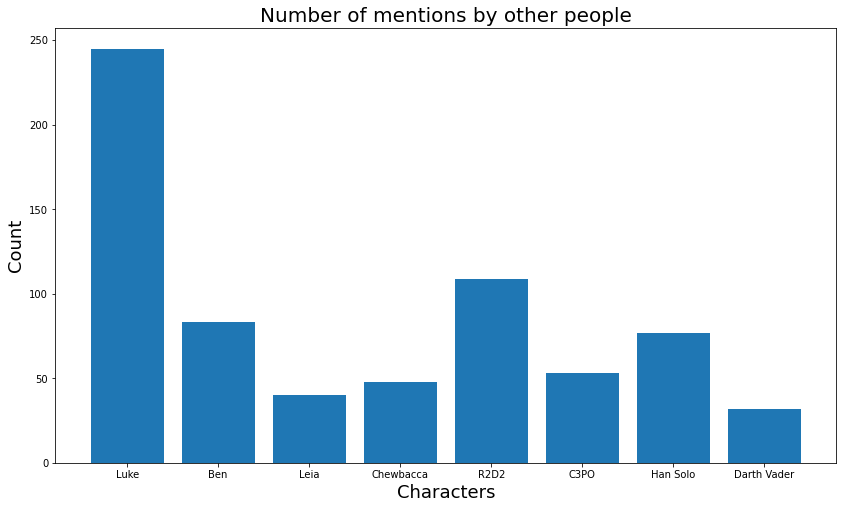

In [131]:
temp_data = data_scenes[data_scenes['Movie']=='Episode IV'].reset_index(drop=True)

characters = ['Luke', 'Artoo', 'Han', 'Threepio', 'Ben', 'Vader', 'Chewbacca', 'Chewie', 'Obiwan', 'R2', 'Leia']

# Creating a list with every scene line
all_words = []
for scene in temp_data['Scene_Dialogue']:
    if scene != None:
        for phrase in scene:
            all_words.append(phrase)

# Creating one big string
string = ''.join(all_words)            

# Split string by every word
splitted_string = re.split(r"[\b\W\b]+", string)
splitted_string.remove('')

# Keep the words that start with a capital letter
names = []
for w in splitted_string:
    if w != '':
        if w[0].isupper():
            w = w.title()
            names.append(w)

# Count the occurencies
names = frequent(names)

# Keep specific characters
char_dict = {}
for i in range(len(names)):
    if names[i][0] in characters:
        if names[i][0] == 'Jar':
            char_dict[names[i][0]] = names[i][1]/2
        else:
            char_dict[names[i][0]] = names[i][1]

# Configurations
char_dict['Artoo'] += char_dict['R2']
char_dict.pop('R2', None)
char_dict['R2D2'] = char_dict.pop('Artoo')
char_dict['C3PO'] = char_dict.pop('Threepio')    
char_dict['Han Solo'] = char_dict.pop('Han')
char_dict['Darth Vader'] = char_dict.pop('Vader')
char_dict['Chewbacca'] += char_dict['Chewie']
char_dict.pop('Chewie', None)
char_dict['Ben'] += char_dict['Obiwan']
char_dict.pop('Obiwan', None)

# Plotting
plt.figure(figsize=(14,8))
plt.bar(*zip(*char_dict.items()))
plt.title('Number of mentions by other people', fontsize=20)
plt.xlabel('Characters', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.savefig("Images/Plots/Mentions_Ep_IV.png", format="PNG")
plt.show()

### Episode V

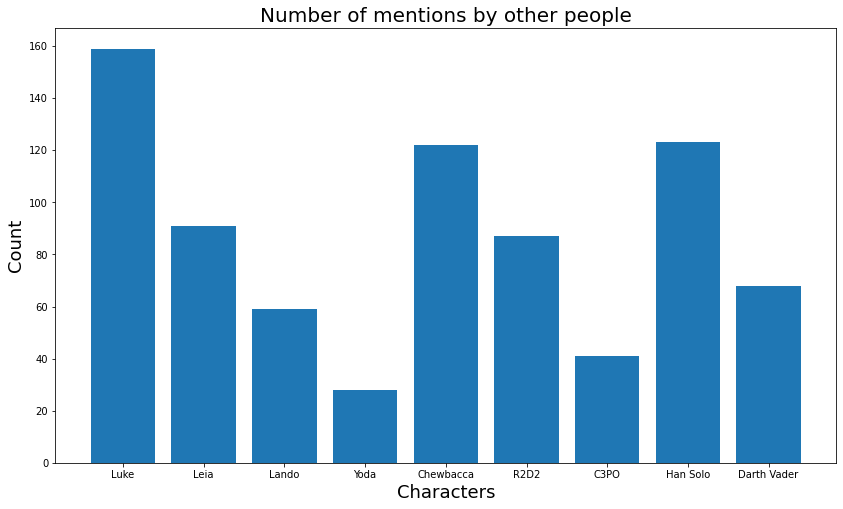

In [132]:
temp_data = data_scenes[data_scenes['Movie']=='Episode V'].reset_index(drop=True)

characters = ['Luke', 'Han', 'Chewie', 'Leia', 'Artoo', 'Vader', 'Lando', 'Threepio', 'Yoda', 'Chewbacca']

# Creating a list with every scene line
all_words = []
for scene in temp_data['Scene_Dialogue']:
    if scene != None:
        for phrase in scene:
            all_words.append(phrase)

# Creating one big string
string = ''.join(all_words)            

# Split string by every word
splitted_string = re.split(r"[\b\W\b]+", string)
splitted_string.remove('')

# Keep the words that start with a capital letter
names = []
for w in splitted_string:
    if w != '':
        if w[0].isupper():
            w = w.title()
            names.append(w)

# Count the occurencies
names = frequent(names)

# Keep specific characters
char_dict = {}
for i in range(len(names)):
    if names[i][0] in characters:
        if names[i][0] == 'Jar':
            char_dict[names[i][0]] = names[i][1]/2
        else:
            char_dict[names[i][0]] = names[i][1]

# Configurations
char_dict['R2D2'] = char_dict.pop('Artoo')
char_dict['C3PO'] = char_dict.pop('Threepio')    
char_dict['Han Solo'] = char_dict.pop('Han')
char_dict['Darth Vader'] = char_dict.pop('Vader')
char_dict['Chewbacca'] += char_dict['Chewie']
char_dict.pop('Chewie', None)

# Plotting
plt.figure(figsize=(14,8))
plt.bar(*zip(*char_dict.items()))
plt.title('Number of mentions by other people', fontsize=20)
plt.xlabel('Characters', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.savefig("Images/Plots/Mentions_Ep_V.png", format="PNG")
plt.show()

### Episode VI

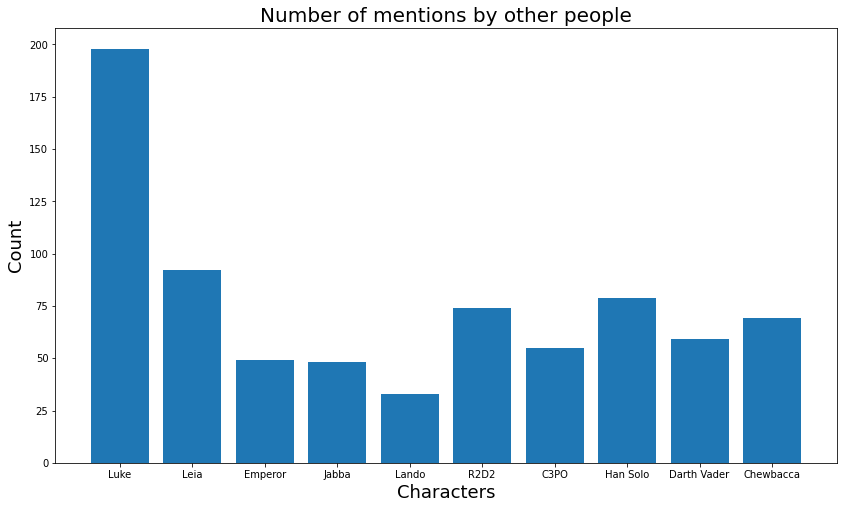

In [133]:
temp_data = data_scenes[data_scenes['Movie']=='Episode VI'].reset_index(drop=True)

characters = ['Luke', 'Leia', 'Artoo', 'Chewie', 'Vader', 'Threepio', 'Emperor', 'Jabba', 'Lando', 'Han']

# Creating a list with every scene line
all_words = []
for scene in temp_data['Scene_Dialogue']:
    if scene != None:
        for phrase in scene:
            all_words.append(phrase)

# Creating one big string
string = ''.join(all_words)            

# Split string by every word
splitted_string = re.split(r"[\b\W\b]+", string)
splitted_string.remove('')

# Keep the words that start with a capital letter
names = []
for w in splitted_string:
    if w[0].isupper():
        names.append(w)

# Count the occurencies
names = frequent(names)

# Keep specific characters
char_dict = {}
for i in range(len(names)):
    if names[i][0] in characters:
        char_dict[names[i][0]] = names[i][1]

# Configurations
char_dict['R2D2'] = char_dict.pop('Artoo')
char_dict['C3PO'] = char_dict.pop('Threepio')    
char_dict['Han Solo'] = char_dict.pop('Han')
char_dict['Darth Vader'] = char_dict.pop('Vader')
char_dict['Chewbacca'] = char_dict.pop('Chewie')

# Plotting
plt.figure(figsize=(14,8))
plt.bar(*zip(*char_dict.items()))
plt.title('Number of mentions by other people', fontsize=20)
plt.xlabel('Characters', fontsize=18)
plt.ylabel('Count', fontsize=18)
plt.savefig("Images/Plots/Mentions_Ep_VI.png", format="PNG")
plt.show()

## Sentiment analysis of characters

The next thing that we wanted to figure out was to perform sentiment analysis  to every character, we wanted to know how our main characters would look like and if the dark side would have a big difference with all the other characters. Furthermore, it was a good opportunity to see the difference between the characters from the first three episodes with the next three. We performed sentiment analysis using both LabMT and VADER. Finally, after calculating the sentiments of each character, in order to have a better overview and comparison between our datasets we plotted the distribution of the sentiments.

#### Read the sentiments of words

In [134]:
LabMT = pd.read_csv('./Files/Data_Set_S1.txt', sep="\t", skiprows = 2)
LabMT_dict = pd.Series(LabMT.happiness_average.values,index=LabMT.word.values).to_dict()

### Wikia Data Source

#### Loading data

In [135]:
char = pd.read_csv('./Data/Characters.csv')

small_data = char[(char['First Trilogy']==1)|(char['Second Trilogy']==1)].reset_index(drop=True)

small_data.loc[(small_data['First Trilogy']==1) & (small_data['Second Trilogy']==0), 'Trilogy'] = 'First three episodes'
small_data.loc[(small_data['First Trilogy']==0) & (small_data['Second Trilogy']==1), 'Trilogy'] = 'Last three episodes'
small_data.loc[(small_data['First Trilogy']==1) & (small_data['Second Trilogy']==1), 'Trilogy'] = 'Both'

G = nx.DiGraph()
for filename in os.listdir(os.path.join(os.getcwd(), 'Data/Characters')):
    if filename[:-4].replace('_',' ') in small_data['Name'].values:
        with open(os.path.join(os.path.join(os.getcwd(), 'Data/Characters'), filename), 'r') as f:
            contents = f.read()
            query_json = ast.literal_eval(contents)
            page_id = list(query_json['query']['pages'].keys())[0]
            string = query_json['query']['pages'][page_id]['revisions'][0]['slots']['main']['*']

            # Add nodes
            name = filename[:-4].replace('_',' ')
            G.add_node(name)

            # Add homeworld attribute
            G.nodes[name]['Homeworld'] = small_data.loc[small_data['Name']==name, 'Homeworld'].values[0]

            # Add species attribute
            G.nodes[name]['Species'] = small_data.loc[small_data['Name']==name, 'Species'].values[0]

            # Add gender
            G.nodes[name]['Gender'] = small_data.loc[small_data['Name']==name, 'Gender'].values[0]
            
            # Add trilogy
            G.nodes[name]['Trilogy'] = small_data.loc[small_data['Name']==name, 'Trilogy'].values[0]
            
            # Add edges
            pattern = '\[\[(.*?)(?:\|.*?)?\]\]'
            temp = re.findall(pattern, string)
            temp = list(small_data[small_data['Name'].isin(temp)]['Name'].drop_duplicates())
            for i in temp:
                G.add_edge(name, i)

G.remove_nodes_from(list(nx.isolates(G)))

#### Create a dictionary for all the characters

In [136]:
node_list = list(G.nodes())
corpus = {}
tokens = {}
for temp_char in node_list:
    path = os.path.join(os.getcwd(), "Data/Characters/", str(temp_char).replace(' ','_') + ".txt")
    with open(path ,encoding = 'utf-8') as f:
            corpus[temp_char] = (f.read()) 
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

sort_sentiment_dict = sorted(sentiment_dict_LabMT.items(),key=lambda x: x[1], reverse = True)
print('Happiest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])
    
sort_sentiment_dict = sorted(sentiment_dict_VADER.items(),key=lambda x: x[1], reverse = True)
print('\nHappiest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])

Happiest Characters (LabMT):
('Camie Loneozner', 4.26392156862745)
('Palejo Reshad', 4.26192307692308)
('Wuher', 4.257700000000002)
('Amee', 4.24344827586207)
('Niai Fieso', 4.220679156908671)

Saddest Characters (LabMT):
('Anakin Skywalker', 2.7021638372406334)
('Whimper Save', 2.946129032258064)
('Reha Logg', 2.953877551020408)
('Sateen Vestswe', 2.9573214285714284)
('Darth Sidious', 2.987951388888891)

Happiest Characters (VADER):
('Kitster Banai', 0.025627312775330393)
('Acros-Krik', 0.021307547169811324)
('Romeo Treblanc', 0.017371347248576852)
('Ottegru Grey', 0.017093478260869564)
('Tyr Taskeen', 0.013882959048877146)

Saddest Characters (VADER):
('Nysad', -0.031507070707070706)
('Yma Nalle', -0.027059756097560977)
('Greeve (Human)', -0.025856989247311828)
('Sidewa', -0.02567543859649123)
('Serennian', -0.025622374429223743)


#### Distribution of sentiment scores (LabMT)

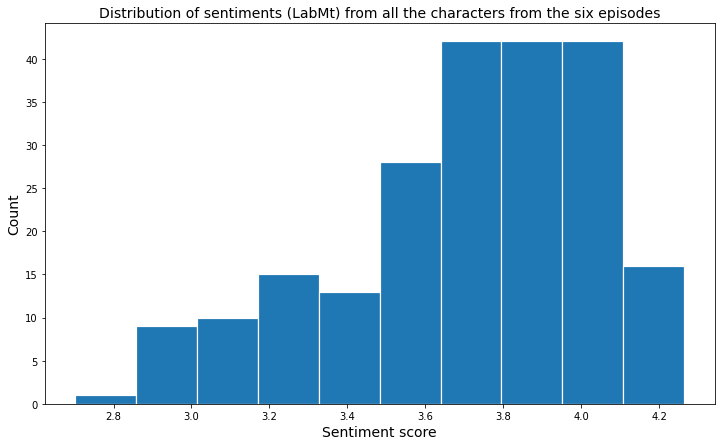

In [137]:
plt.figure(figsize=(12,7))
plt.hist(pd.Series(sentiment_dict_LabMT), edgecolor='white', linewidth=1.2)
plt.title('Distribution of sentiments (LabMt) from all the characters from the six episodes', fontsize =14)
plt.xlabel("Sentiment score", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.savefig("Images/Plots/Dist_LabMT_Small_Network.png", format="PNG")
plt.show()

#### Distribution of sentiment scores (VADER)

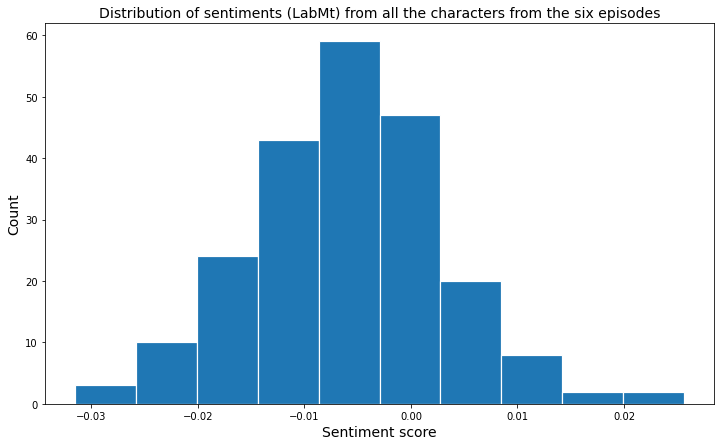

In [138]:
plt.figure(figsize=(12,7))
plt.hist(pd.Series(sentiment_dict_VADER), edgecolor='white', linewidth=1.2)
plt.title('Distribution of sentiments (LabMt) from all the characters from the six episodes', fontsize =14)
plt.xlabel("Sentiment score", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.savefig("Images/Plots/Dist_VADER_Small_Network.png", format="PNG")
plt.show()

### All Episode Scripts

#### Loading data

In [139]:
temp_data = data_scenes.reset_index(drop=True)

#### Create a list of all the word per scene

In [140]:
words_scene = []
for i, temp_scene in enumerate(temp_data['Scene_Dialogue']):
    string = ''
    if temp_scene != None:
        #temp_scene = temp_scene.reset_index(drop=True)
        for temp_temp_scene in temp_scene:
            if temp_temp_scene != None:
                string += ''.join([elem for elem in temp_temp_scene])
        words_scene.append(string)
    else:
        words_scene.append(temp_data['Scene_Description'][i][0])

#### Create a list of all the words per character

In [141]:
temp_lines = data_lines
words_char = {}

for temp_char in temp_lines['Character'].unique():
#for temp_char in list(G.nodes):
    temp_data = temp_lines[temp_lines['Character']==temp_char].reset_index(drop=True)
    string = ''
    for line in temp_data['Line']:
        string += line
    words_char[temp_char] = string

#### Calculate the sentiment for every character

In [142]:
corpus = words_char
tokens = {}
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])
    
sort_sentiment_dict = sorted(sentiment_dict_LabMT.items(),key=lambda x: x[1], reverse = True)
print('Happiest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])
    
sort_sentiment_dict = sorted(sentiment_dict_VADER.items(),key=lambda x: x[1], reverse = True)
print('\nHappiest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])

Happiest Characters (LabMT):
('FIRST CONTROLLER', 6.0)
('SECOND COMMANDER', 6.0)
('REBEL FIGHTER', 5.9)
('GREEN LEADER', 5.875)
('TROOPER VOICE', 5.71)

Saddest Characters (LabMT):
('GUNGAN LOOKOUT', 0)
('ANKAIN', 1.74)
('HEAD CONTROLLER', 2.8449999999999998)
('NAVIGATOR', 2.8833333333333333)
('SEBULBA', 3.2585000000000006)

Happiest Characters (VADER):
('FIRST CONTROLLER', 0.20095)
('SECOND COMMANDER', 0.20095)
('HERMIONE', 0.100475)
('OBIWAM', 0.06364)
('BOUSHH', 0.06282173913043479)

Saddest Characters (VADER):
('ANKAIN', -0.148)
('HOBBIE', -0.08506666666666667)
('WOMAN CONTROLLER', -0.068)
('YWING PILOT', -0.05994666666666667)
('DEAK', -0.056575)


#### Distribution of sentiment scores (LabMT)

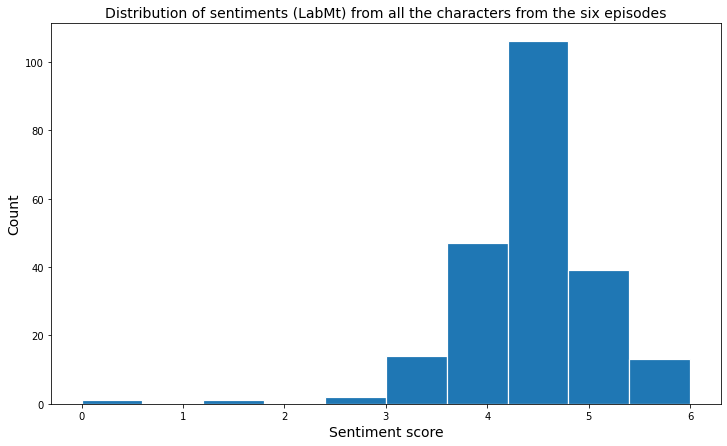

In [143]:
plt.figure(figsize=(12,7))
plt.hist(pd.Series(sentiment_dict_LabMT), edgecolor='white', linewidth=1.2)
plt.title('Distribution of sentiments (LabMt) from all the characters from the six episodes', fontsize =14)
plt.xlabel("Sentiment score", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.savefig("Images/Plots/Dist_LabMT_All_Episodes.png", format="PNG")
plt.show()

#### Distribution of sentiment scores (VADER)

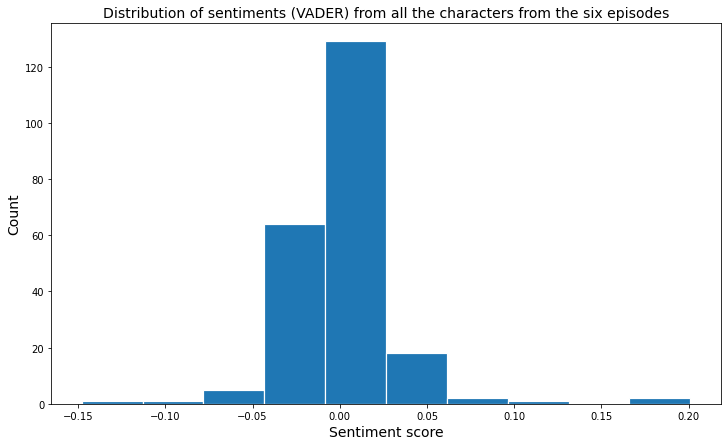

In [144]:
plt.figure(figsize=(12,7))
plt.hist(pd.Series(sentiment_dict_VADER), edgecolor='white', linewidth=1.2)
plt.title('Distribution of sentiments (VADER) from all the characters from the six episodes', fontsize =14)
plt.xlabel("Sentiment score", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.savefig("Images/Plots/Dist_VADER_All_Episodes.png", format="PNG")
plt.show()

### First Trilogy

#### Create a list of all the words per character

In [145]:
temp_lines = data_lines[(data_lines['Movie']=='Episode I') | (data_lines['Movie']=='Episode II') | (data_lines['Movie']=='Episode III')]
words_char = {}

for temp_char in temp_lines['Character'].unique():
    temp_data = temp_lines[temp_lines['Character']==temp_char].reset_index(drop=True)
    string = ''
    for line in temp_data['Line']:
        string += line
    words_char[temp_char] = string

#### Calculate the sentiment for every character

In [146]:
corpus = words_char
tokens = {}
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])
    
sort_sentiment_dict = sorted(sentiment_dict_LabMT.items(),key=lambda x: x[1], reverse = True)
print('Happiest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])
    
sort_sentiment_dict = sorted(sentiment_dict_VADER.items(),key=lambda x: x[1], reverse = True)
print('\nHappiest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])

Happiest Characters (LabMT):
('BERU', 7.0)
('GREEDO', 6.74)
('HERMIONE', 5.709999999999999)
('ANAKINN', 5.63)
('BOBA', 5.505)

Saddest Characters (LabMT):
('GUNGAN LOOKOUT', 0)
('ANKAIN', 1.74)
('JABBA', 2.7060526315789475)
('SEBULBA', 3.2585000000000006)
('ODY', 3.366027397260273)

Happiest Characters (VADER):
('GREEDO', 0.4019)
('HERMIONE', 0.100475)
('CREATURE', 0.0677470588235294)
('OBIWAM', 0.06364)
('LAMA SU', 0.05519245283018868)

Saddest Characters (VADER):
('ANKAIN', -0.148)
('PAMDE', -0.05411666666666667)
('ZAM WESSEL', -0.04697)
('ELAN SLEAZEBAGGANO', -0.03996)
('TEY HOW', -0.039185)


#### Distribution of sentiment scores (LabMT)

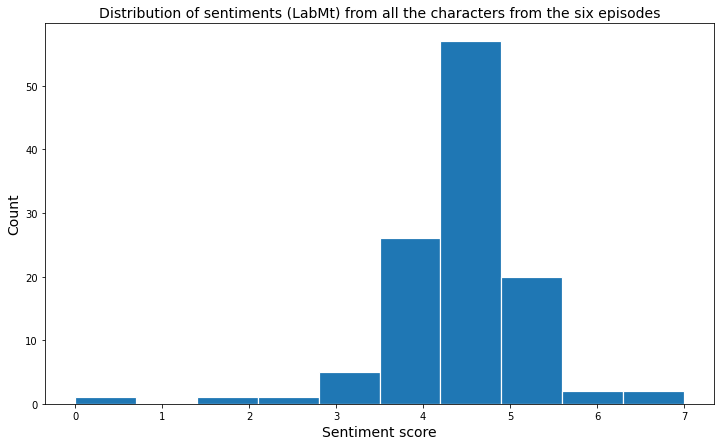

In [147]:
plt.figure(figsize=(12,7))
plt.hist(pd.Series(sentiment_dict_LabMT), edgecolor='white', linewidth=1.2)
plt.title('Distribution of sentiments (LabMt) from all the characters from the six episodes', fontsize =14)
plt.xlabel("Sentiment score", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.savefig("Images/Plots/Dist_LabMT_First.png", format="PNG")
plt.show()

#### Distribution of sentiment scores (VADER)

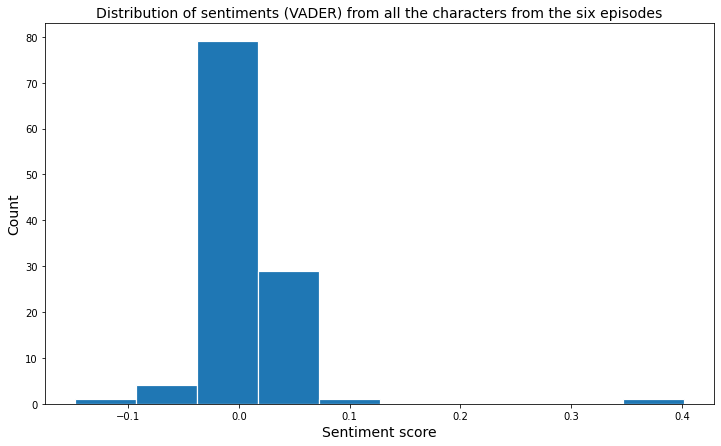

In [148]:
plt.figure(figsize=(12,7))
plt.hist(pd.Series(sentiment_dict_VADER), edgecolor='white', linewidth=1.2)
plt.title('Distribution of sentiments (VADER) from all the characters from the six episodes', fontsize =14)
plt.xlabel("Sentiment score", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.savefig("Images/Plots/Dist_VADER_First.png", format="PNG")
plt.show()

### Second Trilogy

#### Create a list of all the words per character

In [149]:
temp_lines = data_lines[(data_lines['Movie']=='Episode IV') | (data_lines['Movie']=='Episode V') | (data_lines['Movie']=='Episode VI')]
words_char = {}

for temp_char in temp_lines['Character'].unique():
    temp_data = temp_lines[temp_lines['Character']==temp_char].reset_index(drop=True)
    string = ''
    for line in temp_data['Line']:
        string += line
    words_char[temp_char] = string

#### Calculate the sentiment for every character

In [150]:
corpus = words_char
tokens = {}
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])
    
sort_sentiment_dict = sorted(sentiment_dict_LabMT.items(),key=lambda x: x[1], reverse = True)
print('Happiest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])
    
sort_sentiment_dict = sorted(sentiment_dict_VADER.items(),key=lambda x: x[1], reverse = True)
print('\nHappiest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])

Happiest Characters (LabMT):
('FIRST CONTROLLER', 6.0)
('SECOND COMMANDER', 6.0)
('REBEL FIGHTER', 5.9)
('GREEN LEADER', 5.875)
('TROOPER VOICE', 5.71)

Saddest Characters (LabMT):
('HEAD CONTROLLER', 2.8449999999999998)
('NAVIGATOR', 2.8833333333333333)
('BIB', 3.3398387096774194)
('OOLA', 3.3425)
('DAY', 3.442424242424243)

Happiest Characters (VADER):
('FIRST CONTROLLER', 0.20095)
('SECOND COMMANDER', 0.20095)
('BOUSHH', 0.06282173913043479)
('PILOTS', 0.056575)
('JERJERROD', 0.04279428571428571)

Saddest Characters (VADER):
('HOBBIE', -0.08506666666666667)
('WOMAN CONTROLLER', -0.068)
('YWING PILOT', -0.05994666666666667)
('DEAK', -0.056575)
('CONTROLLER', -0.04298571428571429)


#### Distribution of sentiment scores (LabMT)

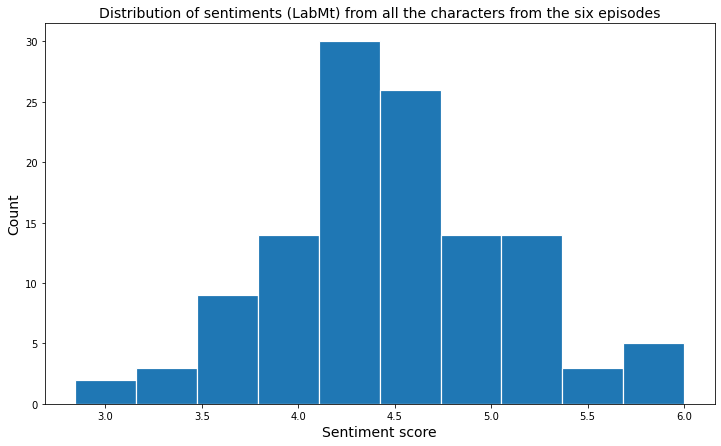

In [151]:
plt.figure(figsize=(12,7))
plt.hist(pd.Series(sentiment_dict_LabMT), edgecolor='white', linewidth=1.2)
plt.title('Distribution of sentiments (LabMt) from all the characters from the six episodes', fontsize =14)
plt.xlabel("Sentiment score", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.savefig("Images/Plots/Dist_LabMT_Second.png", format="PNG")
plt.show()

#### Distribution of sentiment scores (VADER)

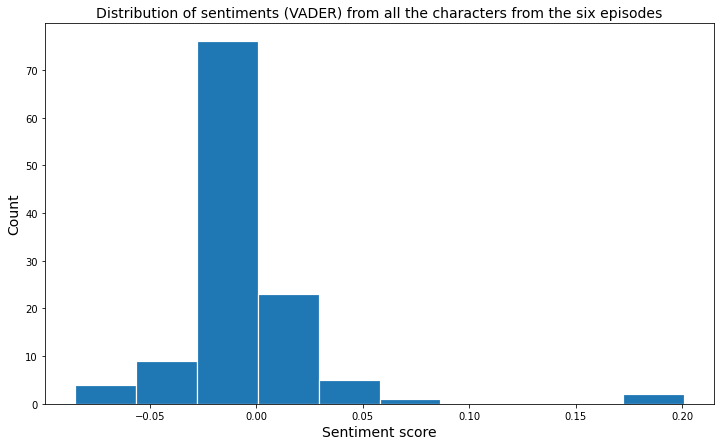

In [152]:
plt.figure(figsize=(12,7))
plt.hist(pd.Series(sentiment_dict_VADER), edgecolor='white', linewidth=1.2)
plt.title('Distribution of sentiments (VADER) from all the characters from the six episodes', fontsize =14)
plt.xlabel("Sentiment score", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.savefig("Images/Plots/Dist_VADER_Second.png", format="PNG")
plt.show()

### Episode I

#### Create a list of all the words per character

In [153]:
temp_lines = data_lines[data_lines['Movie']=='Episode I']
words_char = {}

for temp_char in temp_lines['Character'].unique():
    temp_data = temp_lines[temp_lines['Character']==temp_char].reset_index(drop=True)
    string = ''
    for line in temp_data['Line']:
        string += line
    words_char[temp_char] = string

#### Calculate the sentiment for every character

In [154]:
corpus = words_char
tokens = {}
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])
    
sort_sentiment_dict = sorted(sentiment_dict_LabMT.items(),key=lambda x: x[1], reverse = True)
print('Happiest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])
    
sort_sentiment_dict = sorted(sentiment_dict_VADER.items(),key=lambda x: x[1], reverse = True)
print('\nHappiest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])

Happiest Characters (LabMT):
('GREEDO', 6.74)
('PILOT', 5.77)
('GUARD DROID', 5.46)
('GUIGON', 5.389999999999999)
('GUARD', 5.313333333333333)

Saddest Characters (LabMT):
('GUNGAN LOOKOUT', 0)
('ANKAIN', 1.74)
('JABBA', 2.7060526315789475)
('SEBULBA', 3.2585000000000006)
('ODY', 3.366027397260273)

Happiest Characters (VADER):
('GREEDO', 0.4019)
('CAPTAIN', 0.06337586206896552)
('KITSTER', 0.053906382978723404)
('SEEK', 0.03354848484848485)
('GUARD', 0.03349166666666666)

Saddest Characters (VADER):
('ANKAIN', -0.148)
('TEY HOW', -0.039185)
('MACE WINDU', -0.03675625)
('ANAKN', -0.029599999999999998)
('DROID GUARD', -0.02957076923076923)


### Episode II

#### Create a list of all the words per character

In [155]:
temp_lines = data_lines[data_lines['Movie']=='Episode II']
words_char = {}

for temp_char in temp_lines['Character'].unique():
    temp_data = temp_lines[temp_lines['Character']==temp_char].reset_index(drop=True)
    string = ''
    for line in temp_data['Line']:
        string += line
    words_char[temp_char] = string

#### Calculate the sentiment for every character

In [156]:
corpus = words_char
tokens = {}
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])
    
sort_sentiment_dict = sorted(sentiment_dict_LabMT.items(),key=lambda x: x[1], reverse = True)
print('Happiest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])
    
sort_sentiment_dict = sorted(sentiment_dict_VADER.items(),key=lambda x: x[1], reverse = True)
print('\nHappiest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])

Happiest Characters (LabMT):
('BERU', 7.0)
('DARTH SIDIOUS', 5.736923076923079)
('HERMIONE', 5.709999999999999)
('BOBA', 5.505)
('OBIWAM', 5.412000000000001)

Saddest Characters (LabMT):
('DROID CAPTAIN', 3.6418181818181816)
('BOBA FETT', 3.6744961240310072)
('ZAM', 3.912340425531915)
('OBIWAN', 3.9532336018411987)
('NUTE GUNRAY', 3.9901333333333318)

Happiest Characters (VADER):
('THREEPIO', 0.10376923076923077)
('HERMIONE', 0.100475)
('DARTH SIDIOUS', 0.07058461538461538)
('OBIWAM', 0.06364)
('LAMA SU', 0.05519245283018868)

Saddest Characters (VADER):
('PAMDE', -0.05411666666666667)
('ZAM WESSEL', -0.04697)
('ELAN SLEAZEBAGGANO', -0.03996)
('ARTOO BEEPS', -0.0374025641025641)
('PLO KOON', -0.03475357142857143)


### Episode III

#### Create a list of all the words per character

In [157]:
temp_lines = data_lines[data_lines['Movie']=='Episode III']
words_char = {}

for temp_char in temp_lines['Character'].unique():
    temp_data = temp_lines[temp_lines['Character']==temp_char].reset_index(drop=True)
    string = ''
    for line in temp_data['Line']:
        string += line
    words_char[temp_char] = string

#### Calculate the sentiment for every character

In [158]:
corpus = words_char
tokens = {}
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])
    
sort_sentiment_dict = sorted(sentiment_dict_LabMT.items(),key=lambda x: x[1], reverse = True)
print('Happiest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])
    
sort_sentiment_dict = sorted(sentiment_dict_VADER.items(),key=lambda x: x[1], reverse = True)
print('\nHappiest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])

Happiest Characters (LabMT):
('ANAKINN', 5.63)
('CREATURE', 5.28)
('GUARD', 5.2553846153846155)
('MOTEE', 5.105263157894736)
('YOUNGLINGS', 4.938461538461539)

Saddest Characters (LabMT):
('BLY', 3.635135135135135)
('OBIWAN', 3.854285714285708)
('FANGZAR', 3.9275)
('ANAKIN', 3.977844311377246)
('PILOT', 4.007179487179488)

Happiest Characters (VADER):
('CREATURE', 0.0677470588235294)
('FANGZAR', 0.05505)
('GUARD', 0.048476923076923084)
('QUIGON', 0.021460526315789475)
('BAIL', 0.013782222222222223)

Saddest Characters (VADER):
('AAYLA', -0.024650000000000002)
('THREEPIO', -0.02446739130434783)
('BLY', -0.020648648648648647)
('PILOT', -0.01896923076923077)
('MACE', -0.013895890410958903)


### Episode IV

#### Create a list of all the words per character

In [159]:
temp_lines = data_lines[data_lines['Movie']=='Episode IV']
words_char = {}

for temp_char in temp_lines['Character'].unique():
    temp_data = temp_lines[temp_lines['Character']==temp_char].reset_index(drop=True)
    string = ''
    for line in temp_data['Line']:
        string += line
    words_char[temp_char] = string

#### Calculate the sentiment for every character

In [160]:
corpus = words_char
tokens = {}
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])
    
sort_sentiment_dict = sorted(sentiment_dict_LabMT.items(),key=lambda x: x[1], reverse = True)
print('Happiest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])
    
sort_sentiment_dict = sorted(sentiment_dict_VADER.items(),key=lambda x: x[1], reverse = True)
print('\nHappiest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])

Happiest Characters (LabMT):
('TROOPER VOICE', 5.71)
('CHIEF', 5.6177777777777775)
('TECHNICIAN', 5.5475)
('RED TEN', 5.331212121212122)
('PORKINS', 5.31)

Saddest Characters (LabMT):
('DAY', 3.442424242424243)
('SPEEDER LOT', 3.545)
('CREATURE', 3.65875)
('RED SEVEN', 3.7685714285714282)
('SPACE', 3.791111111111111)

Happiest Characters (VADER):
('CHIEF', 0.041327777777777776)
('BERU', 0.02121333333333333)
('SECOND TROOPER', 0.017961702127659573)
('BIGGS', 0.017163272727272732)
('AREA', 0.0122375)

Saddest Characters (VADER):
('DEAK', -0.056575)
('CAPTAIN', -0.04542857142857143)
('MOTTI', -0.042447126436781606)
('BASE VOICE', -0.039725)
('CONTROL OFFICER', -0.039593333333333335)


### Episode V

#### Create a list of all the words per character

In [161]:
temp_lines = data_lines[data_lines['Movie']=='Episode V']
words_char = {}

for temp_char in temp_lines['Character'].unique():
    temp_data = temp_lines[temp_lines['Character']==temp_char].reset_index(drop=True)
    string = ''
    for line in temp_data['Line']:
        string += line
    words_char[temp_char] = string

#### Calculate the sentiment for every character

In [162]:
corpus = words_char
tokens = {}
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])
    
sort_sentiment_dict = sorted(sentiment_dict_LabMT.items(),key=lambda x: x[1], reverse = True)
print('Happiest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])
    
sort_sentiment_dict = sorted(sentiment_dict_VADER.items(),key=lambda x: x[1], reverse = True)
print('\nHappiest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])

Happiest Characters (LabMT):
('CAPTAIN', 6.0)
('FIRST CONTROLLER', 6.0)
('REBEL FIGHTER', 5.9)
('OFFICER', 5.73)
('DERLIN', 5.1008000000000004)

Saddest Characters (LabMT):
('HEAD CONTROLLER', 2.8449999999999998)
('PILOT', 2.9369230769230774)
('WEDGE', 3.4907017543859644)
('HOBBIE', 3.543333333333333)
('SECOND THREEPIO', 3.595)

Happiest Characters (VADER):
('FIRST CONTROLLER', 0.20095)
('OFFICER', 0.10115)
('CAPTAIN', 0.06291428571428571)
('PILOTS', 0.056575)
('MEDICAL DROID', 0.04115833333333333)

Saddest Characters (VADER):
('HOBBIE', -0.08506666666666667)
('WOMAN CONTROLLER', -0.068)
('SECOND CONTROLLER', -0.04170909090909091)
('SECOND OFFICER', -0.034709090909090905)
('SENIOR CONTROLLER', -0.032135000000000004)


### Episode VI

#### Create a list of all the words per character

In [163]:
temp_lines = data_lines[data_lines['Movie']=='Episode VI']
words_char = {}

for temp_char in temp_lines['Character'].unique():
    temp_data = temp_lines[temp_lines['Character']==temp_char].reset_index(drop=True)
    string = ''
    for line in temp_data['Line']:
        string += line
    words_char[temp_char] = string

#### Calculate the sentiment for every character

In [164]:
corpus = words_char
tokens = {}
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])
    
sort_sentiment_dict = sorted(sentiment_dict_LabMT.items(),key=lambda x: x[1], reverse = True)
print('Happiest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (LabMT):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])
    
sort_sentiment_dict = sorted(sentiment_dict_VADER.items(),key=lambda x: x[1], reverse = True)
print('\nHappiest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[i])
print('\nSaddest Characters (VADER):')
for i in range(5):
    print(sort_sentiment_dict[-i-1])

Happiest Characters (LabMT):
('SECOND COMMANDER', 6.0)
('GREEN LEADER', 5.875)
('RED THREE', 5.499999999999999)
('GRAY LEADER', 5.335)
('RED TWO', 5.31)

Saddest Characters (LabMT):
('STRANGE VOICE', 1.41)
('NAVIGATOR', 2.8833333333333333)
('BIB', 3.3398387096774194)
('OOLA', 3.3425)
('YWING PILOT', 3.506666666666667)

Happiest Characters (VADER):
('SECOND COMMANDER', 0.20095)
('BOUSHH', 0.06282173913043479)
('JERJERROD', 0.04279428571428571)
('OPERATOR', 0.014885185185185184)
('VADER', 0.010540490797546013)

Saddest Characters (VADER):
('YWING PILOT', -0.05994666666666667)
('CONTROLLER', -0.040775000000000006)
('OOLA', -0.03574375)
('NAVIGATOR', -0.032888888888888884)
('COMMANDER', -0.020744444444444447)


## Comparing character's timeline with sentiment timeline

The next step was to see how a character could affect the sentiment of the movie. The first step was then to calculate the character's activeness timeline. Basically we digged up how many times does a character talk during a scene. Then we calculated the sentiment for every scene, but the results couldn't help us a lot. So we decided to calculate the sentiment for every scene with regards to the previous scene as well. With that in mind we could see when a character was active, how it affected the movie. Finally, the sentiment score for the whole movie was calculated.

### Episode I

### Loading data

In [165]:
temp_data = data_scenes[data_scenes['Movie']=='Episode I'].reset_index(drop=True)

#### Characters timeline

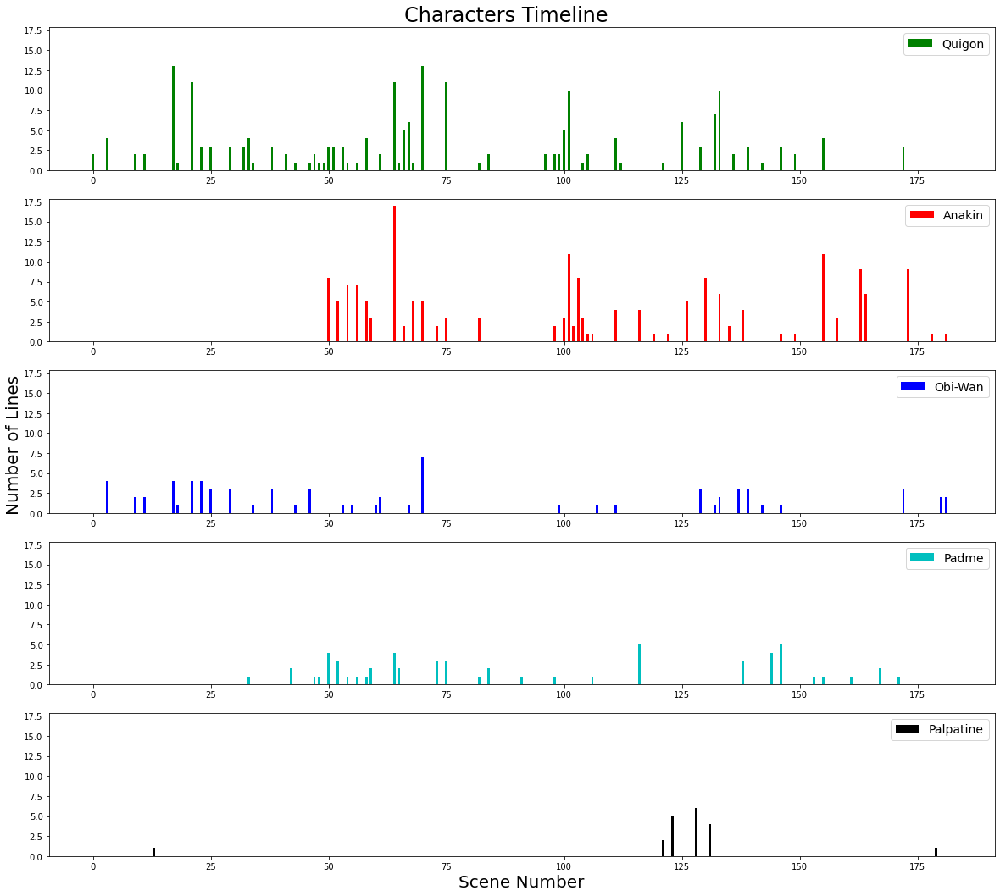

In [166]:
Quigon, Anakin, Obiwan, Padme, Palpatine = [], [], [], [], []

for scene in range(len(temp_data['Scene_Characters'])):
    if temp_data['Scene_Characters'][scene] != None:
        Quigon.append(temp_data['Scene_Characters'][scene].count('QUIGON'))
        Anakin.append(temp_data['Scene_Characters'][scene].count('ANAKIN'))
        Obiwan.append(temp_data['Scene_Characters'][scene].count('OBIWAN'))
        Padme.append(temp_data['Scene_Characters'][scene].count('PADME'))
        Palpatine.append(temp_data['Scene_Characters'][scene].count('PALPATINE'))
    else:
        Quigon.append(0)
        Anakin.append(0)
        Obiwan.append(0)
        Padme.append(0)
        Palpatine.append(0)
        
temp_characters = [Quigon, Anakin, Obiwan, Padme, Palpatine]
labels = ['Quigon', 'Anakin', 'Obi-Wan', 'Padme', 'Palpatine']
colors = ['Green', 'Red', 'Blue', 'c', 'Black']

fig = plt.figure(figsize=(20, 18))
X_axis = np.arange(len(temp_data))
for i, temp_char in enumerate(temp_characters):
    if i != 0:
        ax = fig.add_subplot(len(temp_characters), 1, i+1, sharex=temp_ax, sharey=temp_ax)
    else:
        ax = fig.add_subplot(len(temp_characters), 1, i+1)
    temp_ax = ax
    ax.bar(X_axis, temp_char, 0.5, label=labels[i], color=colors[i])
    ax.legend(loc='upper right', fontsize=14)

fig.suptitle("Characters Timeline", fontsize=24, y=0.9)    
plt.xlabel("Scene Number", fontsize=20)
fig.text(0.09, 0.5, 'Number of Lines', va='center', rotation='vertical', fontsize=20)
plt.savefig("Images/Plots/Char_Timeline_Ep_I.png", format="PNG")
plt.show()

#### Create a list of all the word per scene

In [167]:
words_scene = []
for i, temp_scene in enumerate(temp_data['Scene_Dialogue']):
    string = ''
    if temp_scene != None:
        #temp_scene = temp_scene.reset_index(drop=True)
        for temp_temp_scene in temp_scene:
            if temp_temp_scene != None:
                string += ''.join([elem for elem in temp_temp_scene])
        words_scene.append(string)
    else:
        words_scene.append(temp_data['Scene_Description'][i][0])

#### Calculate the sentiment per scene

In [168]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    corpus[scene_number] = scene
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Visualize sentiment per scene (LabMT)

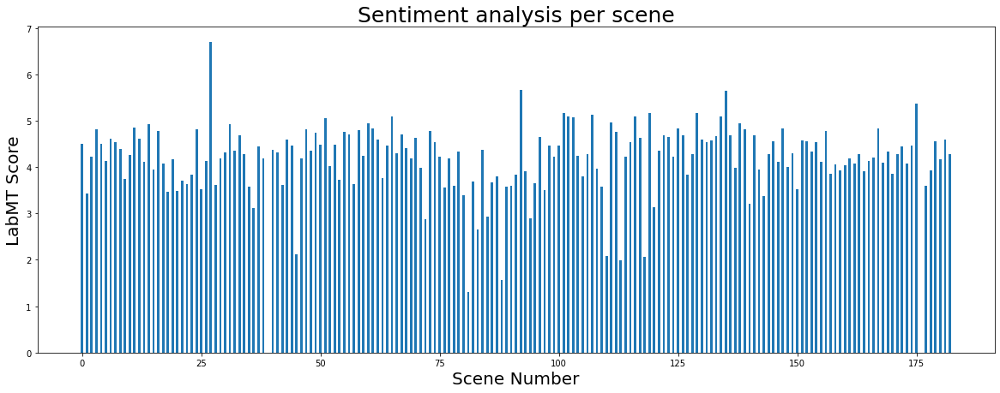

In [169]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_LabMT.values()), 0.5)
plt.title('Sentiment analysis per scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_per_Scene_Ep_I_LabMT.png", format="PNG")
plt.show()

#### Visualize sentiment per scene (VADER)

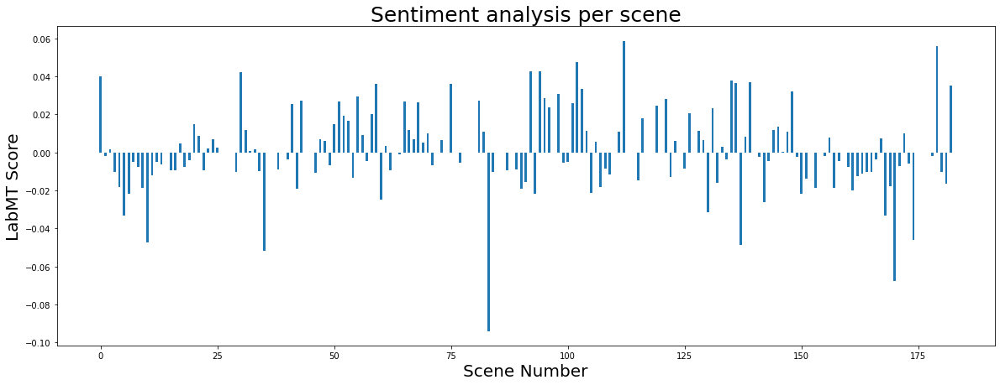

In [170]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_VADER.values()), 0.5)
plt.title('Sentiment analysis per scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_per_Scene_Ep_I_VADER.png", format="PNG")
plt.show()

#### Calculate the sentiment up until the scene

In [171]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    if scene_number == 0:
        corpus[scene_number] = scene 
    else:
        corpus[scene_number] = corpus[scene_number-1] + scene 
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Visualize sentiment per scene (LabMT)

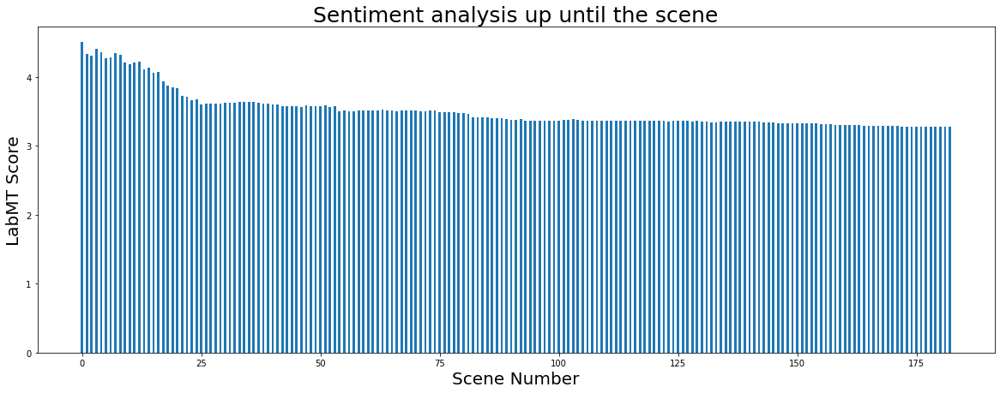

In [172]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_LabMT.values()), 0.5)
plt.title('Sentiment analysis up until the scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_until_Scene_Ep_I_LabMT.png", format="PNG")
plt.show()

#### Visualize sentiment per scene (VADER)

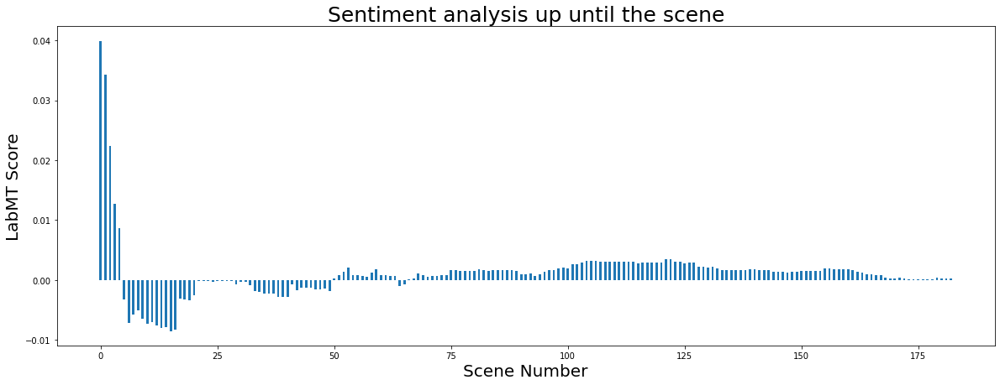

In [173]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_VADER.values()), 0.5)
plt.title('Sentiment analysis up until the scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_until_Scene_Ep_I_VADER.png", format="PNG")
plt.show()

#### Sentiment score of the whole movie

In [174]:
print('LabMT Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_LabMT[len(sentiment_dict_LabMT)-1]))
print('VADER Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_VADER[len(sentiment_dict_VADER)-1]))

LabMT Sentiment Score for the Movie: 3.27719
VADER Sentiment Score for the Movie: 0.00032


### Episode II

#### Loading data

In [175]:
temp_data = data_scenes[data_scenes['Movie']=='Episode II'].reset_index(drop=True)

#### Characters timeline

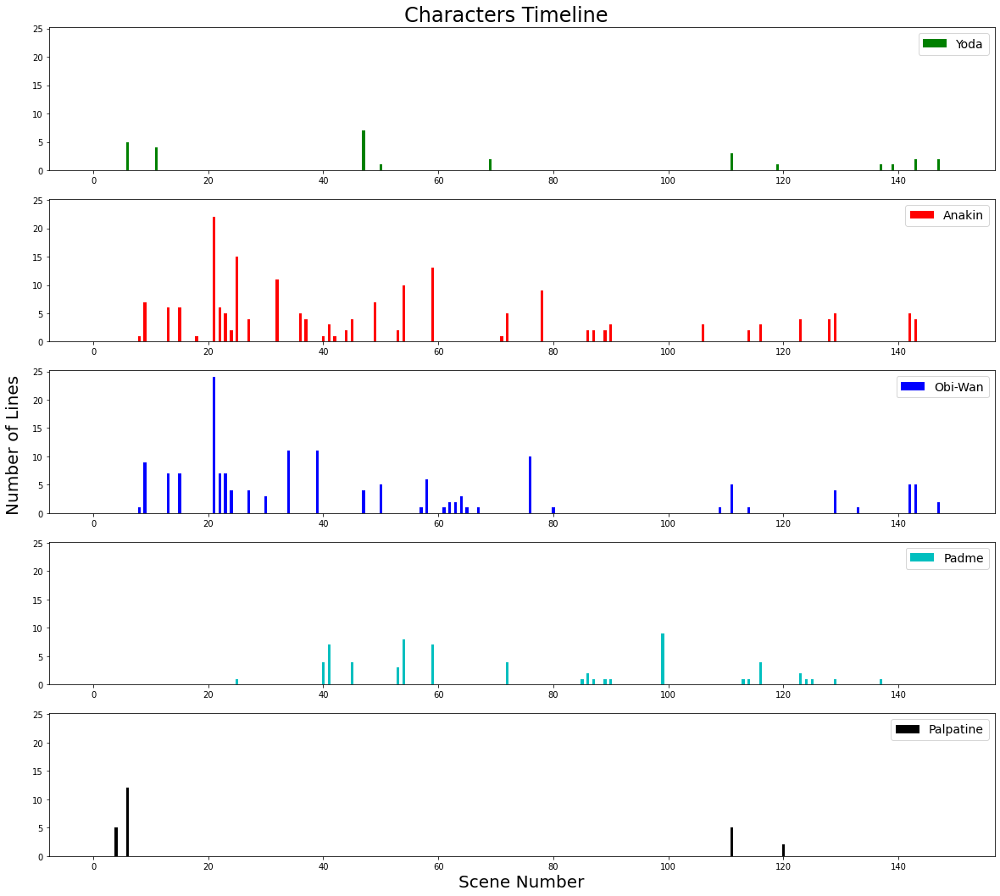

In [176]:
Yoda, Anakin, Obiwan, Padme, Palpatine = [], [], [], [], []

for scene in range(len(temp_data['Scene_Characters'])):
    if temp_data['Scene_Characters'][scene] != None:
        Yoda.append(temp_data['Scene_Characters'][scene].count('YODA'))
        Anakin.append(temp_data['Scene_Characters'][scene].count('ANAKIN'))
        Obiwan.append(temp_data['Scene_Characters'][scene].count('OBIWAN'))
        Padme.append(temp_data['Scene_Characters'][scene].count('PADME'))
        Palpatine.append(temp_data['Scene_Characters'][scene].count('PALPATINE'))
    else:
        Yoda.append(0)
        Anakin.append(0)
        Obiwan.append(0)
        Padme.append(0)
        Palpatine.append(0)
        
temp_characters = [Yoda, Anakin, Obiwan, Padme, Palpatine]
labels = ['Yoda', 'Anakin', 'Obi-Wan', 'Padme', 'Palpatine']
colors = ['Green', 'Red', 'Blue', 'c', 'Black']

fig = plt.figure(figsize=(20, 18))
X_axis = np.arange(len(temp_data))
for i, temp_char in enumerate(temp_characters):
    if i != 0:
        ax = fig.add_subplot(len(temp_characters), 1, i+1, sharex=temp_ax, sharey=temp_ax)
    else:
        ax = fig.add_subplot(len(temp_characters), 1, i+1)
    temp_ax = ax
    ax.bar(X_axis, temp_char, 0.5, label=labels[i], color=colors[i])
    ax.legend(loc='upper right', fontsize=14)

fig.suptitle("Characters Timeline", fontsize=24, y=0.9)    
plt.xlabel("Scene Number", fontsize=20)
fig.text(0.09, 0.5, 'Number of Lines', va='center', rotation='vertical', fontsize=20)
plt.savefig("Images/Plots/Char_Timeline_Ep_II.png", format="PNG")
plt.show()

#### Create a list of all the word per scene

In [177]:
words_scene = []
for i, temp_scene in enumerate(temp_data['Scene_Dialogue']):
    string = ''
    if temp_scene != None:
        #temp_scene = temp_scene.reset_index(drop=True)
        for temp_temp_scene in temp_scene:
            if temp_temp_scene != None:
                string += ''.join([elem for elem in temp_temp_scene])
        words_scene.append(string)
    else:
        words_scene.append(temp_data['Scene_Description'][i][0])

#### Calculate the sentiment per scene

In [178]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    corpus[scene_number] = scene
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Visualize sentiment per scene (LabMT)

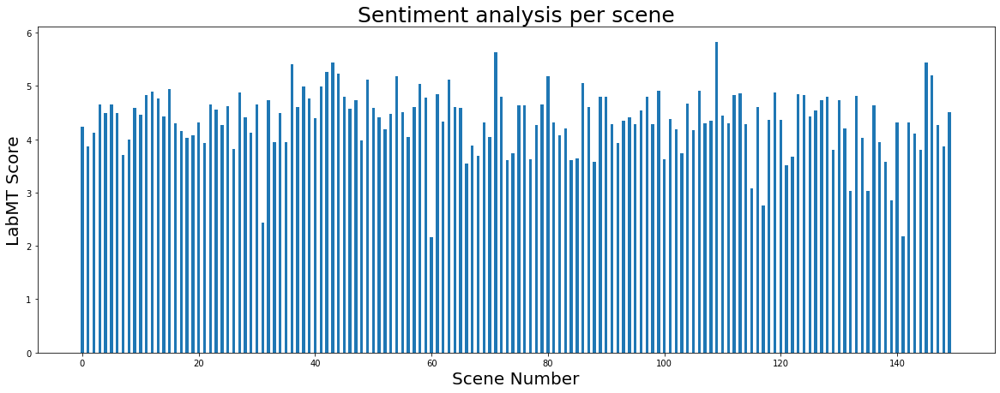

In [179]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_LabMT.values()), 0.5)
plt.title('Sentiment analysis per scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_per_Scene_Ep_II_LabMT.png", format="PNG")
plt.show()

#### Visualize sentiment per scene (VADER)

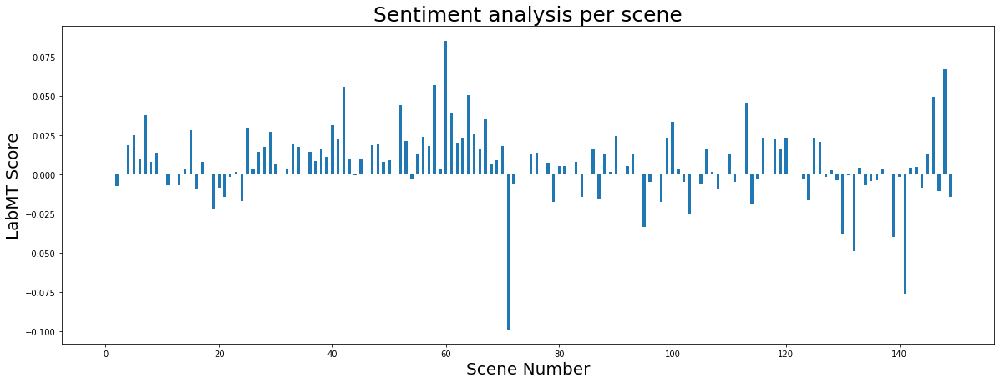

In [180]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_VADER.values()), 0.5)
plt.title('Sentiment analysis per scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_per_Scene_Ep_II_VADER.png", format="PNG")
plt.show()

#### Calculate the sentiment up until the scene

In [181]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    if scene_number == 0:
        corpus[scene_number] = scene 
    else:
        corpus[scene_number] = corpus[scene_number-1] + scene 
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Visualize sentiment per scene (LabMT)

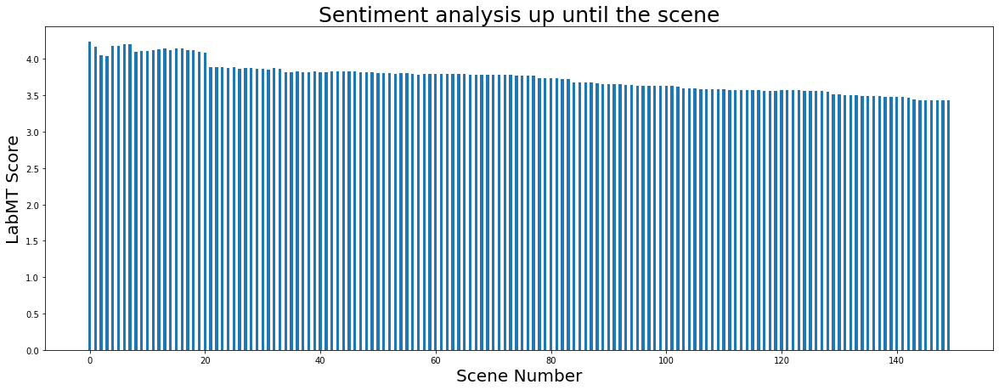

In [182]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_LabMT.values()), 0.5)
plt.title('Sentiment analysis up until the scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_until_Scene_Ep_II_LabMT.png", format="PNG")
plt.show()

#### Visualize sentiment per scene (VADER)

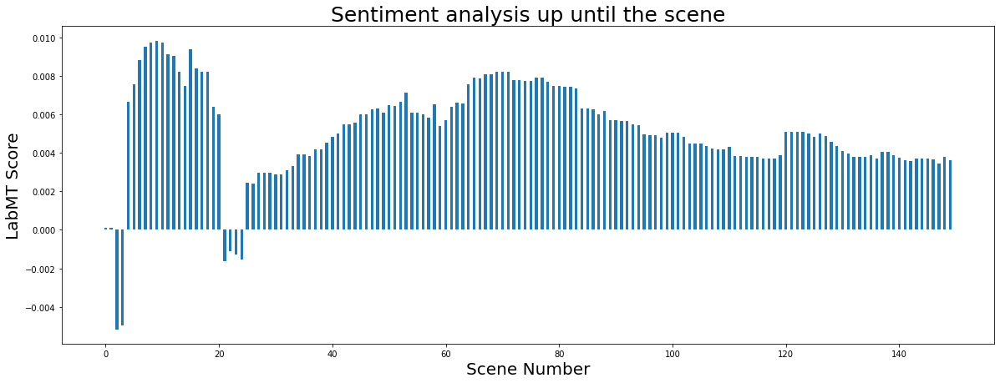

In [183]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_VADER.values()), 0.5)
plt.title('Sentiment analysis up until the scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_until_Scene_Ep_II_VADER.png", format="PNG")
plt.show()

#### Sentiment score of the whole movie

In [184]:
print('LabMT Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_LabMT[len(sentiment_dict_LabMT)-1]))
print('VADER Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_VADER[len(sentiment_dict_VADER)-1]))

LabMT Sentiment Score for the Movie: 3.43357
VADER Sentiment Score for the Movie: 0.00360


### Episode III

#### Loading data

In [185]:
temp_data = data_scenes[data_scenes['Movie']=='Episode III'].reset_index(drop=True)

#### Characters timeline

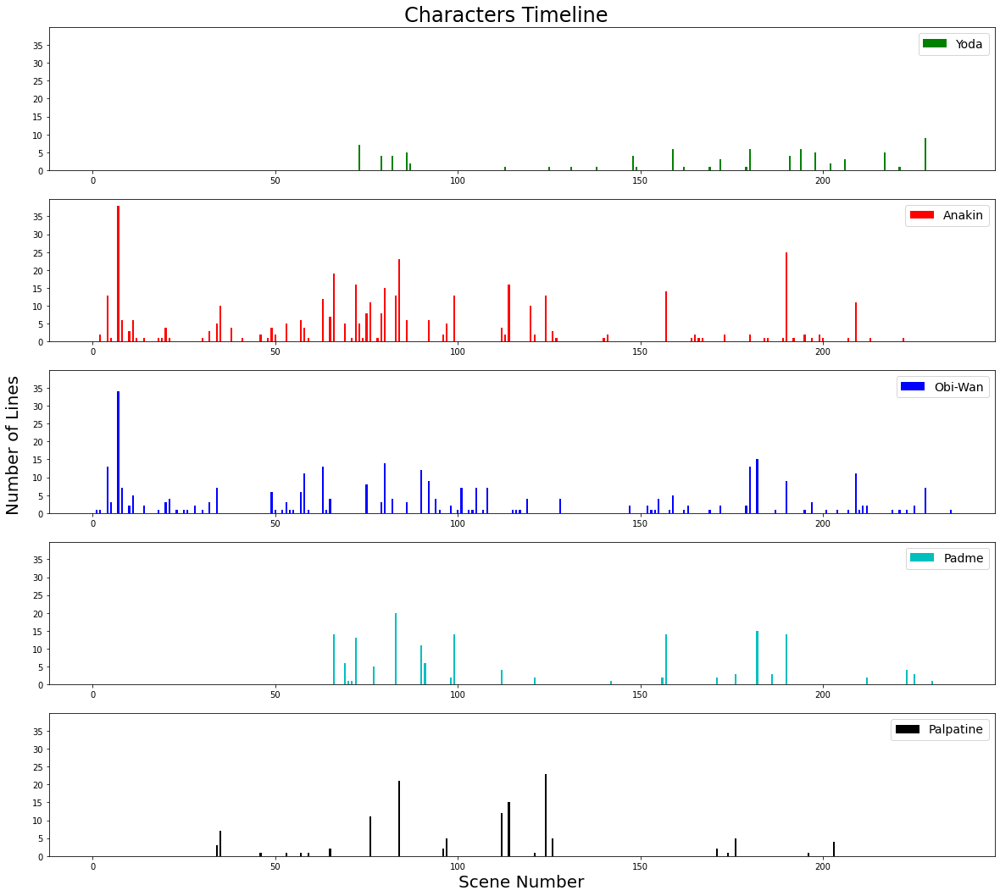

In [186]:
Yoda, Anakin, Obiwan, Padme, Palpatine = [], [], [], [], []

for scene in range(len(temp_data['Scene_Characters'])):
    if temp_data['Scene_Characters'][scene] != None:
        Yoda.append(temp_data['Scene_Characters'][scene].count('YODA'))
        Anakin.append(temp_data['Scene_Characters'][scene].count('ANAKIN'))
        Obiwan.append(temp_data['Scene_Characters'][scene].count('OBIWAN'))
        Padme.append(temp_data['Scene_Characters'][scene].count('PADME'))
        Palpatine.append(temp_data['Scene_Characters'][scene].count('PALPATINE'))
    else:
        Yoda.append(0)
        Anakin.append(0)
        Obiwan.append(0)
        Padme.append(0)
        Palpatine.append(0)
        
temp_characters = [Yoda, Anakin, Obiwan, Padme, Palpatine]
labels = ['Yoda', 'Anakin', 'Obi-Wan', 'Padme', 'Palpatine']
colors = ['Green', 'Red', 'Blue', 'c', 'Black']

fig = plt.figure(figsize=(20, 18))
X_axis = np.arange(len(temp_data))
for i, temp_char in enumerate(temp_characters):
    if i != 0:
        ax = fig.add_subplot(len(temp_characters), 1, i+1, sharex=temp_ax, sharey=temp_ax)
    else:
        ax = fig.add_subplot(len(temp_characters), 1, i+1)
    temp_ax = ax
    ax.bar(X_axis, temp_char, 0.5, label=labels[i], color=colors[i])
    ax.legend(loc='upper right', fontsize=14)

fig.suptitle("Characters Timeline", fontsize=24, y=0.9)    
plt.xlabel("Scene Number", fontsize=20)
fig.text(0.09, 0.5, 'Number of Lines', va='center', rotation='vertical', fontsize=20)
plt.savefig("Images/Plots/Char_Timeline_Ep_III.png", format="PNG")
plt.show()

#### Create a list of all the word per scene

In [187]:
words_scene = []
for i, temp_scene in enumerate(temp_data['Scene_Dialogue']):
    string = ''
    if temp_scene != None:
        #temp_scene = temp_scene.reset_index(drop=True)
        for temp_temp_scene in temp_scene:
            if temp_temp_scene != None:
                string += ''.join([elem for elem in temp_temp_scene])
        words_scene.append(string)
    else:
        words_scene.append(temp_data['Scene_Description'][i][0])

#### Calculate the sentiment per scene

In [188]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    corpus[scene_number] = scene
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Visualize sentiment per scene (LabMT)

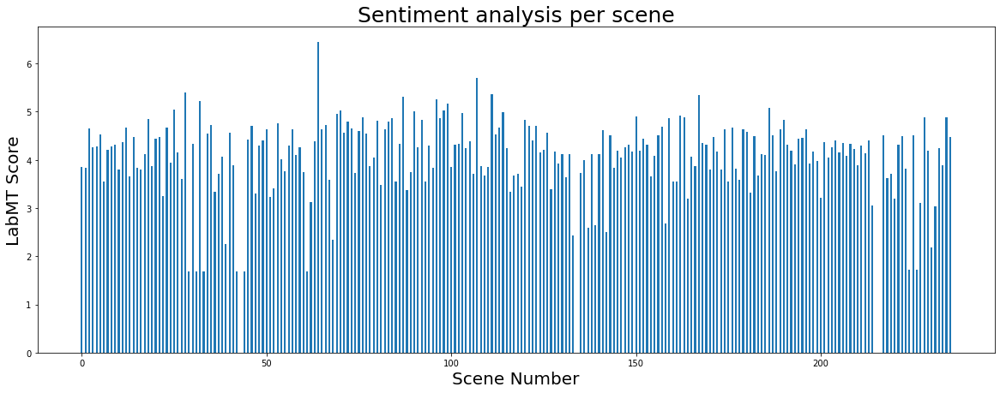

In [189]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_LabMT.values()), 0.5)
plt.title('Sentiment analysis per scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_per_Scene_Ep_III_LabMT.png", format="PNG")
plt.show()

#### Visualize sentiment per scene (VADER)

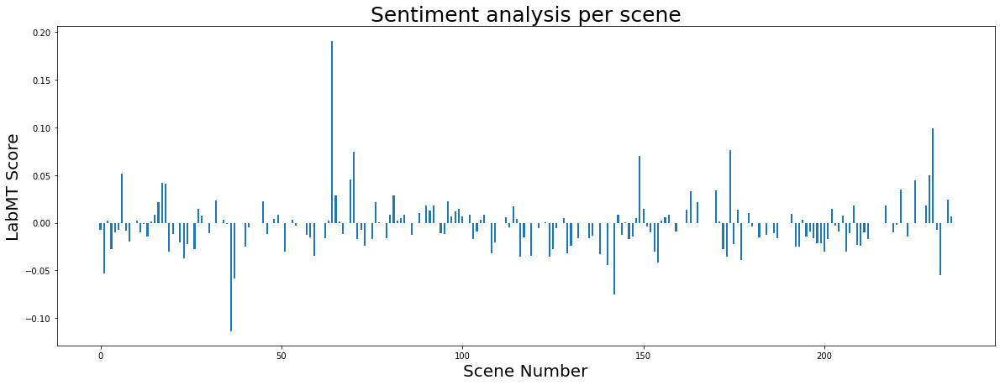

In [190]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_VADER.values()), 0.5)
plt.title('Sentiment analysis per scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_per_Scene_Ep_III_VADER.png", format="PNG")
plt.show()

#### Calculate the sentiment up until the scene

In [191]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    if scene_number == 0:
        corpus[scene_number] = scene 
    else:
        corpus[scene_number] = corpus[scene_number-1] + scene 
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Visualize sentiment per scene (LabMT)

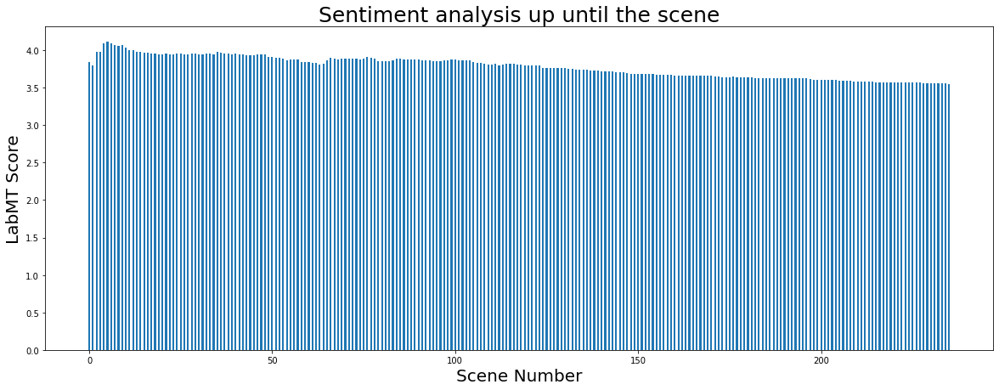

In [192]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_LabMT.values()), 0.5)
plt.title('Sentiment analysis up until the scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_until_Scene_Ep_III_LabMT.png", format="PNG")
plt.show()

#### Visualize sentiment per scene (VADER)

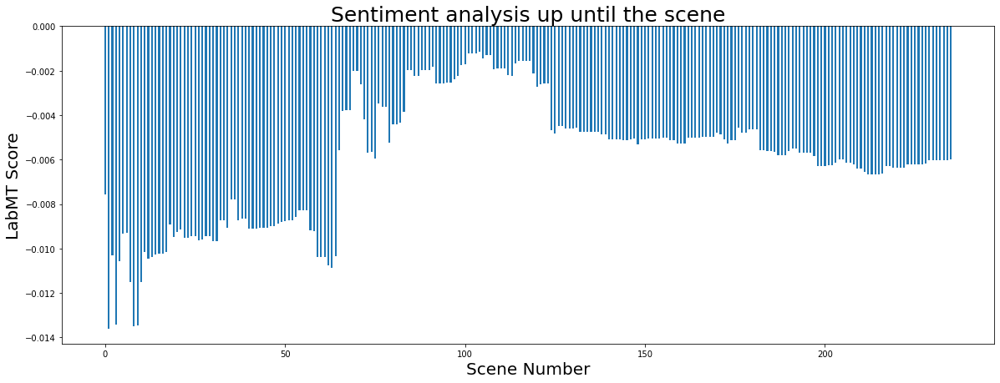

In [193]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_VADER.values()), 0.5)
plt.title('Sentiment analysis up until the scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_until_Scene_Ep_III_VADER.png", format="PNG")
plt.show()

#### Sentiment score of the whole movie

In [194]:
print('LabMT Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_LabMT[len(sentiment_dict_LabMT)-1]))
print('VADER Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_VADER[len(sentiment_dict_VADER)-1]))

LabMT Sentiment Score for the Movie: 3.54890
VADER Sentiment Score for the Movie: -0.00599


### Episode IV

#### Loading data

In [195]:
temp_data = data_scenes[data_scenes['Movie']=='Episode IV'].reset_index(drop=True)

#### Characters timeline

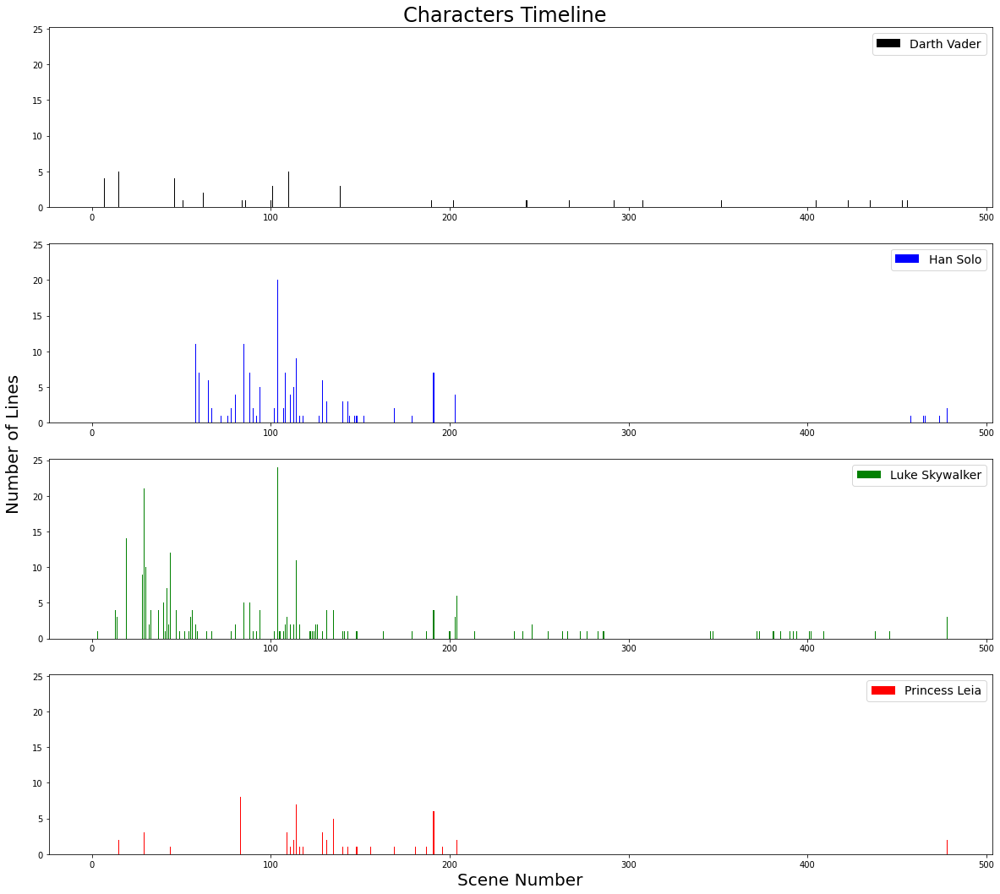

In [196]:
Darth_Vader, Han_Solo, Leia, Luke = [], [], [], []

for scene in range(len(temp_data['Scene_Characters'])):
    if temp_data['Scene_Characters'][scene] != None:
        Darth_Vader.append(temp_data['Scene_Characters'][scene].count('VADER'))
        Han_Solo.append(temp_data['Scene_Characters'][scene].count('HAN'))
        Leia.append(temp_data['Scene_Characters'][scene].count('LEIA'))
        Luke.append(temp_data['Scene_Characters'][scene].count('LUKE'))
    else:
        Darth_Vader.append(0)
        Han_Solo.append(0)
        Leia.append(0)
        Luke.append(0)
        
temp_characters = [Darth_Vader, Han_Solo, Luke, Leia]
labels = ['Darth Vader', 'Han Solo', 'Luke Skywalker', 'Princess Leia']
colors = ['Black', 'Blue', 'Green', 'Red']

fig = plt.figure(figsize=(20, 18))
X_axis = np.arange(len(temp_data))
for i, temp_char in enumerate(temp_characters):
    if i != 0:
        ax = fig.add_subplot(len(temp_characters), 1, i+1, sharex=temp_ax, sharey=temp_ax)
    else:
        ax = fig.add_subplot(len(temp_characters), 1, i+1)
    temp_ax = ax
    ax.bar(X_axis, temp_char, 0.5, label=labels[i], color=colors[i])
    ax.legend(loc='upper right', fontsize=14)

fig.suptitle("Characters Timeline", fontsize=24, y=0.9)    
plt.xlabel("Scene Number", fontsize=20)
fig.text(0.09, 0.5, 'Number of Lines', va='center', rotation='vertical', fontsize=20)
plt.savefig("Images/Plots/Char_Timeline_Ep_IV.png", format="PNG")
plt.show()

#### Create a list of all the word per scene

In [197]:
words_scene = []
for i, temp_scene in enumerate(temp_data['Scene_Dialogue']):
    string = ''
    if temp_scene != None:
        #temp_scene = temp_scene.reset_index(drop=True)
        for temp_temp_scene in temp_scene:
            if temp_temp_scene != None:
                string += ''.join([elem for elem in temp_temp_scene])
        words_scene.append(string)
    else:
        words_scene.append(temp_data['Scene_Description'][i][0])

#### Calculate the sentiment per scene

In [198]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    corpus[scene_number] = scene
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Visualize sentiment per scene (LabMT)

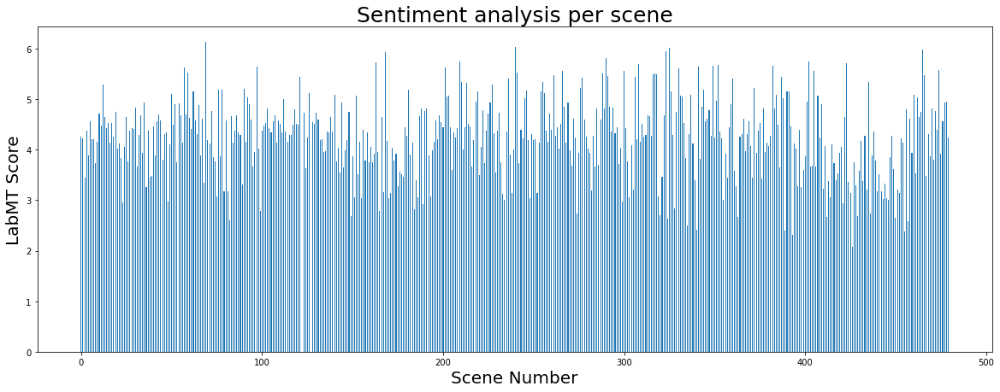

In [199]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_LabMT.values()), 0.5)
plt.title('Sentiment analysis per scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_per_Scene_Ep_IV_LabMT.png", format="PNG")
plt.show()

#### Visualize sentiment per scene (VADER)

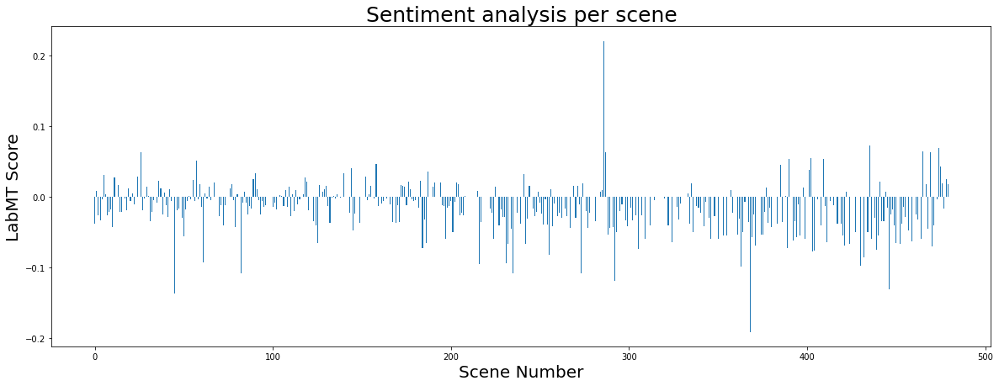

In [200]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_VADER.values()), 0.5)
plt.title('Sentiment analysis per scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_per_Scene_Ep_IV_VADER.png", format="PNG")
plt.show()

#### Calculate the sentiment up until the scene

In [201]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    if scene_number == 0:
        corpus[scene_number] = scene 
    else:
        corpus[scene_number] = corpus[scene_number-1] + scene 
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Visualize sentiment per scene (LabMT)

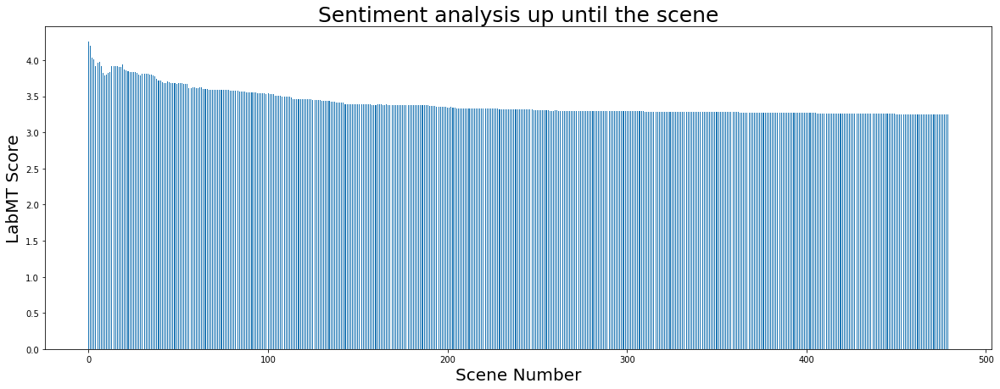

In [202]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_LabMT.values()), 0.5)
plt.title('Sentiment analysis up until the scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_until_Scene_Ep_IV_LabMT.png", format="PNG")
plt.show()

#### Visualize sentiment per scene (VADER)

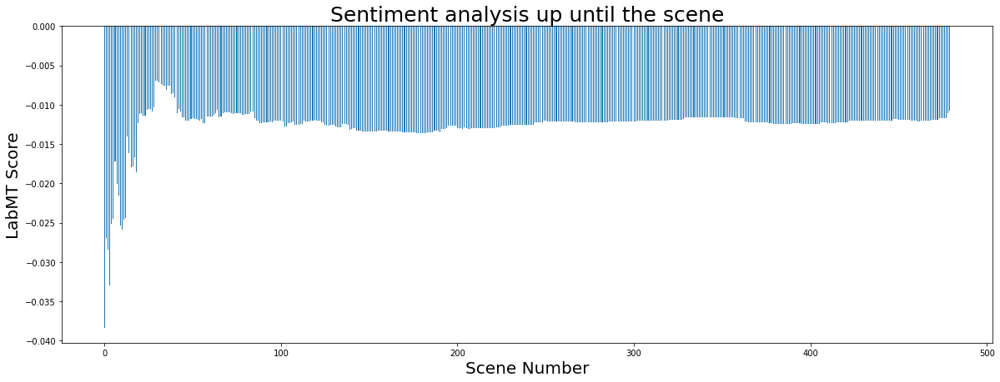

In [203]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_VADER.values()), 0.5)
plt.title('Sentiment analysis up until the scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_until_Scene_Ep_IV_VADER.png", format="PNG")
plt.show()

#### Sentiment score of the whole movie

In [204]:
print('LabMT Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_LabMT[len(sentiment_dict_LabMT)-1]))
print('VADER Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_VADER[len(sentiment_dict_VADER)-1]))

LabMT Sentiment Score for the Movie: 3.25061
VADER Sentiment Score for the Movie: -0.01076


### Episode V

#### Loading data

In [205]:
temp_data = data_scenes[data_scenes['Movie']=='Episode V'].reset_index(drop=True)

#### Characters timeline

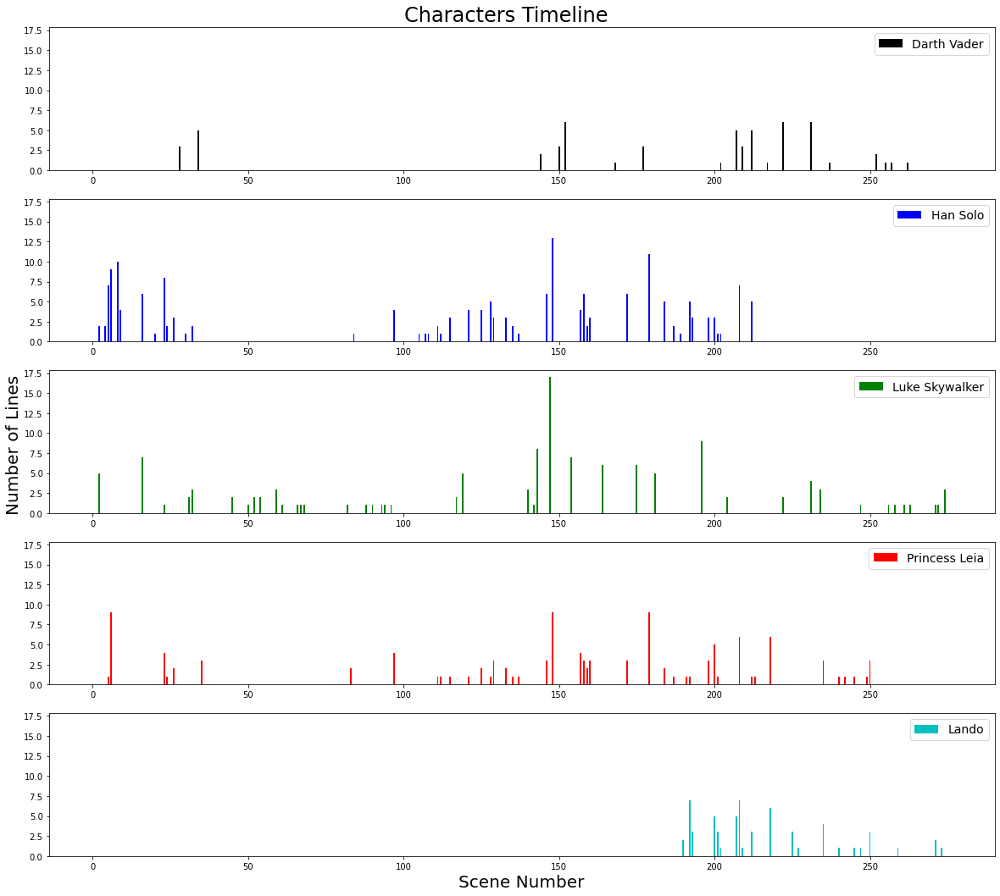

In [206]:
Darth_Vader, Han_Solo, Leia, Luke, Lando = [], [], [], [], []

for scene in range(len(temp_data['Scene_Characters'])):
    if temp_data['Scene_Characters'][scene] != None:
        Darth_Vader.append(temp_data['Scene_Characters'][scene].count('VADER'))
        Han_Solo.append(temp_data['Scene_Characters'][scene].count('HAN'))
        Leia.append(temp_data['Scene_Characters'][scene].count('LEIA'))
        Luke.append(temp_data['Scene_Characters'][scene].count('LUKE'))
        Lando.append(temp_data['Scene_Characters'][scene].count('LANDO'))
    else:
        Darth_Vader.append(0)
        Han_Solo.append(0)
        Leia.append(0)
        Luke.append(0)
        Lando.append(0)
        
temp_characters = [Darth_Vader, Han_Solo, Luke, Leia, Lando]
labels = ['Darth Vader', 'Han Solo', 'Luke Skywalker', 'Princess Leia', 'Lando']
colors = ['Black', 'Blue', 'Green', 'Red', 'c']

fig = plt.figure(figsize=(20, 18))
X_axis = np.arange(len(temp_data))
for i, temp_char in enumerate(temp_characters):
    if i != 0:
        ax = fig.add_subplot(len(temp_characters), 1, i+1, sharex=temp_ax, sharey=temp_ax)
    else:
        ax = fig.add_subplot(len(temp_characters), 1, i+1)
    temp_ax = ax
    ax.bar(X_axis, temp_char, 0.5, label=labels[i], color=colors[i])
    ax.legend(loc='upper right', fontsize=14)

fig.suptitle("Characters Timeline", fontsize=24, y=0.9)    
plt.xlabel("Scene Number", fontsize=20)
fig.text(0.09, 0.5, 'Number of Lines', va='center', rotation='vertical', fontsize=20)
plt.savefig("Images/Plots/Char_Timeline_Ep_V.png", format="PNG")
plt.show()

#### Create a list of all the word per scene

In [207]:
words_scene = []
for i, temp_scene in enumerate(temp_data['Scene_Dialogue']):
    string = ''
    if temp_scene != None:
        #temp_scene = temp_scene.reset_index(drop=True)
        for temp_temp_scene in temp_scene:
            if temp_temp_scene != None:
                string += ''.join([elem for elem in temp_temp_scene])
        words_scene.append(string)
    else:
        words_scene.append(temp_data['Scene_Description'][i][0])

#### Calculate the sentiment per scene

In [208]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    corpus[scene_number] = scene
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Visualize sentiment per scene (LabMT)

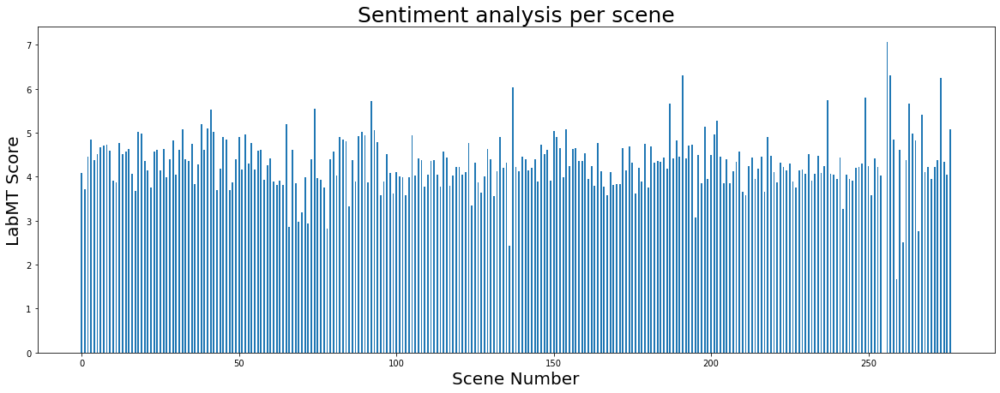

In [209]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_LabMT.values()), 0.5)
plt.title('Sentiment analysis per scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_per_Scene_Ep_V_LabMT.png", format="PNG")
plt.show()

#### Visualize sentiment per scene (VADER)

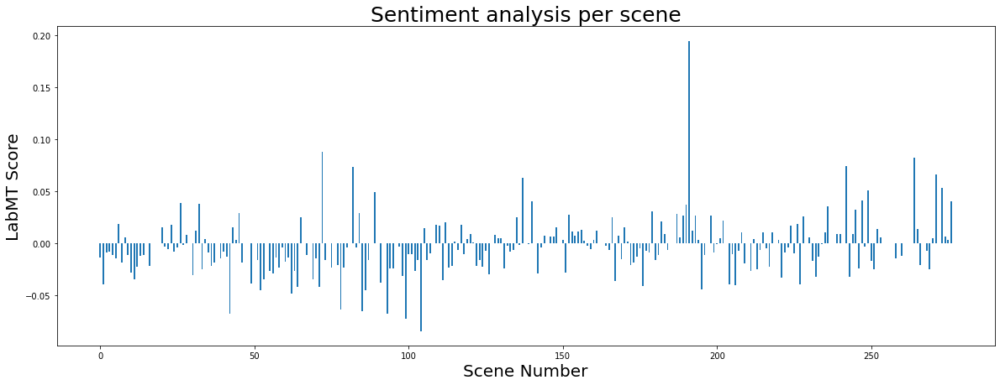

In [210]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_VADER.values()), 0.5)
plt.title('Sentiment analysis per scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_per_Scene_Ep_V_VADER.png", format="PNG")
plt.show()

#### Calculate the sentiment up until the scene

In [211]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    if scene_number == 0:
        corpus[scene_number] = scene 
    else:
        corpus[scene_number] = corpus[scene_number-1] + scene 
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Visualize sentiment per scene (LabMT)

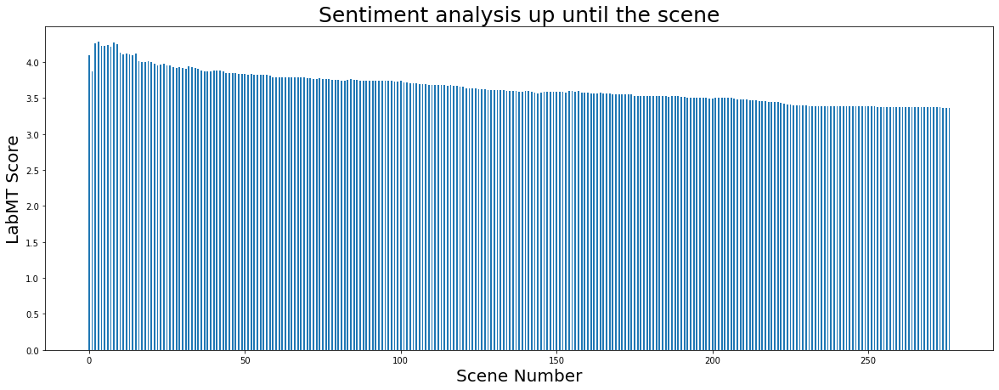

In [212]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_LabMT.values()), 0.5)
plt.title('Sentiment analysis up until the scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_until_Scene_Ep_V_LabMT.png", format="PNG")
plt.show()

#### Visualize sentiment per scene (VADER)

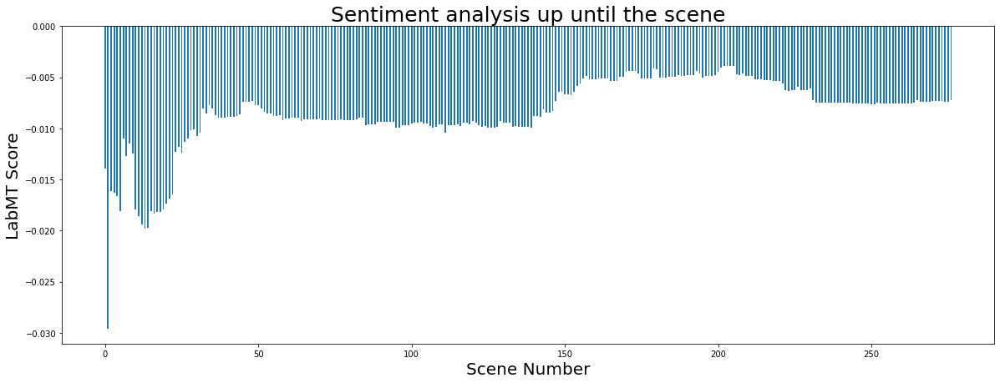

In [213]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_VADER.values()), 0.5)
plt.title('Sentiment analysis up until the scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_until_Scene_Ep_V_VADER.png", format="PNG")
plt.show()

#### Sentiment score of the whole movie

In [214]:
print('LabMT Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_LabMT[len(sentiment_dict_LabMT)-1]))
print('VADER Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_VADER[len(sentiment_dict_VADER)-1]))

LabMT Sentiment Score for the Movie: 3.36432
VADER Sentiment Score for the Movie: -0.00725


### Episode VI

#### Loading data

In [215]:
temp_data = data_scenes[data_scenes['Movie']=='Episode VI'].reset_index(drop=True)

#### Characters timeline

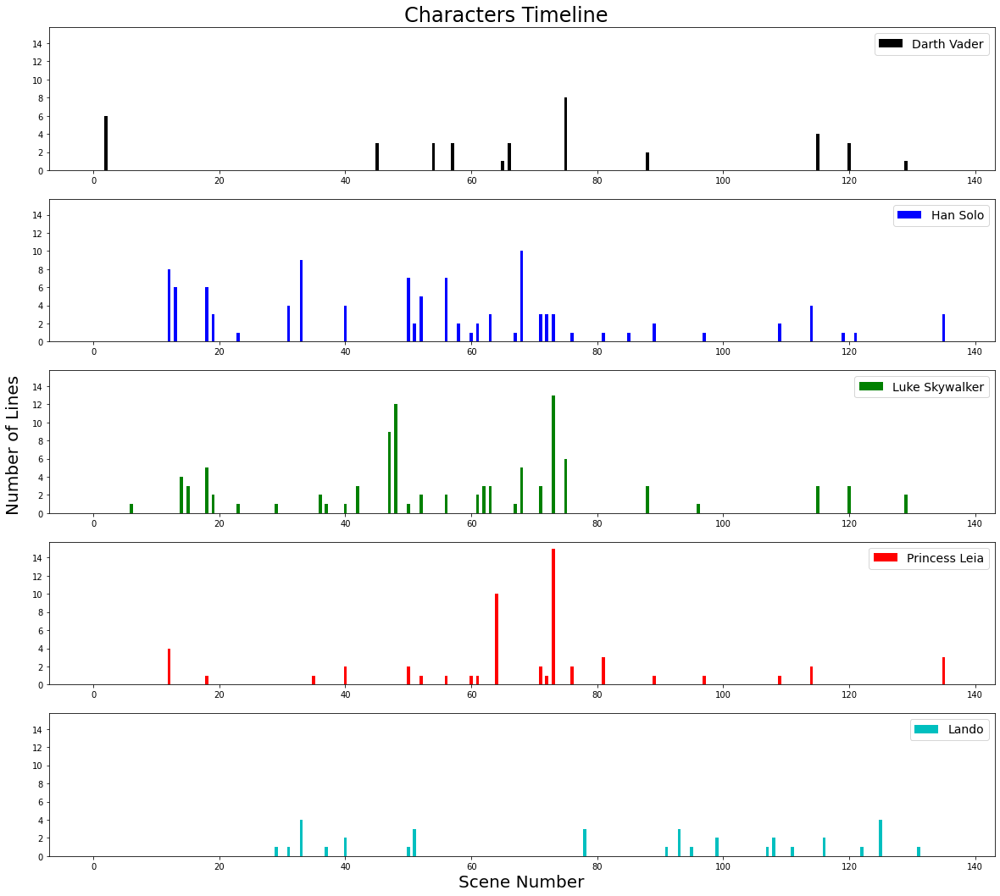

In [216]:
Darth_Vader, Han_Solo, Leia, Luke, Lando = [], [], [], [], []

for scene in range(len(temp_data['Scene_Characters'])):
    if temp_data['Scene_Characters'][scene] != None:
        Darth_Vader.append(temp_data['Scene_Characters'][scene].count('VADER'))
        Han_Solo.append(temp_data['Scene_Characters'][scene].count('HAN'))
        Leia.append(temp_data['Scene_Characters'][scene].count('LEIA'))
        Luke.append(temp_data['Scene_Characters'][scene].count('LUKE'))
        Lando.append(temp_data['Scene_Characters'][scene].count('LANDO'))
    else:
        Darth_Vader.append(0)
        Han_Solo.append(0)
        Leia.append(0)
        Luke.append(0)
        Lando.append(0)
        
temp_characters = [Darth_Vader, Han_Solo, Luke, Leia, Lando]
labels = ['Darth Vader', 'Han Solo', 'Luke Skywalker', 'Princess Leia', 'Lando']
colors = ['Black', 'Blue', 'Green', 'Red', 'c']

fig = plt.figure(figsize=(20, 18))
X_axis = np.arange(len(temp_data))
for i, temp_char in enumerate(temp_characters):
    if i != 0:
        ax = fig.add_subplot(len(temp_characters), 1, i+1, sharex=temp_ax, sharey=temp_ax)
    else:
        ax = fig.add_subplot(len(temp_characters), 1, i+1)
    temp_ax = ax
    ax.bar(X_axis, temp_char, 0.5, label=labels[i], color=colors[i])
    ax.legend(loc='upper right', fontsize=14)

fig.suptitle("Characters Timeline", fontsize=24, y=0.9)    
plt.xlabel("Scene Number", fontsize=20)
fig.text(0.09, 0.5, 'Number of Lines', va='center', rotation='vertical', fontsize=20)
plt.savefig("Images/Plots/Char_Timeline_Ep_VI.png", format="PNG")
plt.show()

#### Create a list of all the word per scene

In [217]:
words_scene = []
for i, temp_scene in enumerate(temp_data['Scene_Dialogue']):
    string = ''
    if temp_scene != None:
        #temp_scene = temp_scene.reset_index(drop=True)
        for temp_temp_scene in temp_scene:
            if temp_temp_scene != None:
                string += ''.join([elem for elem in temp_temp_scene])
        words_scene.append(string)
    else:
        words_scene.append(temp_data['Scene_Description'][i][0])

#### Calculate the sentiment per scene

In [218]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    corpus[scene_number] = scene
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

/home/chrypapa/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/chrypapa/.local/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


#### Visualize sentiment per scene (LabMT)

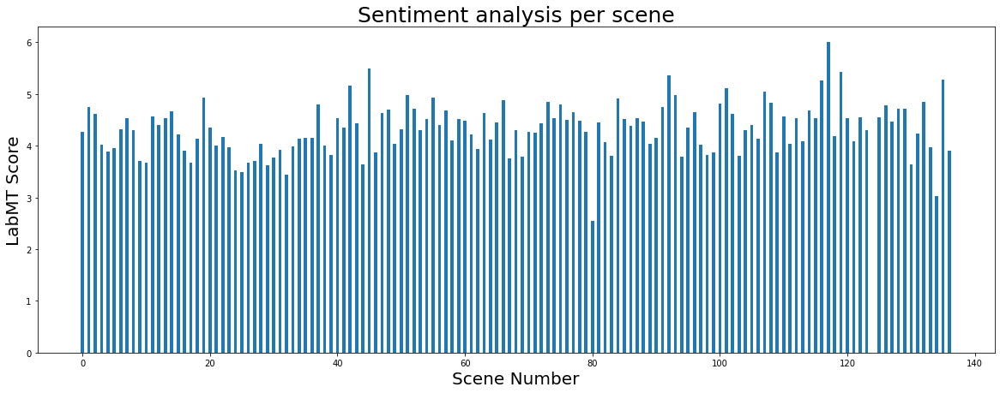

In [219]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_LabMT.values()), 0.5)
plt.title('Sentiment analysis per scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_per_Scene_Ep_VI_LabMT.png", format="PNG")
plt.show()

#### Visualize sentiment per scene (VADER)

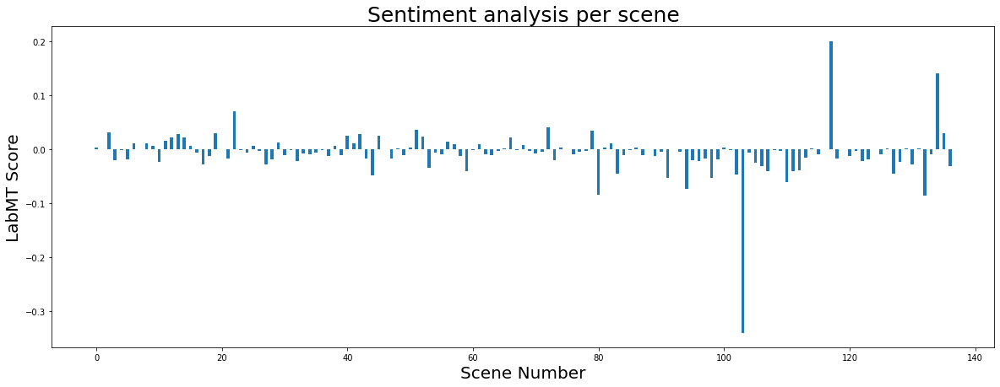

In [220]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_VADER.values()), 0.5)
plt.title('Sentiment analysis per scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_per_Scene_Ep_VI_VADER.png", format="PNG")
plt.show()

#### Calculate the sentiment up until the scene

In [221]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    if scene_number == 0:
        corpus[scene_number] = scene 
    else:
        corpus[scene_number] = corpus[scene_number-1] + scene 
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Visualize sentiment per scene (LabMT)

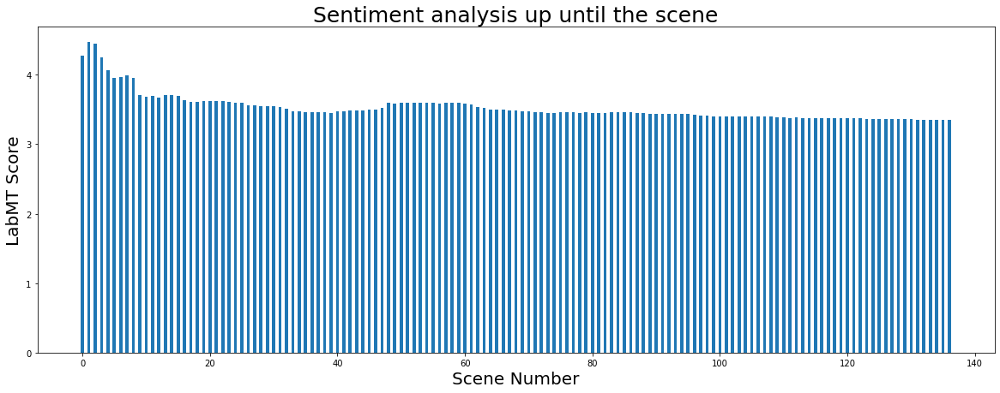

In [222]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_LabMT.values()), 0.5)
plt.title('Sentiment analysis up until the scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_until_Scene_Ep_VI_LabMT.png", format="PNG")
plt.show()

#### Visualize sentiment per scene (VADER)

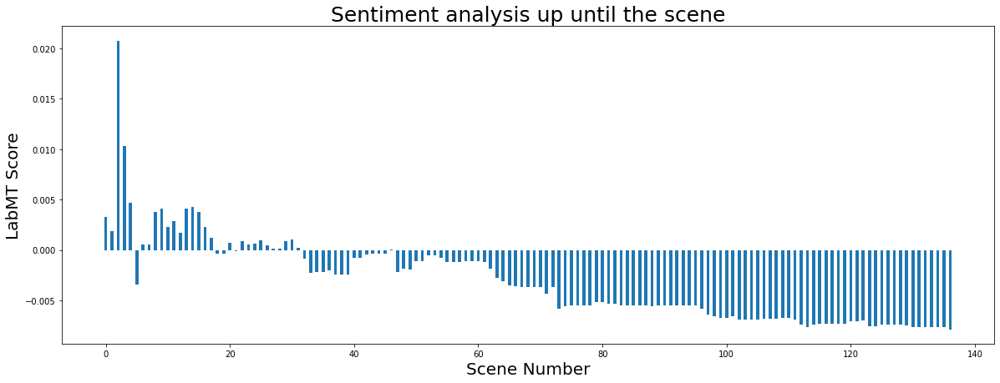

In [223]:
plt.figure(figsize=(20, 7))
plt.bar(X_axis, list(sentiment_dict_VADER.values()), 0.5)
plt.title('Sentiment analysis up until the scene', fontsize=25)
plt.xlabel("Scene Number", fontsize=20)
plt.ylabel("LabMT Score", fontsize=20)
plt.savefig("Images/Plots/SA_until_Scene_Ep_VI_VADER.png", format="PNG")
plt.show()

#### Sentiment score of the whole movie

In [224]:
print('LabMT Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_LabMT[len(sentiment_dict_LabMT)-1]))
print('VADER Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_VADER[len(sentiment_dict_VADER)-1]))

LabMT Sentiment Score for the Movie: 3.35429
VADER Sentiment Score for the Movie: -0.00785


### First Trilogy

#### Loading data

In [225]:
temp_data = data_scenes[(data_scenes['Movie']=='Episode I') | (data_scenes['Movie']=='Episode II') | (data_scenes['Movie']=='Episode III')].reset_index(drop=True)

#### Create a list of all the word per scene

In [226]:
words_scene = []
for i, temp_scene in enumerate(temp_data['Scene_Dialogue']):
    string = ''
    if temp_scene != None:
        #temp_scene = temp_scene.reset_index(drop=True)
        for temp_temp_scene in temp_scene:
            if temp_temp_scene != None:
                string += ''.join([elem for elem in temp_temp_scene])
        words_scene.append(string)
    else:
        words_scene.append(temp_data['Scene_Description'][i][0])

#### Calculate the sentiment up until the scene

In [227]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    if scene_number == 0:
        corpus[scene_number] = scene 
    else:
        corpus[scene_number] = corpus[scene_number-1] + scene 
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Sentiment score of the first trilogy

In [228]:
print('LabMT Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_LabMT[len(sentiment_dict_LabMT)-1]))
print('VADER Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_VADER[len(sentiment_dict_VADER)-1]))

LabMT Sentiment Score for the Movie: 2.86599
VADER Sentiment Score for the Movie: -0.00301


### Second Trilogy

#### Loading data

In [229]:
temp_data = data_scenes[(data_scenes['Movie']=='Episode IV') | (data_scenes['Movie']=='Episode V') | (data_scenes['Movie']=='Episode VI')].reset_index(drop=True)

#### Create a list of all the word per scene

In [230]:
words_scene = []
for i, temp_scene in enumerate(temp_data['Scene_Dialogue']):
    string = ''
    if temp_scene != None:
        #temp_scene = temp_scene.reset_index(drop=True)
        for temp_temp_scene in temp_scene:
            if temp_temp_scene != None:
                string += ''.join([elem for elem in temp_temp_scene])
        words_scene.append(string)
    else:
        words_scene.append(temp_data['Scene_Description'][i][0])

#### Calculate the sentiment up until the scene

In [231]:
corpus = {}
tokens = {}
for scene_number, scene in enumerate(words_scene):
    if scene_number == 0:
        corpus[scene_number] = scene 
    else:
        corpus[scene_number] = corpus[scene_number-1] + scene 
for k, v in corpus.items():
    tokens[k] = list(set([w.lower() for w in word_tokenize(corpus[k]) if w.isalpha()]))
sentiment_dict_LabMT = {}
sentiment_dict_VADER = {}
for k,v in tokens.items():
    sentiment_dict_LabMT[k] = sentiment_function(tokens[k], LabMT_dict)
    sentiment_dict_VADER[k] = compute_sentiment_VADER(tokens[k])

#### Sentiment score of the second trilogy

In [232]:
print('LabMT Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_LabMT[len(sentiment_dict_LabMT)-1]))
print('VADER Sentiment Score for the Movie: {:.5f}'.format(sentiment_dict_VADER[len(sentiment_dict_VADER)-1]))

LabMT Sentiment Score for the Movie: 2.83683
VADER Sentiment Score for the Movie: -0.00733


## Word Clouds

The last step of our analysis was to plot the wordclouds for specific characters from every episode. Through that technique, we wanted to see if it would be possible to maybe get a better understanding of the characters or even understand what kind of a person a character is. To plot the wordclouds, we calculated TC for these characters, idf for every character of the movie and finally the TC-IDF. Then we just plotted the wordclouds.

### Episode I

#### Loading data

In [233]:
temp_lines = data_lines[data_lines['Movie']=='Episode I']

#### Create token directory

In [234]:
tk = WordPunctTokenizer()
characters = list(temp_lines['Character'].unique())
for char in characters:
    temp_df = temp_lines[temp_lines['Character']==char].reset_index(drop=True)
    string = ''
    for i in range(len(temp_df)):
        string+=temp_df['Line'][i]
    tokens = tk.tokenize(string)
    tokens = [w.lower() for w in tokens]
    stop_words = stopwords.words('english')
    punctuation = list(punctuation)
    tokens = [token for token in tokens if token not in stop_words and token not in punctuation]
    tokens = [token for token in tokens if token != '...' and char.lower() not in token]
    wnl = nltk.WordNetLemmatizer()
    tokens = [wnl.lemmatize(t) for t in tokens]
    with open('Token_Char/Episode_I/'+char+'.txt', 'w') as f:
        for item in tokens:
            f.write("%s\n" % item)

#### Calculate TC

In [235]:
tc = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_I')
characters = ['QUIGON', 'ANAKIN', 'OBIWAN', 'PADME', 'PALPATINE']
for char in characters:
    wordlist = nltk.corpus.PlaintextCorpusReader(root, char + ".txt")
    char_text = nltk.Text(wordlist.words())
    temp_tc = {}
    for key, value in FreqDist(char_text).items():
        temp_tc[key] = value 
    tc[char] = temp_tc

#### Calculate IDF

In [236]:
idf = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_I')
char = [x + '.txt' for x in temp_lines['Character'].unique()]

wordlist = nltk.corpus.PlaintextCorpusReader(root, char)
collection = nltk.TextCollection(wordlist)
for word in np.unique(wordlist.words()):
    idf[word] = collection.idf(word)

#### Calculate TC-IDF

In [237]:
tc_idf = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_I')
characters = ['QUIGON', 'ANAKIN', 'OBIWAN', 'PADME', 'PALPATINE']
for char in characters:
    temp_tc = tc[char]
    tc_idf_temp = {}
    for (word, value) in temp_tc.items():
        tc_idf_temp[word] = value*idf[word]
    tc_idf[char] = tc_idf_temp

#### Print word clouds

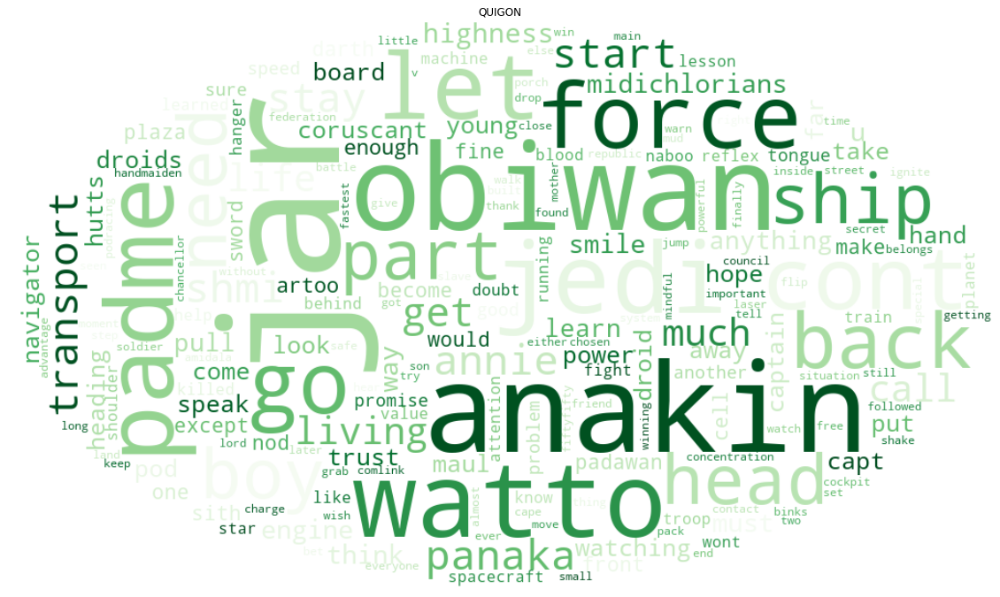

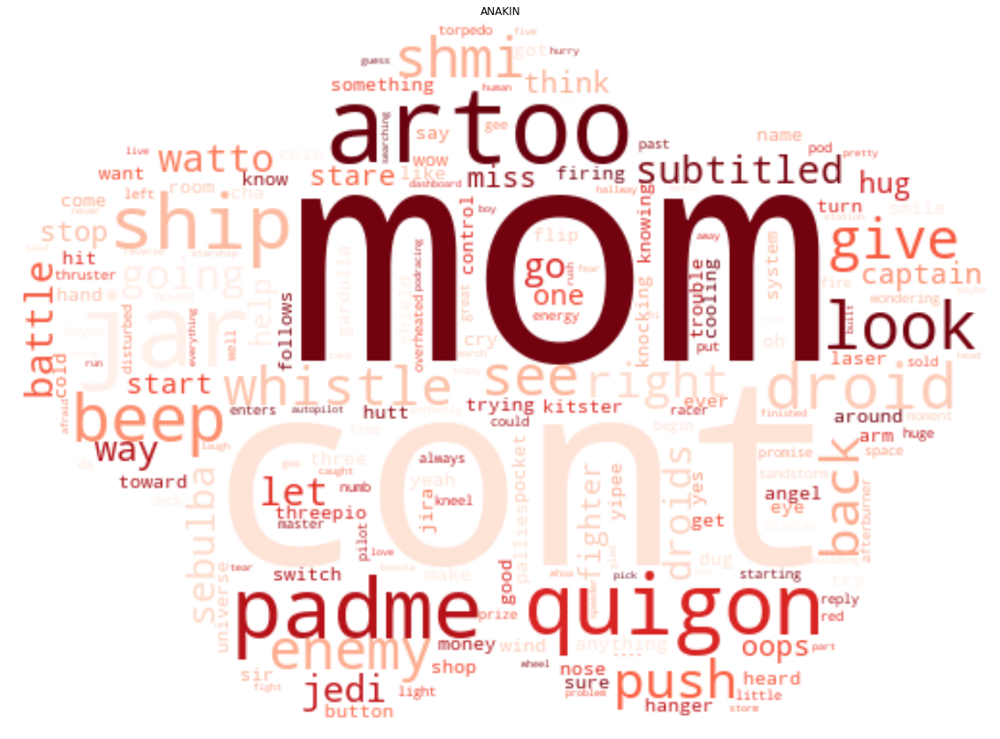

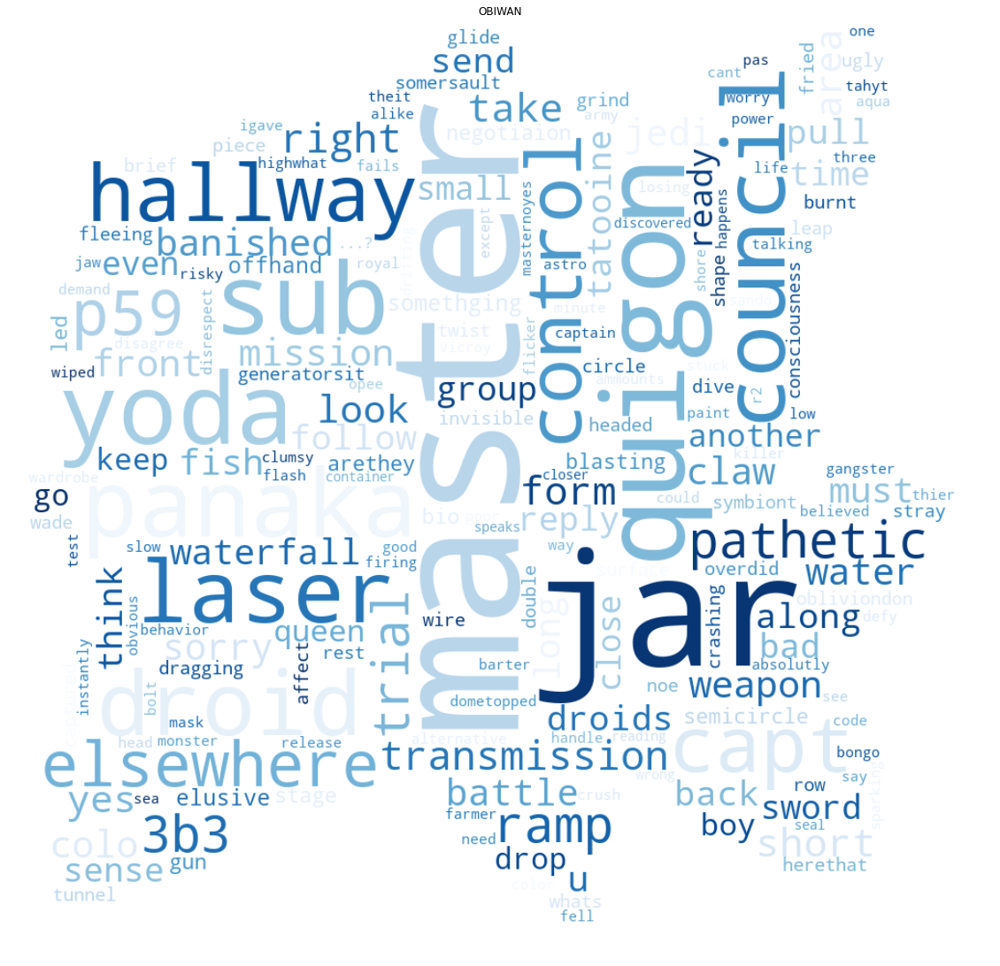

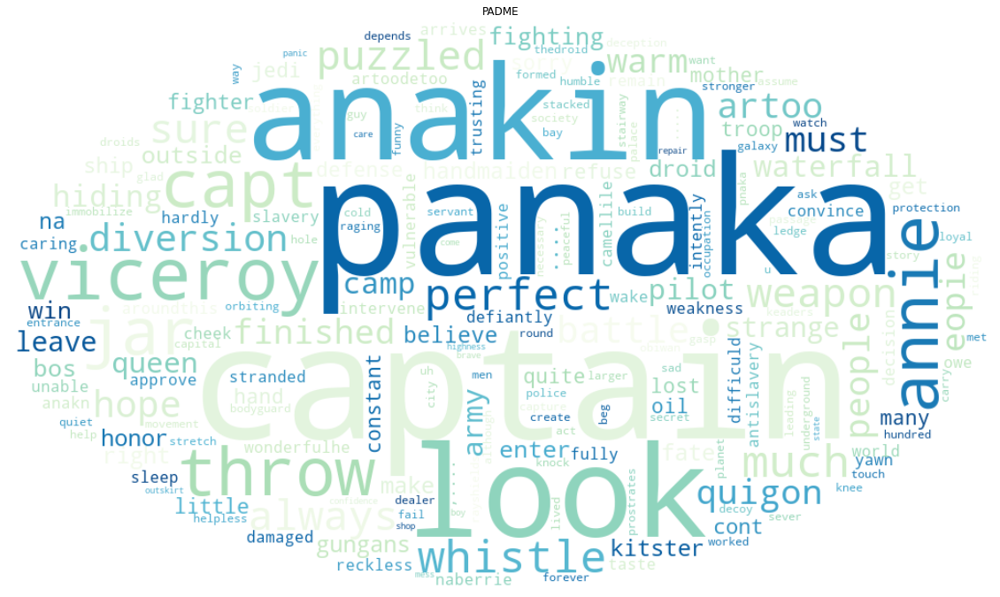

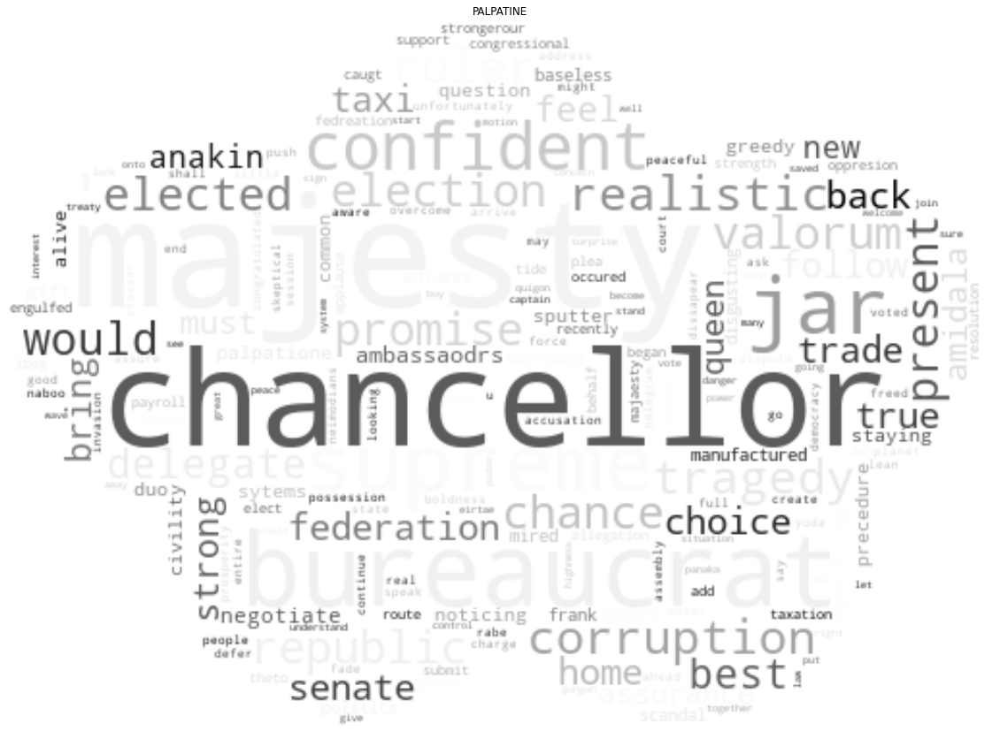

In [238]:
colors = ['Greens', 'Reds', 'Blues', 'GnBu', 'Greys']
list_masks = ['Files/Wordcloud/CIRCLE.png', 'Files/Wordcloud/CLOUD2.png',
              'Files/Wordcloud/LEAF.jpg', 'Files/Wordcloud/CIRCLE.png',
              'Files/Wordcloud/CLOUD2.png']

for i, char in enumerate(characters):
    plt.figure(figsize=[20, 20])
    masks = np.array(Image.open(list_masks[i]))
    wordcloud_race = WordCloud(colormap= colors[i], background_color='white', mask=masks)
    wordcloud_race.generate_from_frequencies(tc_idf[char])
    #plt.subplot(3, 2, i+1)
    plt.imshow(wordcloud_race, interpolation='bilinear')
    plt.axis("off")
    plt.title(char)
    plt.savefig('./Images/Wordclouds/Episode_I/'+char+'.png')
    plt.show()

### Episode II

#### Loading data

In [239]:
temp_lines = data_lines[data_lines['Movie']=='Episode II']

#### Create token directory

In [240]:
tk = WordPunctTokenizer()
characters = list(temp_lines['Character'].unique())
for char in characters:
    temp_df = temp_lines[temp_lines['Character']==char].reset_index(drop=True)
    string = ''
    for i in range(len(temp_df)):
        string+=temp_df['Line'][i]
    tokens = tk.tokenize(string)
    tokens = [w.lower() for w in tokens]
    stop_words = stopwords.words('english')
    punctuation = list(punctuation)
    tokens = [token for token in tokens if token not in stop_words and token not in punctuation]
    tokens = [token for token in tokens if token != '...' and char.lower() not in token]
    wnl = nltk.WordNetLemmatizer()
    tokens = [wnl.lemmatize(t) for t in tokens]
    with open('Token_Char/Episode_II/'+char+'.txt', 'w') as f:
        for item in tokens:
            f.write("%s\n" % item)

#### Calculate TC

In [241]:
tc = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_II')
characters = ['YODA', 'ANAKIN', 'OBIWAN', 'PADME', 'PALPATINE']
for char in characters:
    wordlist = nltk.corpus.PlaintextCorpusReader(root, char + ".txt")
    char_text = nltk.Text(wordlist.words())
    temp_tc = {}
    for key, value in FreqDist(char_text).items():
        temp_tc[key] = value 
    tc[char] = temp_tc

#### Calculate IDF

In [242]:
idf = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_II')
char = [x + '.txt' for x in temp_lines['Character'].unique()]

wordlist = nltk.corpus.PlaintextCorpusReader(root, char)
collection = nltk.TextCollection(wordlist)
for word in np.unique(wordlist.words()):
    idf[word] = collection.idf(word)

#### Calculate TC-IDF

In [243]:
tc_idf = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_II')
characters = ['YODA', 'ANAKIN', 'OBIWAN', 'PADME', 'PALPATINE']
for char in characters:
    temp_tc = tc[char]
    tc_idf_temp = {}
    for (word, value) in temp_tc.items():
        tc_idf_temp[word] = value*idf[word]
    tc_idf[char] = tc_idf_temp

#### Print word clouds

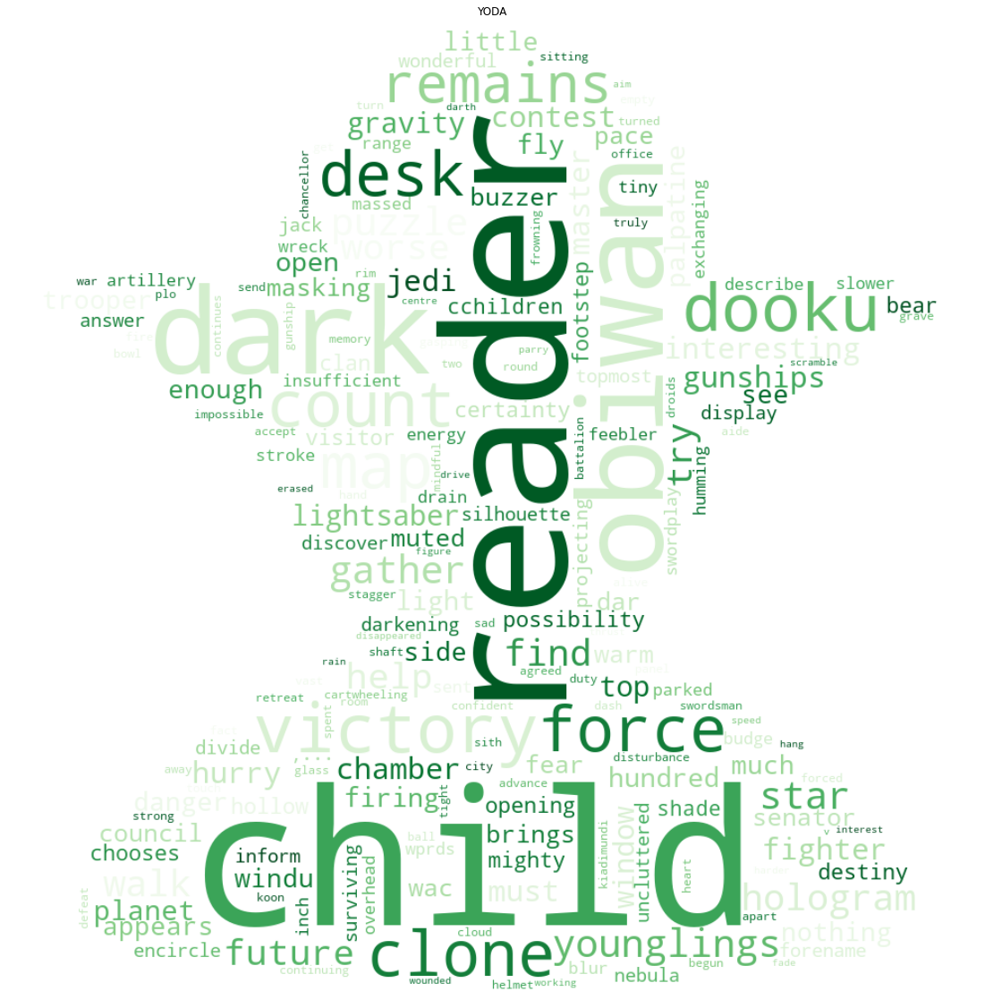

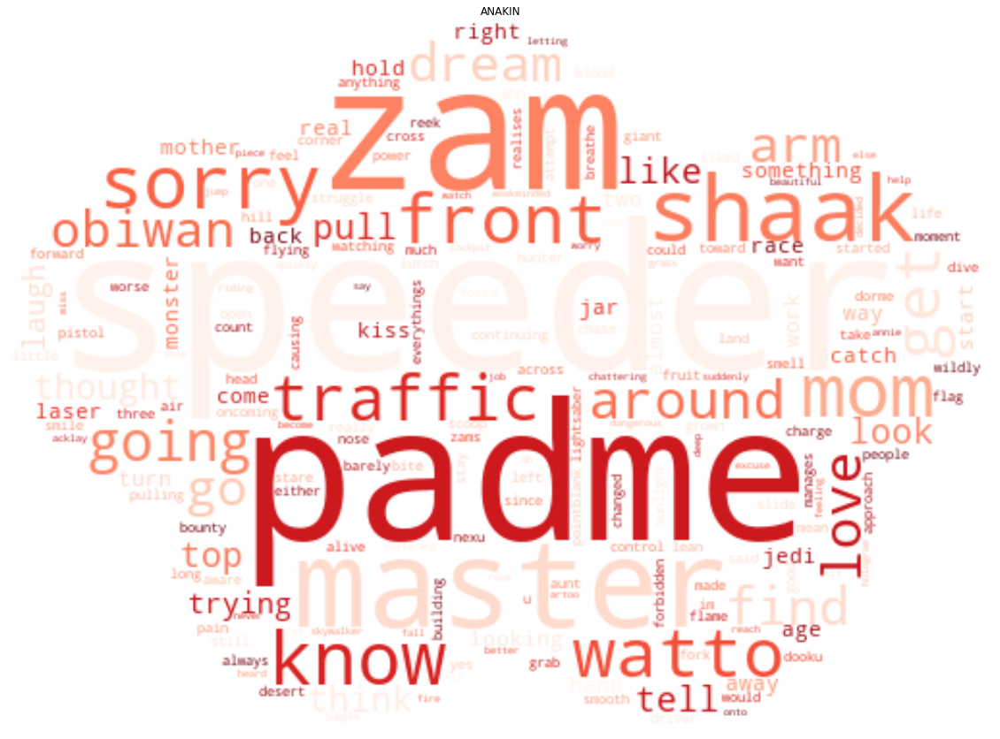

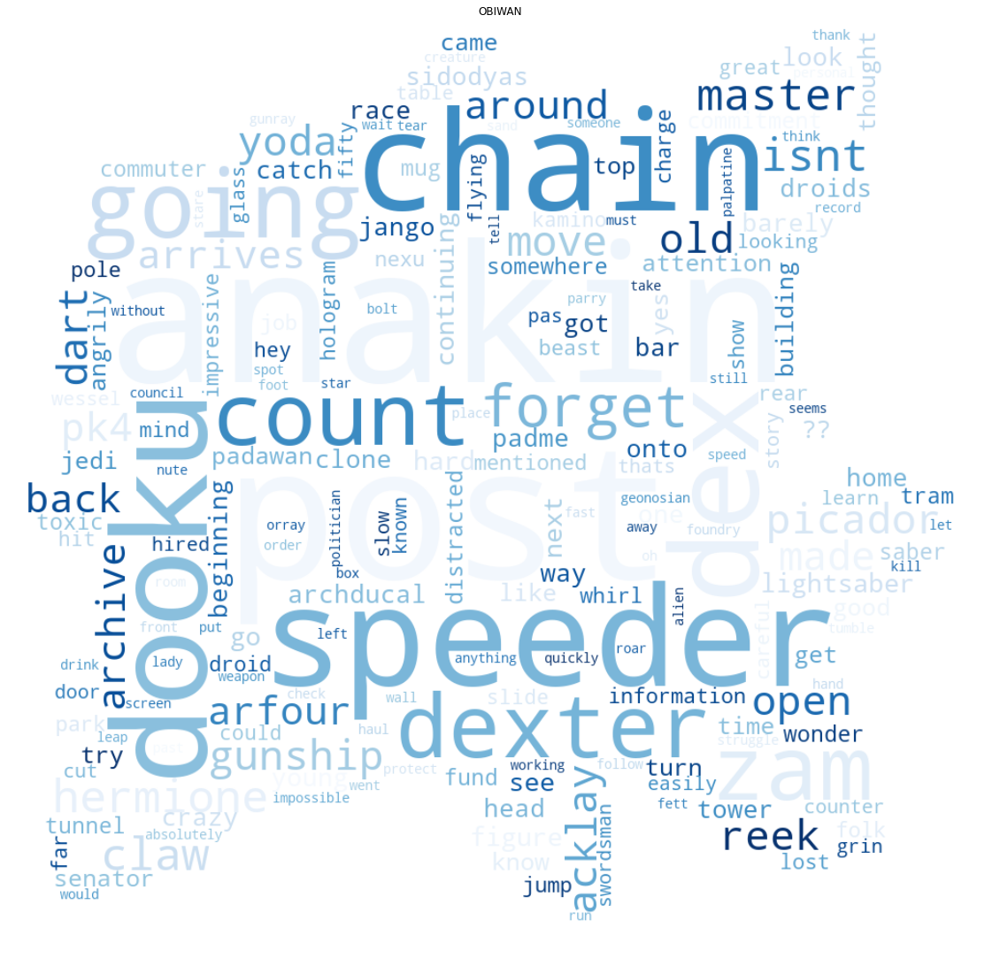

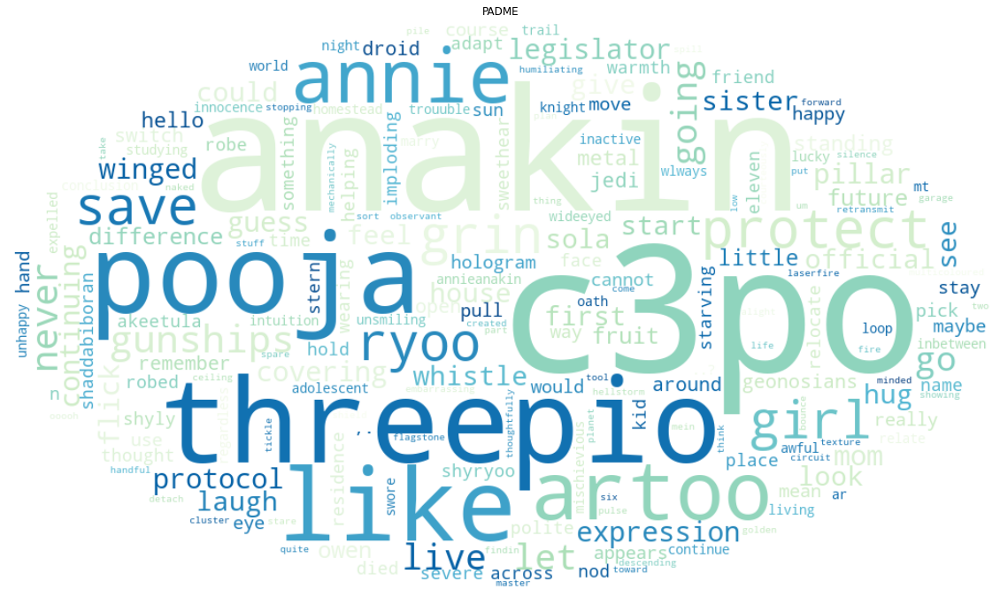

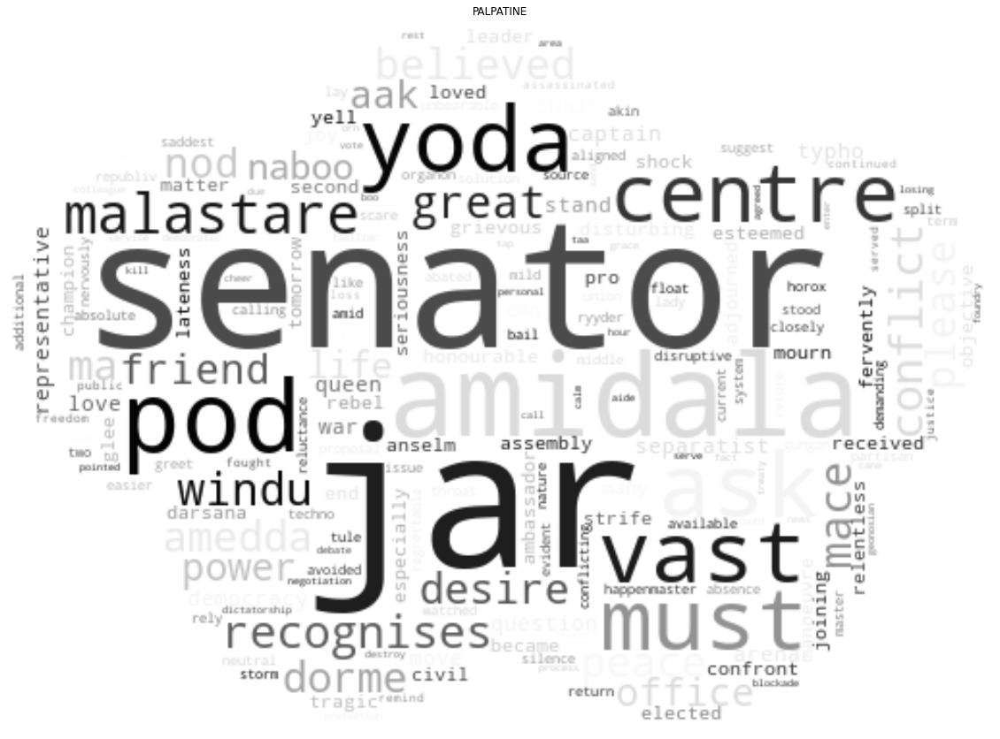

In [244]:
colors = ['Greens', 'Reds', 'Blues', 'GnBu', 'Greys']
list_masks = ['Files/Wordcloud/YODA.png', 'Files/Wordcloud/CLOUD2.png',
              'Files/Wordcloud/LEAF.jpg', 'Files/Wordcloud/CIRCLE.png',
              'Files/Wordcloud/CLOUD2.png']

for i, char in enumerate(characters):
    plt.figure(figsize=[20, 20])
    masks = np.array(Image.open(list_masks[i]))
    wordcloud_race = WordCloud(colormap= colors[i], background_color='white', mask=masks)
    wordcloud_race.generate_from_frequencies(tc_idf[char])
    #plt.subplot(3, 2, i+1)
    plt.imshow(wordcloud_race, interpolation='bilinear')
    plt.axis("off")
    plt.title(char)
    plt.savefig('./Images/Wordclouds/Episode_II/'+char+'.png')
    plt.show()

### Episode III

#### Loading data

In [245]:
temp_lines = data_lines[data_lines['Movie']=='Episode III']

#### Create token directory

In [246]:
tk = WordPunctTokenizer()
characters = list(temp_lines['Character'].unique())
for char in characters:
    temp_df = temp_lines[temp_lines['Character']==char].reset_index(drop=True)
    string = ''
    for i in range(len(temp_df)):
        string+=temp_df['Line'][i]
    tokens = tk.tokenize(string)
    tokens = [w.lower() for w in tokens]
    stop_words = stopwords.words('english')
    punctuation = list(punctuation)
    tokens = [token for token in tokens if token not in stop_words and token not in punctuation]
    tokens = [token for token in tokens if token != '...' and char.lower() not in token]
    wnl = nltk.WordNetLemmatizer()
    tokens = [wnl.lemmatize(t) for t in tokens]
    with open('Token_Char/Episode_III/'+char+'.txt', 'w') as f:
        for item in tokens:
            f.write("%s\n" % item)

#### Calculate TC

In [247]:
tc = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_III')
characters = ['YODA', 'ANAKIN', 'OBIWAN', 'PADME', 'PALPATINE']
for char in characters:
    wordlist = nltk.corpus.PlaintextCorpusReader(root, char + ".txt")
    char_text = nltk.Text(wordlist.words())
    temp_tc = {}
    for key, value in FreqDist(char_text).items():
        temp_tc[key] = value 
    tc[char] = temp_tc

#### Calculate IDF

In [248]:
idf = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_III')
char = [x + '.txt' for x in temp_lines['Character'].unique()]

wordlist = nltk.corpus.PlaintextCorpusReader(root, char)
collection = nltk.TextCollection(wordlist)
for word in np.unique(wordlist.words()):
    idf[word] = collection.idf(word)

#### Calculate TC-IDF

In [249]:
tc_idf = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_III')
characters = ['YODA', 'ANAKIN', 'OBIWAN', 'PADME', 'PALPATINE']
for char in characters:
    temp_tc = tc[char]
    tc_idf_temp = {}
    for (word, value) in temp_tc.items():
        tc_idf_temp[word] = value*idf[word]
    tc_idf[char] = tc_idf_temp

#### Print word clouds

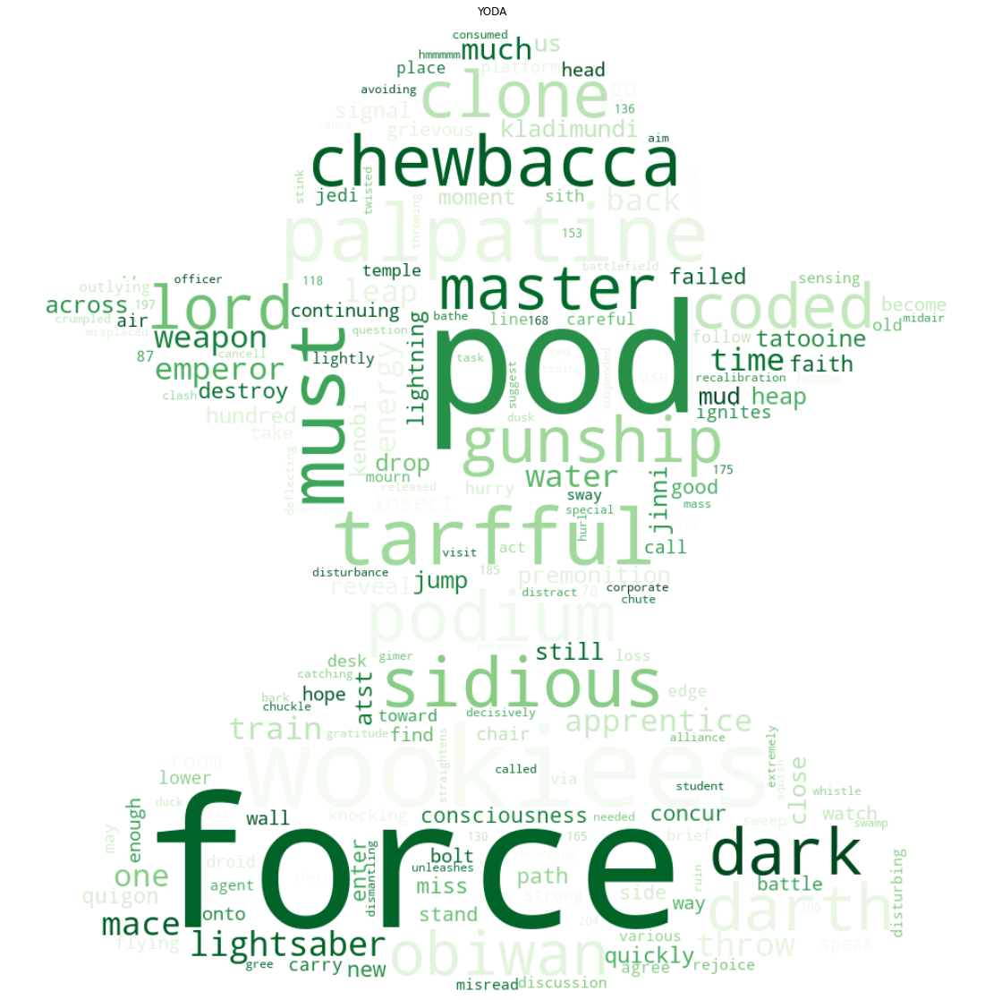

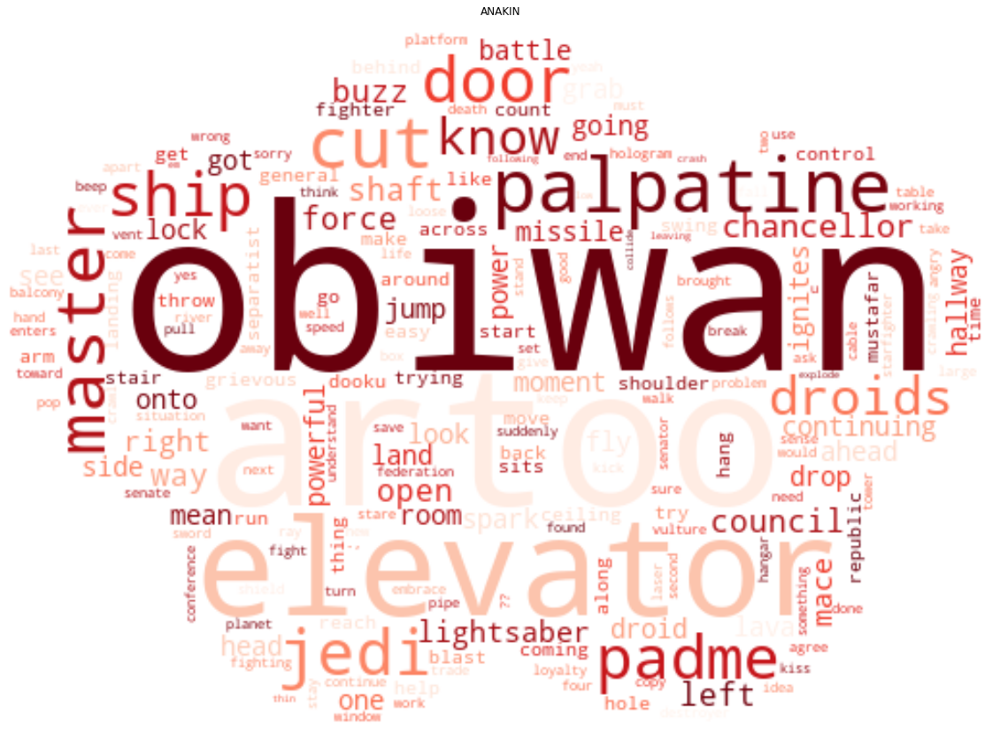

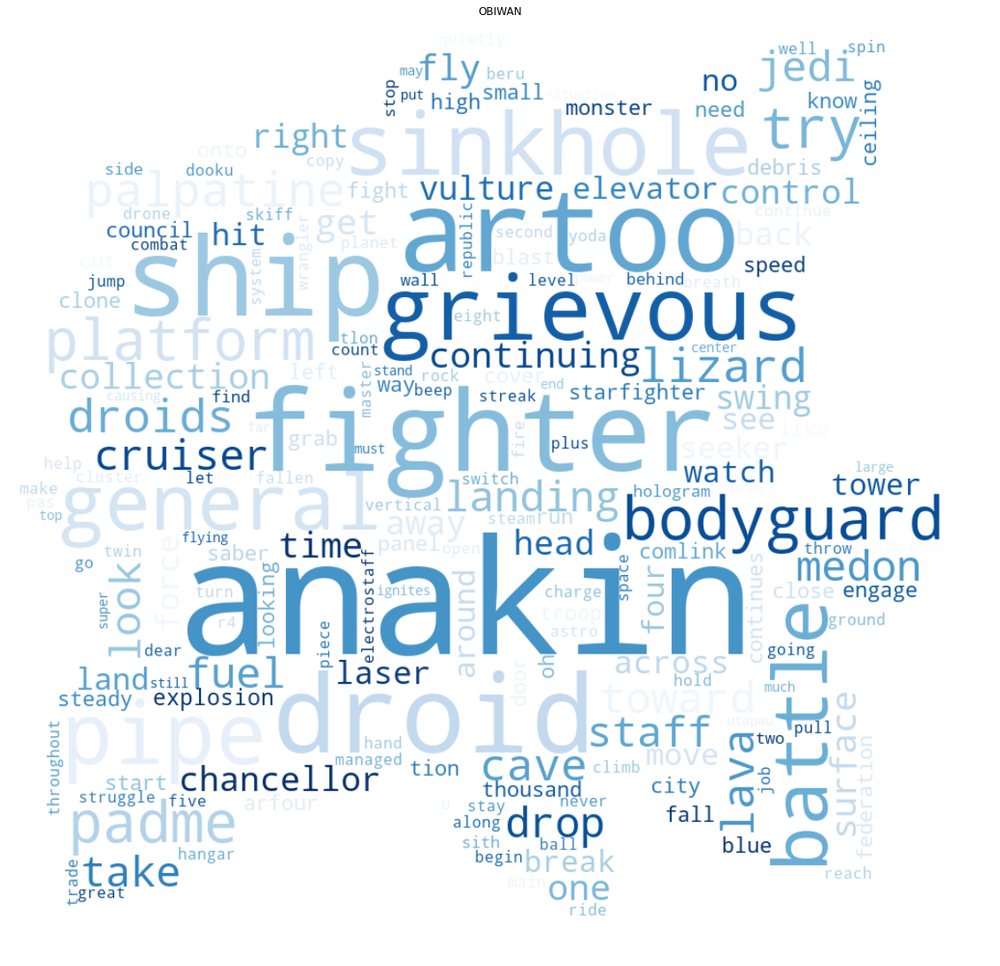

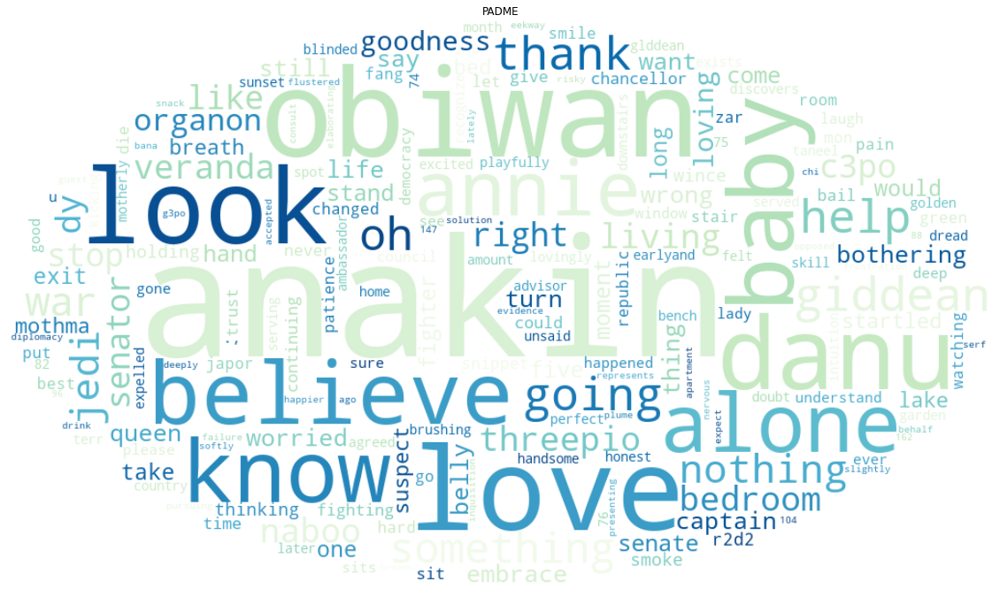

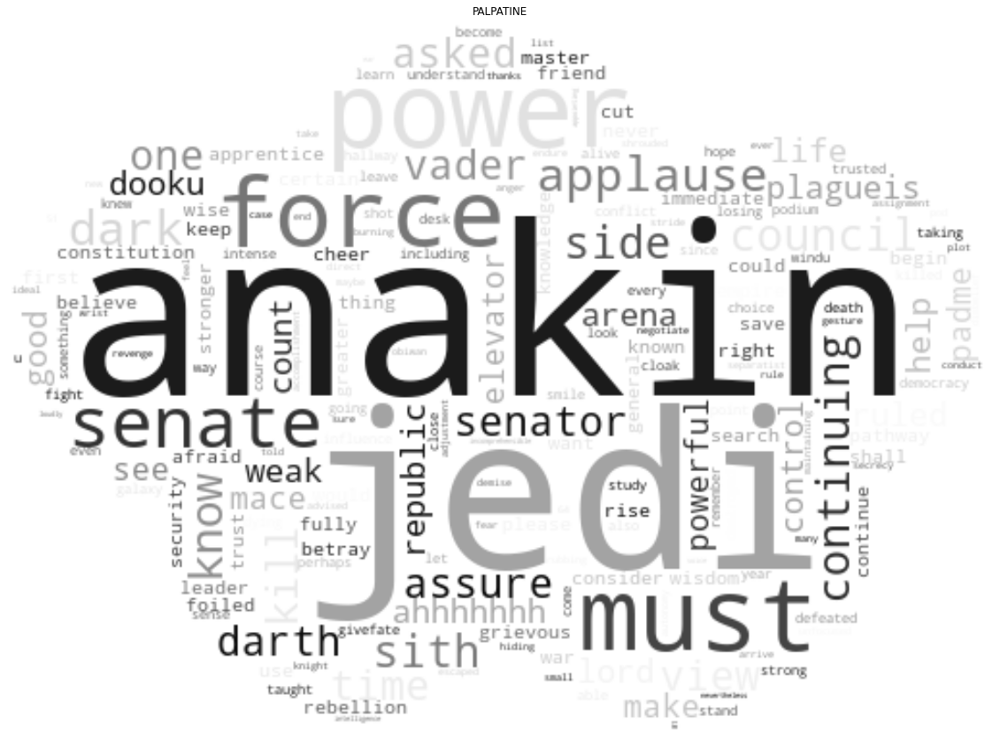

In [250]:
colors = ['Greens', 'Reds', 'Blues', 'GnBu', 'Greys']
list_masks = ['Files/Wordcloud/YODA.png', 'Files/Wordcloud/CLOUD2.png',
              'Files/Wordcloud/LEAF.jpg', 'Files/Wordcloud/CIRCLE.png',
              'Files/Wordcloud/CLOUD2.png']

for i, char in enumerate(characters):
    plt.figure(figsize=[20, 20])
    masks = np.array(Image.open(list_masks[i]))
    wordcloud_race = WordCloud(colormap= colors[i], background_color='white', mask=masks)
    wordcloud_race.generate_from_frequencies(tc_idf[char])
    #plt.subplot(3, 2, i+1)
    plt.imshow(wordcloud_race, interpolation='bilinear')
    plt.axis("off")
    plt.title(char)
    plt.savefig('./Images/Wordclouds/Episode_III/'+char+'.png')
    plt.show()

### Episode IV

#### Loading data

In [251]:
temp_lines = data_lines[data_lines['Movie']=='Episode IV']

#### Create token directory

In [252]:
tk = WordPunctTokenizer()
characters = list(temp_lines['Character'].unique())
for char in characters:
    temp_df = temp_lines[temp_lines['Character']==char].reset_index(drop=True)
    string = ''
    for i in range(len(temp_df)):
        string+=temp_df['Line'][i]
    tokens = tk.tokenize(string)
    tokens = [w.lower() for w in tokens]
    stop_words = stopwords.words('english')
    punctuation = list(punctuation)
    tokens = [token for token in tokens if token not in stop_words and token not in punctuation]
    tokens = [token for token in tokens if token != '...' and char.lower() not in token]
    wnl = nltk.WordNetLemmatizer()
    tokens = [wnl.lemmatize(t) for t in tokens]
    with open('Token_Char/Episode_IV/'+char+'.txt', 'w') as f:
        for item in tokens:
            f.write("%s\n" % item)

#### Calculate TC

In [253]:
tc = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_IV')
characters = ['VADER', 'HAN', 'LEIA', 'LUKE']
for char in characters:
    wordlist = nltk.corpus.PlaintextCorpusReader(root, char + ".txt")
    char_text = nltk.Text(wordlist.words())
    temp_tc = {}
    for key, value in FreqDist(char_text).items():
        temp_tc[key] = value 
    tc[char] = temp_tc

#### Calculate IDF

In [254]:
idf = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_IV')
char = [x + '.txt' for x in temp_lines['Character'].unique()]

wordlist = nltk.corpus.PlaintextCorpusReader(root, char)
collection = nltk.TextCollection(wordlist)
for word in np.unique(wordlist.words()):
    idf[word] = collection.idf(word)

#### Calculate TC-IDF

In [255]:
tc_idf = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_IV')
characters = ['VADER', 'HAN', 'LEIA', 'LUKE']
for char in characters:
    temp_tc = tc[char]
    tc_idf_temp = {}
    for (word, value) in temp_tc.items():
        tc_idf_temp[word] = value*idf[word]
    tc_idf[char] = tc_idf_temp

#### Print word clouds

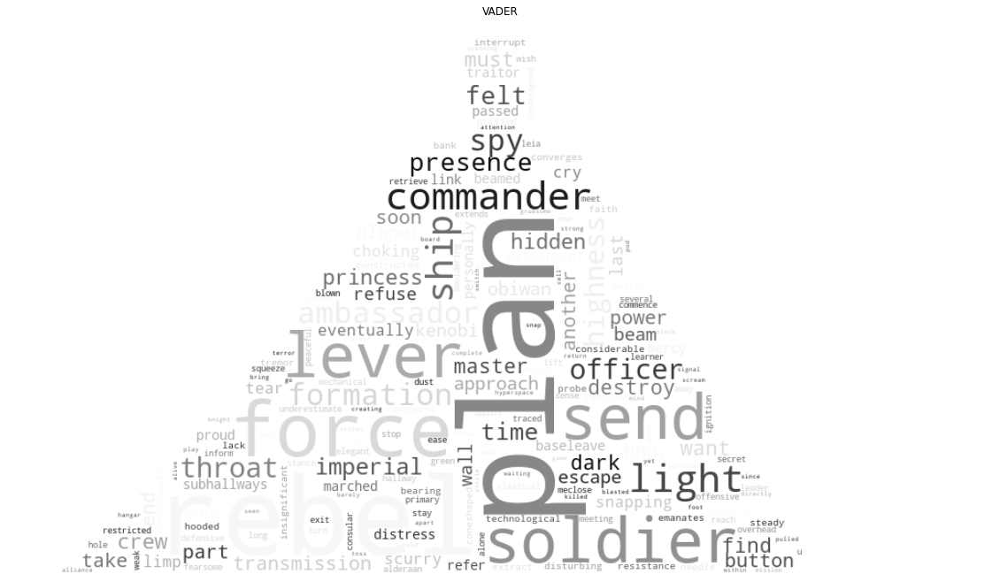

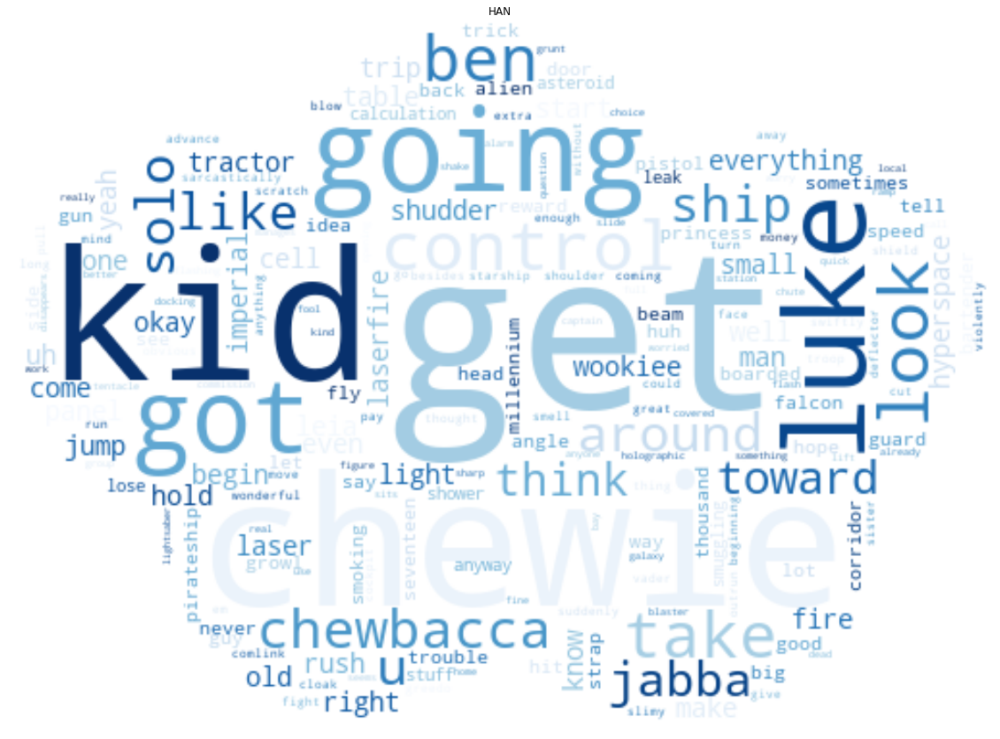

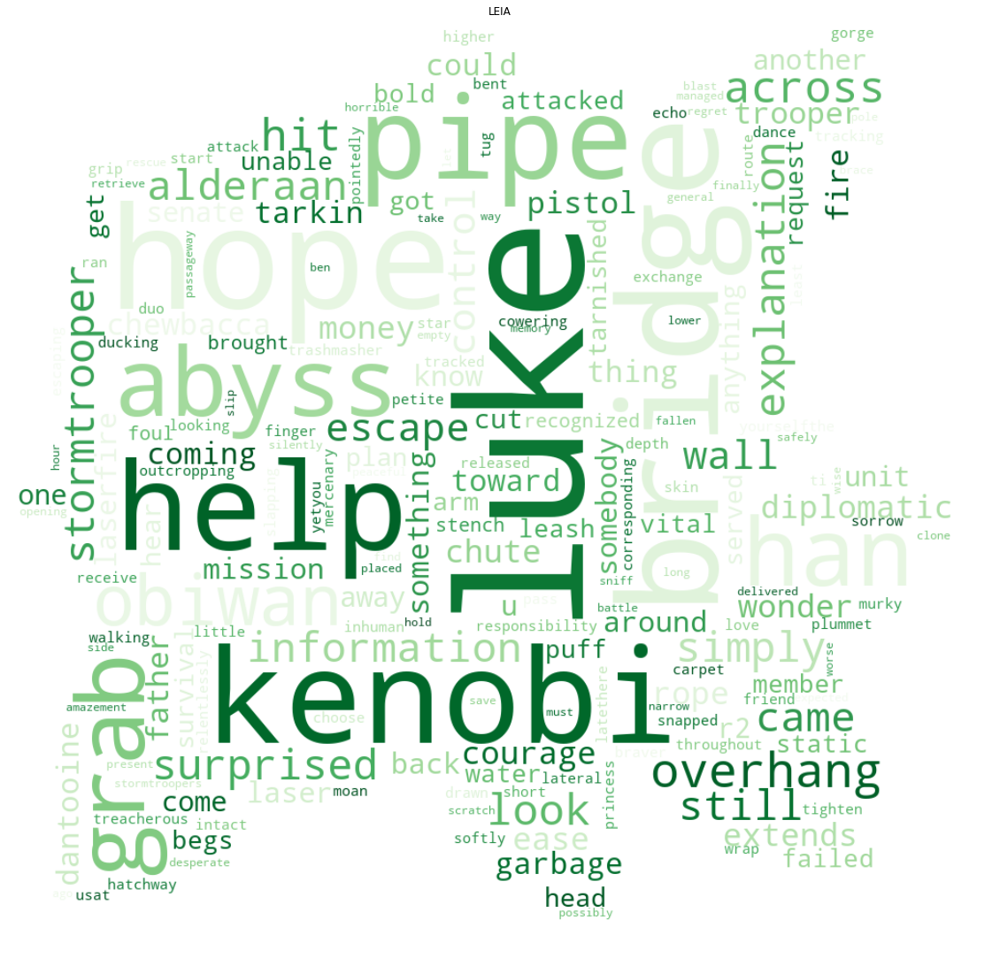

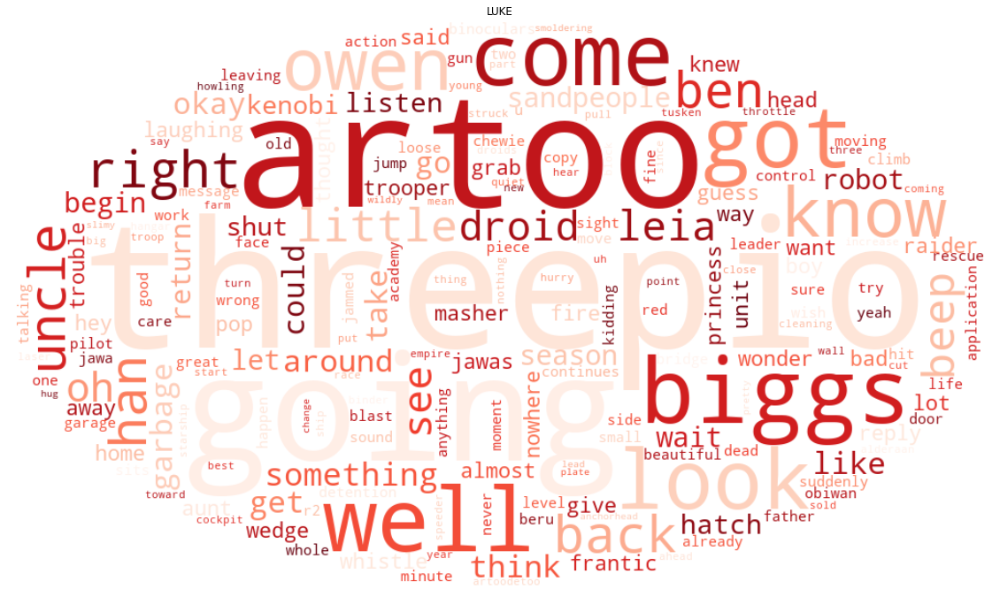

In [256]:
colors = ['Greys', 'Blues', 'Greens', 'Reds']
list_masks = ['Files/Wordcloud/VADER.jpg', 'Files/Wordcloud/CLOUD2.png',
              'Files/Wordcloud/LEAF.jpg', 'Files/Wordcloud/CIRCLE.png']

for i, char in enumerate(characters):
    plt.figure(figsize=[20, 20])
    masks = np.array(Image.open(list_masks[i]))
    wordcloud_race = WordCloud(colormap= colors[i], background_color='white', mask=masks)
    wordcloud_race.generate_from_frequencies(tc_idf[char])
    #plt.subplot(3, 2, i+1)
    plt.imshow(wordcloud_race, interpolation='bilinear')
    plt.axis("off")
    plt.title(char)
    plt.savefig('./Images/Wordclouds/Episode_IV/'+char+'.png')
    plt.show()

### Episode V

#### Loading data

In [257]:
temp_lines = data_lines[data_lines['Movie']=='Episode V']

#### Create token directory

In [258]:
tk = WordPunctTokenizer()
characters = list(temp_lines['Character'].unique())
for char in characters:
    temp_df = temp_lines[temp_lines['Character']==char].reset_index(drop=True)
    string = ''
    for i in range(len(temp_df)):
        string+=temp_df['Line'][i]
    tokens = tk.tokenize(string)
    tokens = [w.lower() for w in tokens]
    stop_words = stopwords.words('english')
    punctuation = list(punctuation)
    tokens = [token for token in tokens if token not in stop_words and token not in punctuation]
    tokens = [token for token in tokens if token != '...' and char.lower() not in token]
    wnl = nltk.WordNetLemmatizer()
    tokens = [wnl.lemmatize(t) for t in tokens]
    with open('Token_Char/Episode_V/'+char+'.txt', 'w') as f:
        for item in tokens:
            f.write("%s\n" % item)

#### Calculate TC

In [259]:
tc = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_V')
characters = ['VADER', 'HAN', 'LEIA', 'LUKE', 'LANDO']
for char in characters:
    wordlist = nltk.corpus.PlaintextCorpusReader(root, char + ".txt")
    char_text = nltk.Text(wordlist.words())
    temp_tc = {}
    for key, value in FreqDist(char_text).items():
        temp_tc[key] = value 
    tc[char] = temp_tc

#### Calculate IDF

In [260]:
idf = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_V')
char = [x + '.txt' for x in temp_lines['Character'].unique()]

wordlist = nltk.corpus.PlaintextCorpusReader(root, char)
collection = nltk.TextCollection(wordlist)
for word in np.unique(wordlist.words()):
    idf[word] = collection.idf(word)

#### Calculate TC-IDF

In [261]:
tc_idf = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_V')
characters = ['VADER', 'HAN', 'LEIA', 'LUKE', 'LANDO']
for char in characters:
    temp_tc = tc[char]
    tc_idf_temp = {}
    for (word, value) in temp_tc.items():
        tc_idf_temp[word] = value*idf[word]
    tc_idf[char] = tc_idf_temp

#### Print word clouds

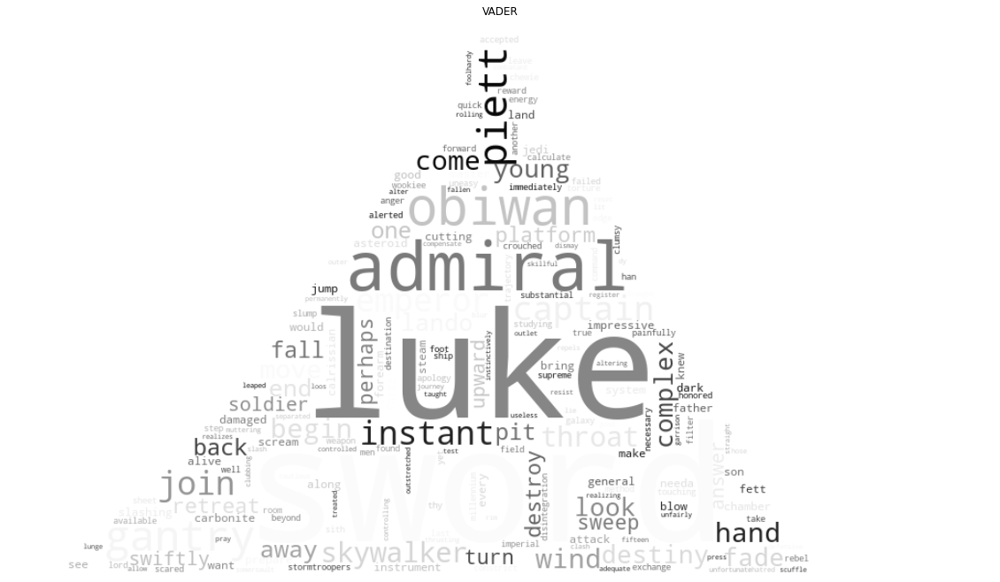

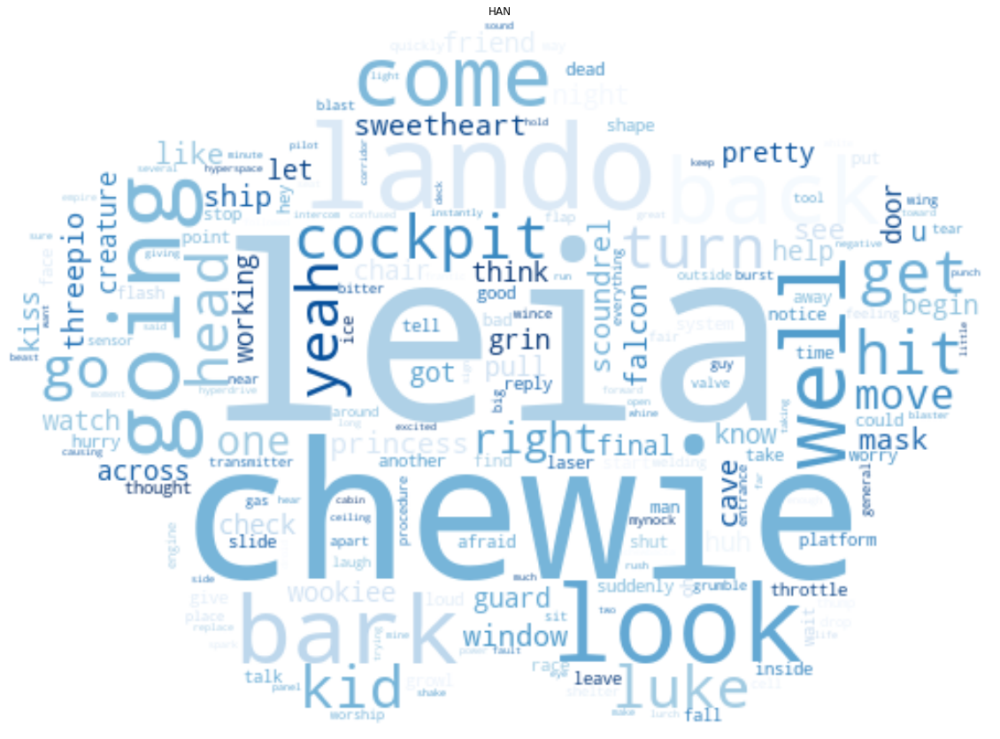

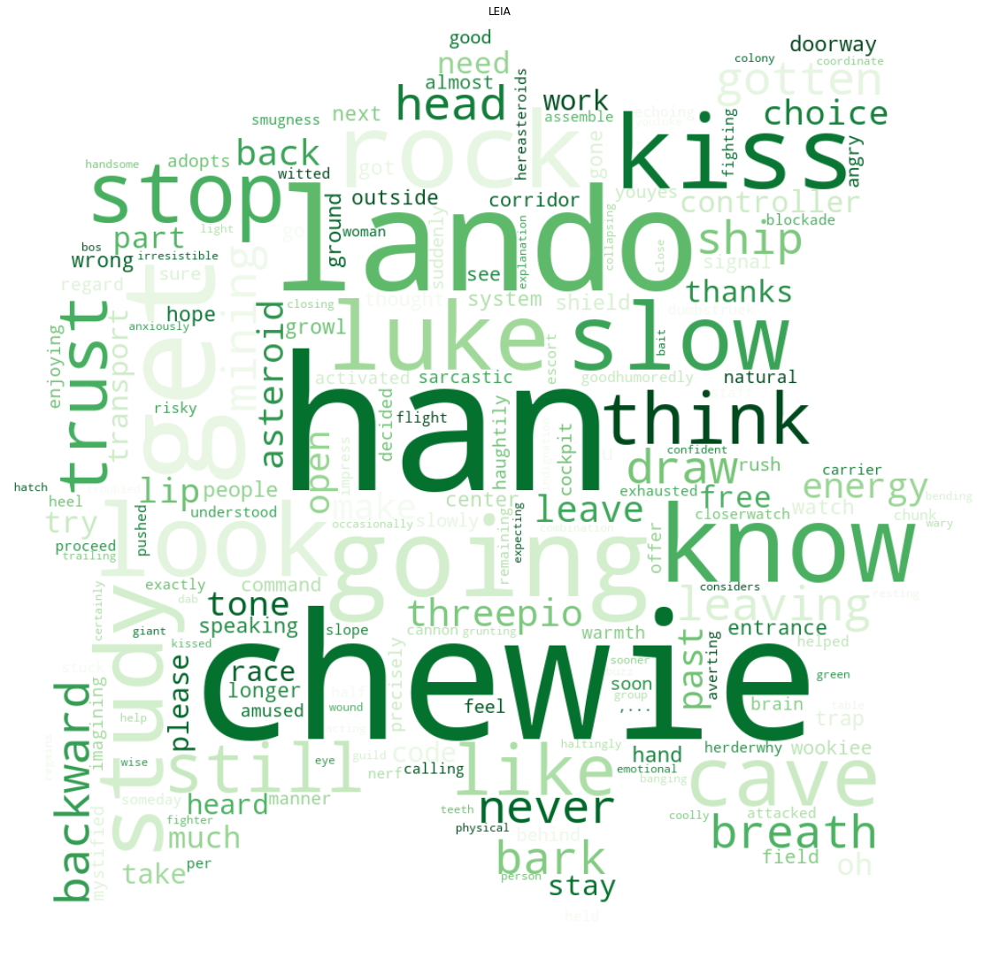

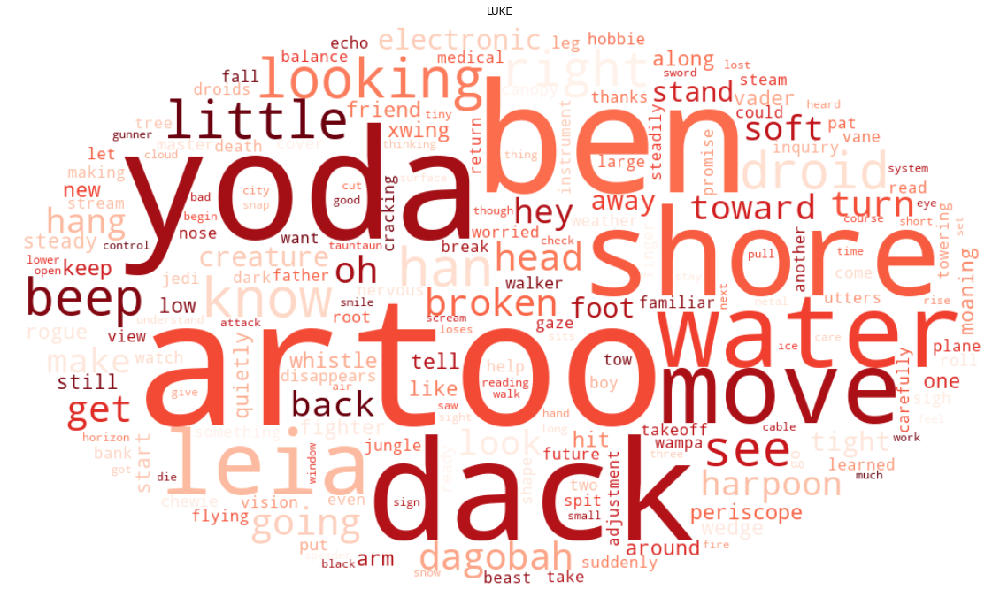

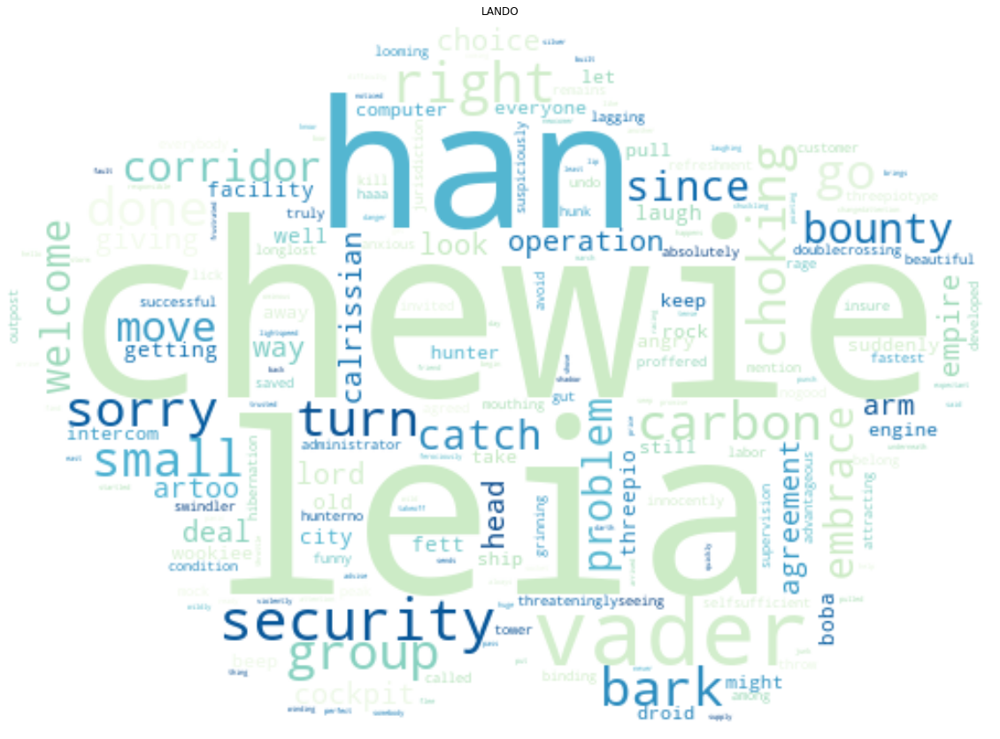

In [262]:
colors = ['Greys', 'Blues', 'Greens', 'Reds', 'GnBu']
list_masks = ['Files/Wordcloud/VADER.jpg', 'Files/Wordcloud/CLOUD2.png',
              'Files/Wordcloud/LEAF.jpg', 'Files/Wordcloud/CIRCLE.png',
              'Files/Wordcloud/CLOUD2.png']

for i, char in enumerate(characters):
    plt.figure(figsize=[20, 20])
    masks = np.array(Image.open(list_masks[i]))
    wordcloud_race = WordCloud(colormap= colors[i], background_color='white', mask=masks)
    wordcloud_race.generate_from_frequencies(tc_idf[char])
    #plt.subplot(3, 2, i+1)
    plt.imshow(wordcloud_race, interpolation='bilinear')
    plt.axis("off")
    plt.title(char)
    plt.savefig('./Images/Wordclouds/Episode_V/'+char+'.png')
    plt.show()

### Episode VI

#### Loading data

In [263]:
temp_lines = data_lines[data_lines['Movie']=='Episode VI']

#### Create token directory

In [264]:
tk = WordPunctTokenizer()
characters = list(temp_lines['Character'].unique())
for char in characters:
    temp_df = temp_lines[temp_lines['Character']==char].reset_index(drop=True)
    string = ''
    for i in range(len(temp_df)):
        string+=temp_df['Line'][i]
    tokens = tk.tokenize(string)
    tokens = [w.lower() for w in tokens]
    stop_words = stopwords.words('english')
    punctuation = list(punctuation)
    tokens = [token for token in tokens if token not in stop_words and token not in punctuation]
    tokens = [token for token in tokens if token != '...' and char.lower() not in token]
    wnl = nltk.WordNetLemmatizer()
    tokens = [wnl.lemmatize(t) for t in tokens]
    with open('Token_Char/Episode_VI/'+char+'.txt', 'w') as f:
        for item in tokens:
            f.write("%s\n" % item)

#### Calculate TC

In [265]:
tc = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_VI')
characters = ['VADER', 'HAN', 'LEIA', 'LUKE', 'LANDO']
for char in characters:
    wordlist = nltk.corpus.PlaintextCorpusReader(root, char + ".txt")
    char_text = nltk.Text(wordlist.words())
    temp_tc = {}
    for key, value in FreqDist(char_text).items():
        temp_tc[key] = value 
    tc[char] = temp_tc

#### Calculate IDF

In [266]:
idf = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_VI')
char = [x + '.txt' for x in temp_lines['Character'].unique()]

wordlist = nltk.corpus.PlaintextCorpusReader(root, char)
collection = nltk.TextCollection(wordlist)
for word in np.unique(wordlist.words()):
    idf[word] = collection.idf(word)

#### Calculate TC-IDF

In [267]:
tc_idf = {}
root = os.path.join(os.getcwd(), 'Token_Char/Episode_VI')
characters = ['VADER', 'HAN', 'LEIA', 'LUKE', 'LANDO']
for char in characters:
    temp_tc = tc[char]
    tc_idf_temp = {}
    for (word, value) in temp_tc.items():
        tc_idf_temp[word] = value*idf[word]
    tc_idf[char] = tc_idf_temp

#### Print word clouds

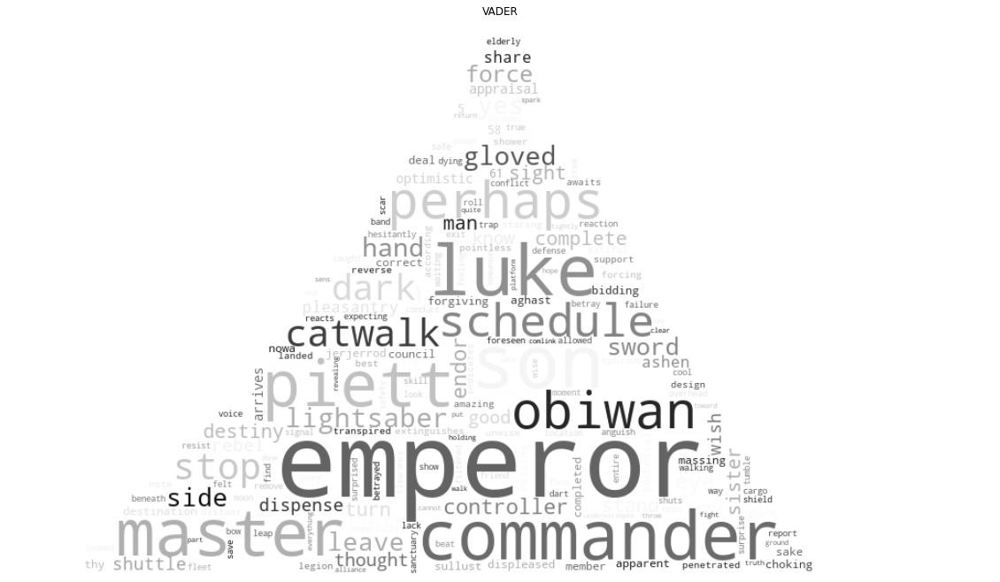

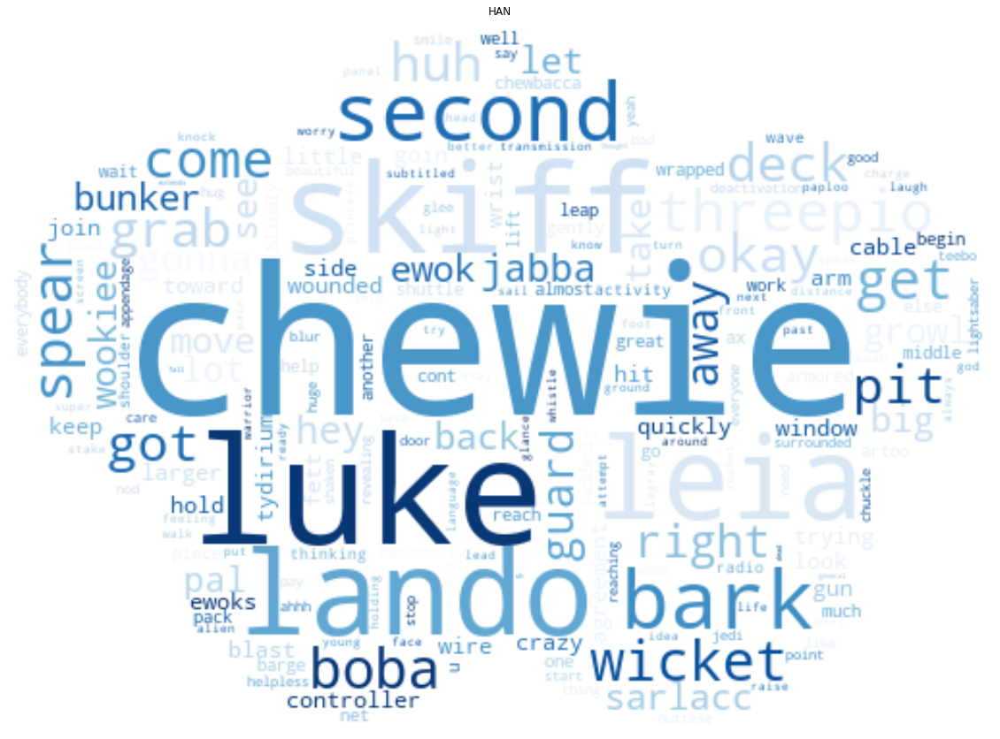

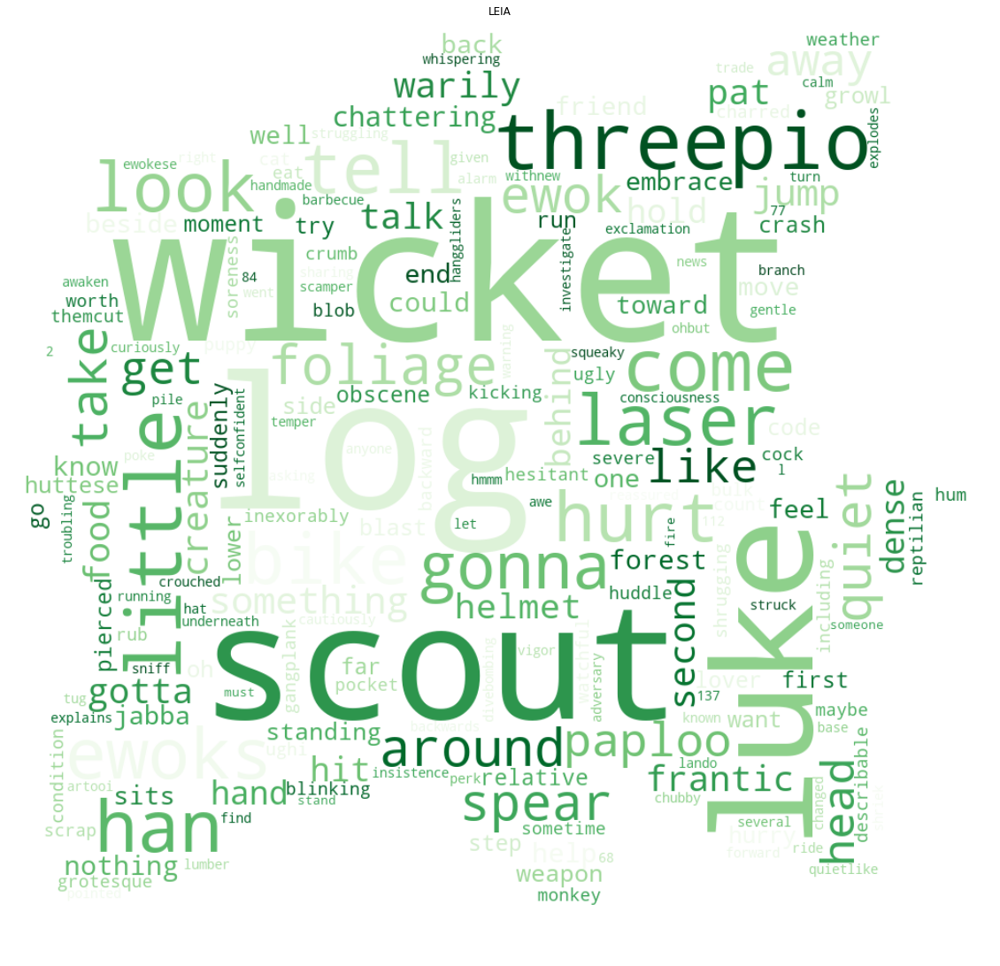

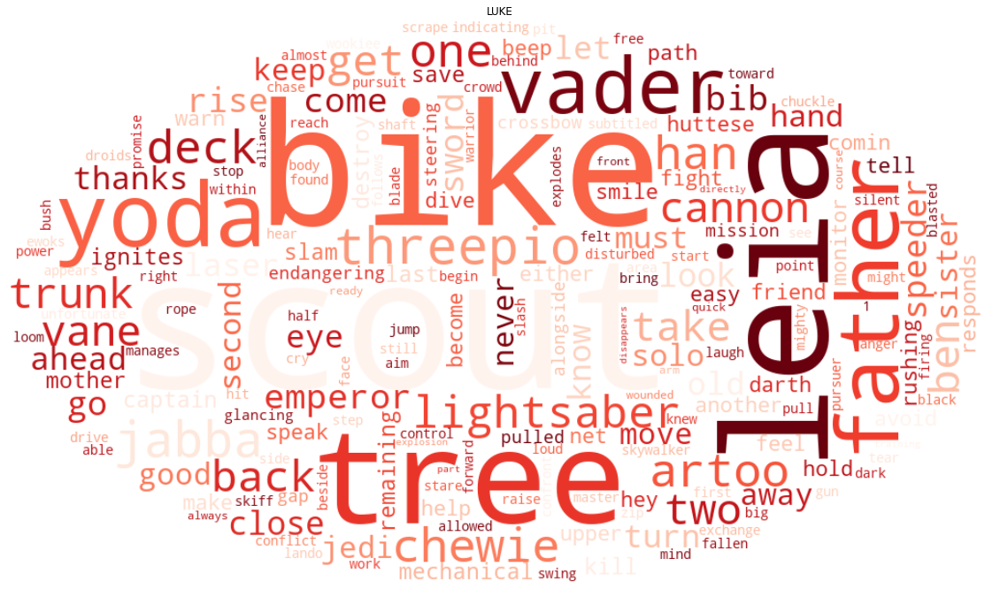

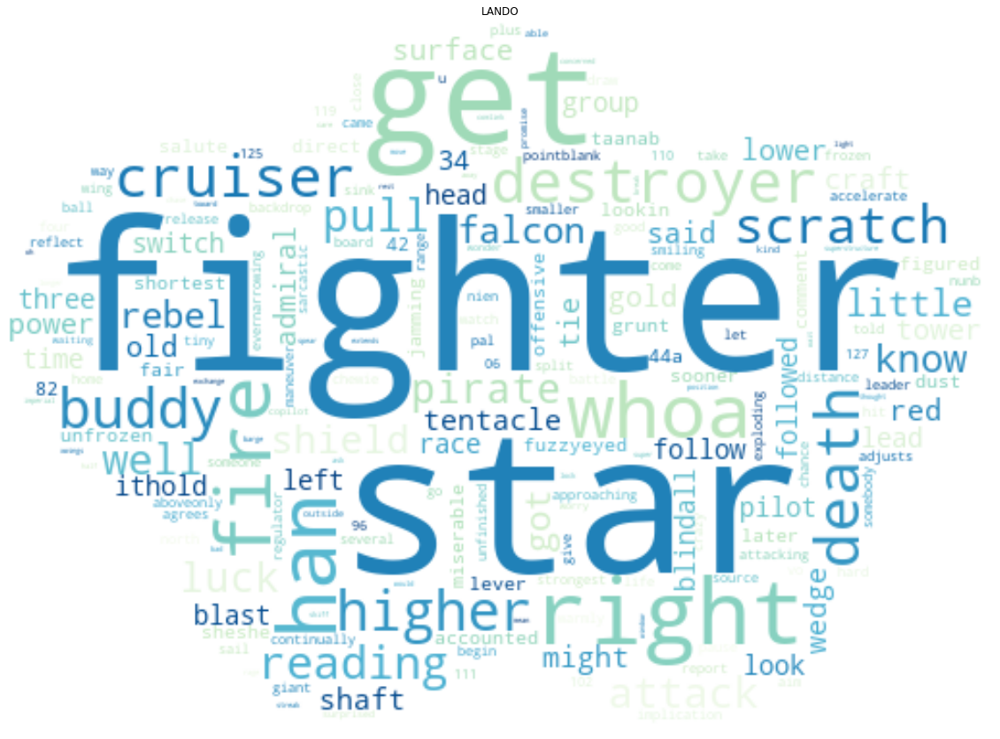

In [268]:
colors = ['Greys', 'Blues', 'Greens', 'Reds', 'GnBu']
list_masks = ['Files/Wordcloud/VADER.jpg', 'Files/Wordcloud/CLOUD2.png',
              'Files/Wordcloud/LEAF.jpg', 'Files/Wordcloud/CIRCLE.png',
              'Files/Wordcloud/CLOUD2.png']

for i, char in enumerate(characters):
    plt.figure(figsize=[20, 20])
    masks = np.array(Image.open(list_masks[i]))
    wordcloud_race = WordCloud(colormap= colors[i], background_color='white', mask=masks)
    wordcloud_race.generate_from_frequencies(tc_idf[char])
    #plt.subplot(3, 2, i+1)
    plt.imshow(wordcloud_race, interpolation='bilinear')
    plt.axis("off")
    plt.title(char)
    plt.savefig('./Images/Wordclouds/Episode_VI/'+char+'.png')
    plt.show()

## Creating Interactive Graphs for our Networks

In this section there will be created interactive graphs. It is not an easy task because the scripts have the characters with different names. Also many characters do not have a name at all at the script. So these characters will not be able to have attributes assigned to them. All characters in the scripts have their names written with upper case letters. Also their names are not written as in the dataframe for example 'ANAKIN' is 'Anakin Skywalker'. Also Darth Vader and Anakin are treeted as different Characters. Therefore the simplest method is to convert all names to uppercase and then check if the name in the script is part of the string name at the dataframe. However there are cases that do not be dealt with this method for example C3PO is written in the scripts as THREEPIO.

In [269]:
output_notebook()

Loading BokehJS ...

#### Needed functions to pair each character from scripts to characters in the dataframe

In [270]:
#functions needed to add atributes to graph

def pairing_function(List1,List2):
    assert len(List1)==len(List2), "Lists must have the same size"
    PList = tuple(zip(List1, List2)) 
    return {x : y for x,y in PList}


def name_filtering(list1,element):
    assert isinstance(element, dict) , 'element is not a dictionary' 
    for i in list1:
        assert isinstance(i, str) , 'list wit non str element' 
        if( i.upper()) in element['Name'].upper() : return element ,i
    return None
print(name_filtering(['vaggelis', 'Maria', 'Scizor'], {'Name':'---'})) 

def DF_filter(list ,df, episode ):
    assert isinstance(episode, str), "episodde is not a string"
    assert isinstance(df, pd.core.frame.DataFrame), 'df not a Dataframe'
    filtered = [name_filtering(list,dict(row)) for _,row in df.iterrows()]
    res = []
    for i in filtered:
        if i != None:
            if i[0][episode] == 1:
             res.append(i)
    return res

def Graph_enrich(G, List):
    for attr,node in List:
        G.nodes[node].update(attr)

None


### Wikia's Network

#### Create the network

In [271]:
char = pd.read_csv('./Data/Characters.csv')

G = nx.DiGraph()

for filename in os.listdir(os.path.join(os.getcwd(), 'Data/Characters')):
    if(filename=='_Shady_ Pers.txt'): continue 
    with open(os.path.join(os.path.join(os.getcwd(), 'Data/Characters'), filename), 'r') as f:
        contents = f.read()
        query_json = ast.literal_eval(contents)
        page_id = list(query_json['query']['pages'].keys())[0]
        string = query_json['query']['pages'][page_id]['revisions'][0]['slots']['main']['*']
                
        # Add nodes
        name = filename[:-4].replace('_',' ')
        G.add_node(name)
                
        # Add homeworld attribute
        G.nodes[name]['Homeworld'] = char.loc[char['Name']==name, 'Homeworld'].values[0]
        
        # Add species attribute
        G.nodes[name]['Species'] = char.loc[char['Name']==name, 'Species'].values[0]
        
        # Add gender
        G.nodes[name]['Gender'] = char.loc[char['Name']==name, 'Gender'].values[0]
        
        # Add edges
        pattern = '\[\[(.*?)(?:\|.*?)?\]\]'
        temp = re.findall(pattern, string)
        temp = list(char[char['Name'].isin(temp)]['Name'].drop_duplicates())
        for i in temp:
            G.add_edge(name, i)
            
G.remove_nodes_from(list(nx.isolates(G)))

#### Characters with no known Homeworld having value "Noworld" 

In [272]:
#print(G.nodes.data())
nodes=G.nodes.data()
#print(nodes["'Ndranth Poussan"])
#print(nodes["'Ndranth Poussan"].keys())
#print("Homeworld" not in nodes["'Ndranth Poussan"].keys())


#print(type(G.nodes["'Ndranth Poussan"]))

homeless_nodes = []
for i in G.nodes :
    if ("Homeworld" not in nodes[i].keys()):
        homeless_nodes.append(i)
        
#print (homeless_nodes)
#print (len(homeless_nodes))
for i in homeless_nodes:
        G.nodes[i]["Homeworld"]="NoWorld" 

#### Creating a static Graph

In [273]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*4 for degree in dict(G.degree()).values()]
node_colors = ['lightcoral' if temp == 'Tatooine' 
               else 'slateblue' if temp == 'Naboo' 
               else 'forestgreen' if temp == "Yoda's homeworld"
               else 'olive' if temp == 'Stewjon'
               else 'skyblue' if temp == 'Corellia'
               else 'plum' if temp == 'Coruscant'
               else 'steelblue' if temp == 'Alderaan'
               else 'peru' if temp == 'Kashyyyk'
               else 'dimgrey' for _, temp in nx.get_node_attributes(G, 'Homeworld').items()]


100%|██████████| 1000/1000 [00:54<00:00, 18.40it/s]

BarnesHut Approximation  took  24.08  seconds
Repulsion forces  took  27.58  seconds
Gravitational forces  took  0.22  seconds
Attraction forces  took  0.22  seconds
AdjustSpeedAndApplyForces step  took  1.05  seconds


#### Visualize network

In [274]:
#print(G.nodes.data())
nodes=G.nodes.data()
#print(nodes["'Ndranth Poussan"])
#print(nodes["'Ndranth Poussan"].keys())
#print("Homeworld" not in nodes["'Ndranth Poussan"].keys())


#print(type(G.nodes["'Ndranth Poussan"]))

homeless_nodes = []
for i in G.nodes :
    if ("Homeworld" not in nodes[i].keys()):
        homeless_nodes.append(i)
        
#print (homeless_nodes)
#print (len(homeless_nodes))
for i in homeless_nodes:
        G.nodes[i]["Homeworld"]="NoWorld" 

#### Creating interactive graph based on the static one

In [275]:
title = "Whole Network"

#getting attributes known for the graphs
res = DF_filter(G.nodes(), char,'First Trilogy')


Graph_enrich(G,res)


HOVER_TOOLTIPS = [("Character", "@index"),
                  ("Homeworld","@Homeworld"),
                  ("Residence","@Residence"),
                  ("Species","@Species"),
                  ("Gender","@Gender"),
                  
                 ]


node_positions = pairing_function(G.nodes(),positions)
node_size = pairing_function(G.nodes(), node_sizes)

nx.set_node_attributes(G, node_positions, 'node_pos')
nx.set_node_attributes(G, node_size, 'node_size')

plot = figure(tooltips=HOVER_TOOLTIPS,tools="pan,wheel_zoom,save,reset", active_scroll='wheel_zoom',
            plot_width=1000, plot_height=800,
            x_range=Range1d(-3.1,3.1), y_range=Range1d(-3.1,3.1),title = title)

graph_renderer = from_networkx(G, nx.spring_layout, scale=10, center=(0,0))

#style

graph_renderer.node_renderer.glyph = Circle(size=15, fill_color='skyblue')
#graph_renderer.node_renderer.data_source = node_source
#graph_renderer.node_renderer.glyph = Circle(fill_color = 'node_color',size = 'node_size', line_color = None)

#graph_renderer.edge_renderer.glyph = MultiLine(line_color="#CCCCCC", line_alpha=0.8, line_width=2)

#network_graph.edge_renderer.glyph = MultiLine(line_alpha=0.5, line_width=1)

plot.renderers.append(graph_renderer)

show(plot)
output_file(filename="HTML/network.html", title='Star Wars Universe')
save(plot)

'/home/chrypapa/Desktop/DTU/2nd Semester/Social Graphs and Interactions/Final Project/Project Part B/HTML/network.html'

### Network based on the six episodes

#### Create the dataset

In [276]:
small_data = char[(char['First Trilogy']==1)|(char['Second Trilogy']==1)].reset_index(drop=True)

small_data.loc[(small_data['First Trilogy']==1) & (small_data['Second Trilogy']==0), 'Trilogy'] = 'First three episodes'
small_data.loc[(small_data['First Trilogy']==0) & (small_data['Second Trilogy']==1), 'Trilogy'] = 'Last three episodes'
small_data.loc[(small_data['First Trilogy']==1) & (small_data['Second Trilogy']==1), 'Trilogy'] = 'Both'

#### Create the network

In [277]:
G = nx.DiGraph()
for filename in os.listdir(os.path.join(os.getcwd(), 'Data/Characters')):
    print (filename)
    if (filename == 'V-Taun.txt'): continue
    if (filename == 'Vanden Willard.txt'): continue
    if (filename == 'Venka.txt'): continue
    if filename[:-4].replace('_',' ') in small_data['Name'].values:
        with open(os.path.join(os.path.join(os.getcwd(), 'Data/Characters'), filename), 'r') as f:
            contents = f.read()
            query_json = ast.literal_eval(contents)
            page_id = list(query_json['query']['pages'].keys())[0]
            string = query_json['query']['pages'][page_id]['revisions'][0]['slots']['main']['*']

            # Add nodes
            name = filename[:-4].replace('_',' ')
            G.add_node(name)

            # Add homeworld attribute
            G.nodes[name]['Homeworld'] = small_data.loc[small_data['Name']==name, 'Homeworld'].values[0]

            # Add species attribute
            G.nodes[name]['Species'] = small_data.loc[small_data['Name']==name, 'Species'].values[0]

            # Add gender
            G.nodes[name]['Gender'] = small_data.loc[small_data['Name']==name, 'Gender'].values[0]
            
            # Add trilogy
            G.nodes[name]['Trilogy'] = small_data.loc[small_data['Name']==name, 'Trilogy'].values[0]
            
            # Add edges
            pattern = '\[\[(.*?)(?:\|.*?)?\]\]'
            temp = re.findall(pattern, string)
            temp = list(small_data[small_data['Name'].isin(temp)]['Name'].drop_duplicates())
            for i in temp:
                G.add_edge(name, i)

G.remove_nodes_from(list(nx.isolates(G)))

Teek.txt
Shelov.txt
Ziton_Moj.txt
Vikas_Sleer.txt
Kiwu'tro'owmis.txt
Jorj_Car'das.txt
Grana.txt
Vedd_Deviss.txt
Gerell_Yok'Ril.txt
Griff_Praji.txt
Akial.txt
Crowley_(Human).txt
Kandar_Vallan.txt
Naelora.txt
Breedo.txt
Jax_Seldam.txt
Lejo.txt
Sunchoo.txt
Kanlee_Fentetta.txt
Carlitina_Semla.txt
Jo.txt
Kylaena_Haley.txt
Unidentified_Rodian_(Lower_Apartments).txt
Judder_Page's_father.txt
Hid_Toqema.txt
Myahh.txt
Unidentified_Ralltiir_freighter_captain.txt
Kloo.txt
Yorick.txt
Vontaige.txt
Gault_Rennow.txt
Minda_Hogaan.txt
Spiz.txt
Oret_Sturm.txt
Ki_Largo.txt
Carnus.txt
Malindin_Gevarak.txt
Chanya_Medaal.txt
Javran_Mu.txt
Tork.txt
Grave_Tuskens.txt
Gav_Daragon.txt
Kitaya_Shuul.txt
Sedra_Hoxin.txt
Baratatta_Spirit-Leader.txt
Dagorel.txt
Jorak_Uln.txt
Onoh.txt
Kai_Saddek.txt
Tan_Kirin.txt
Domus_Renking.txt
Skerrick_Das.txt
Kat_Saka.txt
Orrin_Loneozner.txt
Fawn's_mother.txt
Tescia.txt
Wald.txt
Davrin.txt
Vezok.txt
Meloria.txt
Rhiek_Okina.txt
Latika_Garboren.txt
Benno.txt
Chewbacca.txt
Sakme_Kel

Nordon.txt
Nibao_Glumm.txt
Grea.txt
Cotin.txt
Lan_(Human).txt
Dathnaeya_Loessin.txt
Coolie.txt
Liska_Dan'kre.txt
C2-R4.txt
Unidentified_medical_officer.txt
Mykka.txt
Kurth_San.txt
Warshack_Rojo.txt
Pech_Seki.txt
Slag_Flats.txt
Coris_Mao.txt
Rorak_(individual).txt
Raymas_Daal.txt
Meh'ur.txt
Hanes_Croft.txt
Garil_Volune.txt
Uliaff_ke_Unthos.txt
Elamm.txt
Zovius_Mendu.txt
Garvin_Delquist.txt
Grania_(Brentaali).txt
Gorran.txt
Venco_Autem.txt
Terris.txt
Ardan.txt
Bree.txt
Hardin.txt
Otias_Atori.txt
Rodin_Hlian_Verpalion.txt
Talpron.txt
Grubber_Vapps.txt
Hapan.txt
Shappa_Farrs.txt
Grogur.txt
Seth_Cambriel.txt
Denell_Kel'Vannon.txt
Unidentified_portmaster.txt
Ib-Dunn.txt
Sinasu.txt
Nivel.txt
Minnix.txt
Allania_Jakien.txt
Batral_Orcel.txt
Jarg_Fleffant.txt
Tristan_Pex.txt
Elarles.txt
Murthil.txt
Nahata.txt
Hidden_Beks.txt
O-Iris.txt
Hasadar_Shu.txt
Amarent_Loren.txt
Jaro.txt
Dervish.txt
Zarko.txt
El'Tar_Miskin.txt
Nackhar.txt
Chozz_Wardle.txt
Gwen.txt
Burryaga_Agaburry.txt
Dashel.txt
Matale_fa

Liaan_Lah.txt
Dulor_Norr.txt
Keriin_Haslip.txt
Macemillian-winduarté.txt
Lira_Mimb.txt
Regalun_Petryph.txt
Unidentified_Revwien_trader.txt
Darth_Rivan.txt
Marin_Anke.txt
Broma_Lak.txt
Tress_Aressa.txt
Jaster_Mereel.txt
Tattyra_Firewell.txt
Kiantryl_Liawoon.txt
Sander_Delvardus's_wife.txt
Kaiya_Merel.txt
Onibald_Daykim.txt
Kell_Borean.txt
Coruum_Sa'dia.txt
Bespinite.txt
Ryder_Azadi.txt
Nycolai_Kinesworthy.txt
Tasander_Dest's_father.txt
Crale_Forte.txt
San'sii.txt
Temmin_Wexley.txt
Challep.txt
Bettle's_sister.txt
Maana_Demknot.txt
Alarik_X.txt
Purton.txt
Ry_Nymbis.txt
Alya_Aldrete.txt
Juno_Eclipse.txt
Ryyts.txt
First_Wavers.txt
Moreem_Espara.txt
Iann_Doaba.txt
Entora_Zar.txt
Pakmillu.txt
Tris_(Chiss).txt
Voss_Parck's_father.txt
Garouk.txt
Ertine.txt
Gerak_Vurtimis.txt
Mellor_Yago.txt
Alvania.txt
Anna.txt
Varlo_Brim.txt
Waif.txt
Nelani_Dinn.txt
Anyza_Ekull.txt
Aervis_Wint.txt
Sakul_Ondondanax.txt
Iolan_Gendarr.txt
Zyn.txt
Pokk.txt
Benoni_Ulte.txt
Vischera.txt
Nestor.txt
Baobab_family.txt


Fera.txt
Hynestian.txt
Harb_Binli.txt
Howe_Walwahd.txt
Carlin.txt
Gizor_Dellso.txt
Jain_Havero.txt
Unidentified_ball-shaped_creature.txt
Mas_Sirrah.txt
Tryst_Veila.txt
Mission_Vao.txt
Janos_Zarbo.txt
Keevy_Spart.txt
Ephran_Zell.txt
Evlyn_Tabory.txt
Theras.txt
Berisse_Sai.txt
Erisi_Dlarit's_uncle.txt
Napo_Popotis.txt
Hawk_Ryo.txt
Denwade_Banevans.txt
Wandila_Tatmount.txt
Klusoe.txt
Toprawa.txt
Kett_(Corellian).txt
Jake_(smuggler).txt
Azoora.txt
Orris_Madmund.txt
Diva_Shaliqua.txt
Unidentified_Solay_Rebel.txt
Donta_Gesset.txt
Harravan.txt
Wil_Jhonems.txt
EV-9D9.txt
Grigor_(governor).txt
Thorne_Kraym.txt
Ror_Ithh.txt
Cedo_Partu.txt
Chastina_Rile.txt
Seezelslak.txt
Rat_(Human).txt
Unidentified_Gand_scavenger.txt
Hari_Seldona.txt
Chalmun.txt
EG-02.txt
Ba'kif.txt
Pera.txt
Elise_Montagne's_husband.txt
Raskurro.txt
Risso_Nu.txt
Jonra_Far.txt
Aren_Folee.txt
Unidentified_Alderaanian_Security_agent.txt
Turland_Hack.txt
Mora.txt
Zosh_Vexonuk.txt
Cleeve.txt
Bascko.txt
Rostek_Horn.txt
Nichos_Panib.t

Aral_tukor_Viest.txt
Tiarri.txt
Zekka_Thyne.txt
Jhara.txt
Ra_Sara.txt
Tarkov.txt
Jzoro_Quanera.txt
Orman.txt
Portia.txt
Om_Aynat.txt
Tweetu.txt
Quaad_Endac.txt
Faye_Patrick.txt
Parvin_Willsaam.txt
Chulco_Gi.txt
Wilhuff_Tarkin's_grandfather.txt
Foth_Shemar.txt
Tomlin_Gorastor.txt
Pylokam.txt
Lanni.txt
Skall_Delos.txt
Lowbacca.txt
Ap'Sareb.txt
Groggin.txt
Feraa.txt
Devin_Hvitur.txt
Juda.txt
Holshef.txt
Arias.txt
Harra_(Twi'lek).txt
Jak_Dexter.txt
O-Rina.txt
Honn_Dangel.txt
Nannat.txt
Ulbert.txt
Baylis_Archan.txt
Builder_With_Vines.txt
Riva.txt
Merik_Darou.txt
Grobber.txt
Anandra_Milon's_uncle.txt
Gizman.txt
Spob_Rydel.txt
Vanara_Kayl.txt
Dengar.txt
Jessamyn.txt
Markl.txt
Cosinga_Palpatine's_mistress.txt
Sand_People_chieftain.txt
Elder_of_Knylenn.txt
Inyri_Forge.txt
Katarra.txt
Bettle.txt
Ptor.txt
Laane.txt
Gungi.txt
Alexir_Lands.txt
J'Quille.txt
Jacen_Syndulla.txt
Queg.txt
Xoron_Gulfel.txt
Erland_Merich.txt
Jake_Fenn.txt
Ujaa.txt
Dorn_Gestros.txt
Hussef.txt
Jjorg.txt
Fessi.txt
Rauk_Oenis

Flyer_Through_Spikes.txt
Lora_Nadad.txt
Beeyon_Nace.txt
Haangok.txt
Silman.txt
Larbo.txt
Albee.txt
Galney_family.txt
Jonash_Solo.txt
Ke_Oleans.txt
Nena.txt
Serji-X_Arrogantus.txt
Victor_Visalis.txt
Ehartt_Brihnt.txt
Belga_Daeri.txt
Femon.txt
Bran_Kemple.txt
Faime_Gosan.txt
Hewpaj.txt
Keelin_Zaariq.txt
Radanthus_Mandelatara.txt
Dunc_T'racen.txt
Min.txt
Alor_Keto.txt
Kaalah-Nah.txt
Lonai.txt
Menir.txt
Reina_March.txt
Unidentified_cooking_instructor.txt
Gerrick_Lond.txt
Jord.txt
Unidentified_Polynean_pilot.txt
Jareck_Arned.txt
Vara_Karathas.txt
Mika_Kaebra.txt
Barion_Raner.txt
Caelum_Thaney.txt
Ashala_Ma-dred.txt
Kasslan.txt
Thanlis_Depallo.txt
Randor_Mohl.txt
Draknus.txt
Vaklu.txt
Abdi-Badawzi.txt
Junelle_Astor.txt
Mazie.txt
Anoser.txt
Dirv_Pym.txt
Unidentified_Naboo_artist.txt
Aguilae.txt
Sol_Windtide.txt
Kinuagha.txt
Garren.txt
Rakir_Banai.txt
Peli_Motto.txt
Joddar.txt
Yarith_Figg.txt
Tyburn_Welles.txt
Orden_Tarc.txt
Sar_Labooda.txt
Cura.txt
Millbarge.txt
Galney_(Lady).txt
Pedrin_Gaul.

Unidentified_Tarasin_Force_ghost.txt
Irek.txt
Garatty_ke_Kith.txt
Yliri_Consta.txt
Tojo.txt
Norrin_Vaxx.txt
Viqi_Shesh.txt
Peita_Aabe.txt
Fenic.txt
Thaddeus_Ross.txt
Janus_Bonn.txt
Anky_Fremp.txt
Earnst_Kamiel.txt
Dezanti_Zhug.txt
Vox_Chun.txt
Coruscanti.txt
Jander.txt
Sera_Faleur_Darklighter.txt
Wint.txt
Davv'si.txt
Gideon_Hask.txt
Lurval.txt
Rontl.txt
Unidentified_instructor.txt
Thug.txt
Grakchawwaa.txt
Than_Droe.txt
Yalt_(female).txt
Nails.txt
Nawruun.txt
Morton.txt
Lan_Starburn.txt
Lorle.txt
Ivesa.txt
Denna.txt
Jenda.txt
Shas_Vadde.txt
Hunter_Of_Winds.txt
De-hoff_Greenley.txt
Jori_Daragon.txt
Yin_Vocta.txt
Kilaphor_Dashta.txt
B'ree.txt
Zheus.txt
Yondalla.txt
Valton.txt
Ommin's_father.txt
Bellek.txt
Andrithal_Robb-Voti.txt
Jos_Mayda.txt
Mayli_Weng.txt
Den_Solo.txt
Vel-Kan.txt
Aereena.txt
Captain_of_the_Nikto_Guard.txt
Tionthes_Turi.txt
Rosha_Vess.txt
Rhea.txt
Bez.txt
Gantu.txt
Jaytee.txt
Gall_(individual).txt
Unidentified_Sith_nanny_droid.txt
Fell_Dargun.txt
Kaye_Galfridian.txt
Bozz

Sumok.txt
Secondary.txt
Oollie.txt
Salis_Kabor.txt
Boraso.txt
Merkie_Howzat.txt
Ch'ord_Sy'fon.txt
Juno_Eclipse's_mother.txt
Krael.txt
Anitol_Rosspar.txt
Garm_Totryl.txt
Cohbo'rik'ardok.txt
Kirk_Windjammer.txt
Lha-Mi.txt
Nasan_Godera.txt
Teniel_Waray.txt
Onderon_separatists.txt
Agrippa_Aldrete.txt
Hosh_Hune.txt
Breha_Organa's_mother.txt
Sheel_Mafeen.txt
Sianna_Sekko.txt
Feylis_Ardele.txt
Kirlocca.txt
Dracmus.txt
Meck_Feem.txt
Puko_Naga.txt
Olianna.txt
Renei.txt
Demmi_Wot.txt
Omano.txt
Varas_Hoorst.txt
99-99.txt
Kuati.txt
Nobot.txt
Brantlee_Spondoon.txt
Russok.txt
Ithmir.txt
Dath.txt
Tallie.txt
Spindrall.txt
Disappointed_moisture_farmer.txt
Yraka_Nes.txt
Flesh_Raider.txt
Godoba.txt
Natt_Bordo.txt
Weeffil_Liff.txt
Rondale_Merced.txt
Terlyn's_son.txt
Debbikin_the_Elder.txt
Starstriker.txt
Adray_Terson.txt
Feeven.txt
Ponlar.txt
Dhowar_Repareed.txt
Tipper.txt
Flim.txt
Terri_Karl.txt
Kailla-Glon-Vow.txt
Jax_(pilot).txt
Archa_Sabis.txt
Molierre_Cundertol.txt
Hospitality_Guide.txt
Jem.txt
Worrr

Tomi_Skaak.txt
Tror.txt
Doman_Beruss_(Corellian).txt
Rolo.txt
Sandi.txt
Nuris_Blaht.txt
Qel-Droma_family.txt
Dilpram.txt
Olodondo_Berzix.txt
Jeapird_ke_Fanax.txt
Quintama's_father.txt
Woorwill.txt
Cole_Cantarus.txt
Cem_Fel.txt
Ebela_Puckett.txt
Donovan_(captain).txt
Jed.txt
Ben_Surrep.txt
Lol_Miilarta.txt
Gav_Vannar.txt
Dif_Istuvi.txt
Asadia_Boresa.txt
Root.txt
Palola.txt
Kahranna.txt
Oron_Kira.txt
Elbee_Bribb.txt
Lunce_Targettal.txt
Scolex_Grath.txt
Tryn.txt
Ajai_Fel.txt
Dooni's_mother.txt
Q'anah's_father.txt
Iep_Tumu.txt
Denira.txt
Xyrias_Undea.txt
Willoc.txt
Titus_Klev.txt
Renning.txt
Deckland_Carper.txt
Unidentified_vendor_droid.txt
Thera_Capens.txt
Jeg.txt
Unidentified_fisherman.txt
Nartlo.txt
Rikkard.txt
Wilst_Molan.txt
Unidentified_Jawa_(Tatooine).txt
Chelsey_Grimes.txt
Sami_(Human).txt
Swilla_Corey.txt
Biblack.txt
Rori_Fenn.txt
Elbo.txt
Slyther_Bushforb.txt
Blleen.txt
Niklos.txt
Van_P._Quist.txt
Reha_Logg.txt
Ghia_Preyssola.txt
Hondu_Firewell.txt
Lorac.txt
Uralak.txt
Dobah.txt


#### Visualize the network

In [278]:
char = pd.read_csv('./Data/Characters.csv')

G = G.to_undirected()

# Function for colored edges
def edge_color(graph, node1, node2):
    if 'Trilogy' not  in graph.nodes[node1].keys(): return 'goldenrod'
    if 'Trilogy' not  in graph.nodes[node2].keys(): return 'goldenrod'
    role1, role2 = graph.nodes[node1]['Trilogy'], graph.nodes[node2]['Trilogy']
    if role1 == role2 == 'First three episodes':
        return 'lightcoral'
    elif role1 == role2 == 'Last three episodes':
        return 'slateblue'
    elif role1 == role2 == 'Both':
        return 'dimgrey'
    elif ((role1=='First three episodes') & (role2=='Both'))|((role2=='First three episodes') & (role1=='Both')):
        return 'lightcoral'
    elif ((role1=='Last three episodes') & (role2=='Both'))|((role2=='Last three episodes') & (role1=='Both')):
        return 'slateblue'
    else: 
        return 'goldenrod'

for i in G.nodes():
    if "Trilogy" not in G.nodes[i].keys():
        G.nodes[i]['Trilogy']='NoOne'
    
forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_colors = [edge_color(G, node1, node2) for node1, node2 in G.edges]
node_colors = ['lightcoral' if temp == 'First three episodes' 
               else 'slateblue' if temp == 'Last three episodes' 
               else 'dimgrey' for _, temp in nx.get_node_attributes(G, 'Trilogy').items()]

100%|██████████| 1000/1000 [00:01<00:00, 836.64it/s]

BarnesHut Approximation  took  0.26  seconds
Repulsion forces  took  0.77  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.02  seconds
AdjustSpeedAndApplyForces step  took  0.06  seconds


#### Creating Interactive file

In [279]:
title = "First Trilogy"

#getting attributes known for the graphs
res = DF_filter(G.nodes(), char,'First Trilogy')


Graph_enrich(G,res)


HOVER_TOOLTIPS = [("Character", "@index"),
                  ("Homeworld","@Homeworld"),
                  ("Residence","@Residence"),
                  ("Species","@Species"),
                  ("Gender","@Gender"),
                  
                 ]


node_positions = pairing_function(G.nodes(),positions)
node_size = pairing_function(G.nodes(), node_sizes)

nx.set_node_attributes(G, node_positions, 'node_pos')
nx.set_node_attributes(G, node_size, 'node_size')

plot = figure(tooltips=HOVER_TOOLTIPS,tools="pan,wheel_zoom,save,reset", active_scroll='wheel_zoom',
            plot_width=1000, plot_height=800,
            x_range=Range1d(-3.1,3.1), y_range=Range1d(-3.1,3.1),title = title)

graph_renderer = from_networkx(G, nx.spring_layout, scale=10, center=(0,0))

#style

graph_renderer.node_renderer.glyph = Circle(size=15, fill_color='skyblue')
#graph_renderer.node_renderer.data_source = node_source
#graph_renderer.node_renderer.glyph = Circle(fill_color = 'node_color',size = 'node_size', line_color = None)

#graph_renderer.edge_renderer.glyph = MultiLine(line_color="#CCCCCC", line_alpha=0.8, line_width=2)

#network_graph.edge_renderer.glyph = MultiLine(line_alpha=0.5, line_width=1)

plot.renderers.append(graph_renderer)

show(plot)
output_file(filename="HTML/Movies.html", title='Star Wars Movies Universe')
save(plot)

'/home/chrypapa/Desktop/DTU/2nd Semester/Social Graphs and Interactions/Final Project/Project Part B/HTML/Movies.html'

#### Needed functions

In [280]:
def split_script_to_rows(script):
    temp_script = []
    for row in script:
        row = re.sub(r'\(.*\)', '', row)
        row = re.sub(r'\-|\#\d+', '', row)
        temp_script.append(row.replace('\t', ' ').lstrip(" "))
    return temp_script

In [281]:
def find_scenes(temp_script):
    scenes = []
    for row in temp_script:
        scene = re.search(r'(((INT\.|EXT\.)\s[A-Z]+)|((INT\.|EXT\.)\s+[A-Z]+\W+.+))', row)
        if scene:
            scenes.append(row[:-1])
    return scenes

In [282]:
def find_lines_character(temp_script):
    characters = []
    for row in temp_script:
        char = re.findall(r'(^[A-Z]+[A-Z]+\n)|(^[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\n)', row)
        if char:
            untupled_char = [tuple(filter(None, i)) for i in char]
            characters.append(untupled_char)
    characters = [x[0][0][:-1] for x in characters]
    return characters

In [283]:
def change_scene(script):
    text = []
    for row in script:
        row = row.replace('\t', ' ').lstrip(" ")
        row = re.sub(r'(((INT\.|EXT\.)\s[A-Z]+)|((INT\.|EXT\.)\s+[A-Z]+\W+.+))', 'SPLIT', row)
        row = re.sub(r'^\W+', r'', row)
        row = re.sub(r"[^a-zA-Z0-9.,?'&\n ]+", '', row)
        text.append(row)

    text = "".join([s for s in text if s.strip()])
    text = re.sub(r'\nTHE END\n(.|\n)*', '', text)
    return text

In [284]:
def every_dialogue(text, characters):
    scene_dialogue, scene_description, char_turn = [], [], []
    #every_lines_char, every_chars_line = [], []
    scenes_loop = text.split('SPLIT')[1:]
    for scene in scenes_loop:
        scene_line = re.compile('(\n[A-Z]+[A-Z]+\n)|(\n[A-Z]+[A-Z]+\s+\n)|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+\n)\
        |(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\n)|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\n)\
        |(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\n)|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\s+\n)').split(scene)
        scene_line = [x for x in scene_line if x != None]
        char_line = re.findall('(\n[A-Z]+[A-Z]+\n)|(\n[A-Z]+[A-Z]+\s+\n)|(\n[A-Z]+\.\s+[A-Z]+\n)|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+\n)\
        |(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\n)|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\n)|(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\n)\
        |(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\n)|(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\s+\n)|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\s+\n)\
        |(\n[A-Z]+[A-Z]+\s+\&\s+[A-Z]+[A-Z]+\n)|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\n)', scene)
        tupled_char = []
        for line in char_line:
            temp_line = tuple(filter(None, line))
            tupled_char.append(temp_line)
        untupled_char = [x[0] for x in tupled_char]
        ordered_char = []
        for c in untupled_char:
            temp_char = c.replace('\n', '').strip()
            if temp_char in characters:
                ordered_char.append(c)
        if scene_line[0] not in ordered_char:
            scene_description.append(scene_line[0])
        else:
            scene_description.append(None)
        if ordered_char != []:
            temp_dialogue = []
            temp_char_turn = [] 
            for i, line in enumerate(scene_line):
                if line in ordered_char:
                    #every_lines_char.append(line)
                    #every_chars_line.append(scene_line[i+1])
                    temp_char_turn.append(line)
                    temp_dialogue.append(scene_line[i+1])
                    #every_lines_char = [re.sub(r'\n', r' ', y).strip() for y in every_lines_char]
                    #every_chars_line = [re.sub(r'\n', r' ', y) for y in every_chars_line]
                    temp_char_turn = [re.sub(r'\n', r' ', y).strip() for y in temp_char_turn]
                    temp_dialogue = [re.sub(r'\n', r' ', dial) for dial in temp_dialogue]
                    temp_dialogue = [re.sub(r'into comlink', r'', dial) for dial in temp_dialogue]
                    temp_dialogue = [re.sub(r'over comlink', r'', dial) for dial in temp_dialogue]
            scene_dialogue.append(temp_dialogue)
            char_turn.append(temp_char_turn)
        else:    
            scene_dialogue.append(None)
            char_turn.append(None)
    scene_description = [re.sub(r'\n', r' ', x).strip() for x in scene_description]
    return scene_dialogue, scene_description, char_turn

In [285]:
data_scenes = pd.DataFrame(columns=['Scene_Title','Scene_Description', 'Scene_Characters', 'Scene_Dialogue', 'Movie'])

filenames = ['./Data/Scripts/Star-Wars-The-Empire-Strikes-Back.txt',
             './Data/Scripts/Star-Wars-A-New-Hope.txt',
             './Data/Scripts/Star-Wars-Attack-of-the-Clones.txt']

for i in range(len(filenames)):
    with open(filenames[i], "r", encoding='utf-8', errors='ignore') as f:
        script = [row for row in f]

    scenes = find_scenes(split_script_to_rows(script))
    characters = find_lines_character(split_script_to_rows(script))
    text = change_scene(script)
    scene_dialogue, scene_description, char_turn = every_dialogue(text, characters)
    movie = [filenames[i][15:-4]]*len(scenes)
    temp_data = list(zip(scenes, scene_description, char_turn, scene_dialogue, movie))
    temp_df = pd.DataFrame(temp_data, columns=['Scene_Title','Scene_Description', 'Scene_Characters', 'Scene_Dialogue', 'Movie'])
    data_scenes = pd.concat([data_scenes, temp_df], axis=0)

In [286]:
def find_lines_character_v2(temp_script):
    characters = []
    for row in temp_script:
        char = re.findall(r'(^[A-Z]+[A-Z]+:)|(^[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+:)', row)
        if char:
            untupled_char = [tuple(filter(None, i)) for i in char]
            characters.append(untupled_char)
    characters = [x[0][0][:-1] for x in characters]
    return characters

def every_dialogue_v2(text, characters):
    scene_dialogue, scene_description, char_turn = [], [], []
    #every_lines_char, every_chars_line = [], []
    scenes_loop = text.split('SPLIT')[1:]
    for scene in scenes_loop:
        scene_line = re.compile('(\n[A-Z]+[A-Z])|(\n[A-Z]+[A-Z]+\s)|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s)\
        |(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z])|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z])\
        |(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z])|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\s+)').split(scene)
        scene_line = [x for x in scene_line if x != None]
        char_line = re.findall('(\n[A-Z]+[A-Z])|(\n[A-Z]+[A-Z]+\s)|(\n[A-Z]+\.\s+[A-Z])|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s)\
        |(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+[A-Z]+[A-Z])|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z])|(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\s+[A-Z]+[A-Z])\
        |(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z])|(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\s)|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\s)\
        |(\n[A-Z]+[A-Z]+\s+\&\s+[A-Z]+[A-Z])|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z])', scene)
        tupled_char = []
        for line in char_line:
            temp_line = tuple(filter(None, line))
            tupled_char.append(temp_line)
        untupled_char = [x[0] for x in tupled_char]
        ordered_char = []
        for c in untupled_char:
            temp_char = c.replace('\n', '').strip()
            if temp_char in characters:
                ordered_char.append(c)
        if scene_line[0] not in ordered_char:
            scene_description.append(scene_line[0])
        else:
            scene_description.append(None)
        if ordered_char != []:
            temp_dialogue = []
            temp_char_turn = []
            for i, line in enumerate(scene_line):
                if line in ordered_char:
                    #every_lines_char.append(line)
                    #every_chars_line.append(scene_line[i+1])
                    temp_char_turn.append(line)
                    temp_dialogue.append(scene_line[i+1])
                    temp_char_turn = [re.sub(r'\n', r' ', y).strip() for y in temp_char_turn]
                    temp_dialogue = [re.sub(r'\n', r' ', dial) for dial in temp_dialogue]
            scene_dialogue.append(temp_dialogue)
            char_turn.append(temp_char_turn)
        else:    
            scene_dialogue.append(None)
            char_turn.append(None)
    scene_description = [re.sub(r'\n', r' ', x).strip() for x in scene_description]
    return scene_dialogue, scene_description, char_turn


with open('./Data/Scripts/Star-Wars-Revenge-of-the-Sith.txt', "r", encoding='utf-8', errors='ignore') as f:
    script = [row for row in f]

scenes = find_scenes(split_script_to_rows(script))
characters = find_lines_character_v2(split_script_to_rows(script))
text = change_scene(script)
scene_dialogue, scene_description, char_turn = every_dialogue_v2(text, characters)
movie = ['Star-Wars-Revenge-of-the-Sith']*len(scenes)
temp_data = list(zip(scenes, scene_description, char_turn, scene_dialogue, movie))
temp_df = pd.DataFrame(temp_data, columns=['Scene_Title','Scene_Description', 'Scene_Characters', 'Scene_Dialogue', 'Movie'])
data_scenes = pd.concat([data_scenes, temp_df], axis=0)

In [287]:
def find_lines_character_v3(temp_script):
    characters = []
    for row in temp_script:
        char = re.findall(r'(^[A-Z]+[A-Z]+ :)|(^[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+ :)', row)
        if char:
            untupled_char = [tuple(filter(None, i)) for i in char]
            characters.append(untupled_char)
    characters = [x[0][0][:-1] for x in characters]
    return characters

def every_dialogue_v3(text, characters):
    scene_dialogue, scene_description, char_turn = [], [], []
    #every_lines_char, every_chars_line = [], []
    scenes_loop = text.split('SPLIT')[1:]
    temp = []
    for scene in scenes_loop:
        scene_line = re.compile('(\n[A-Z]+[A-Z]+  )|(\n[A-Z]+[A-Z]+\s+  )|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+  )\
        |(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+  )|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+  )\
        |(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+  )|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\s+  )').split(scene)
        scene_line = [x for x in scene_line if x != None]

        char_line = re.findall('(\n[A-Z]+[A-Z]+  )|(\n[A-Z]+[A-Z]+\s+  )|(\n[A-Z]+\.\s+[A-Z]+  )|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+  )\
        |(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+  )|(\n[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+  )|(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\s+[A-Z]+[A-Z]+  )\
        |(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+  )|(\n[A-Z]+[A-Z]+\'S\s+[A-Z]+[A-Z]+\s+  )|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+\s+  )\
        |(\n[A-Z]+[A-Z]+\s+\&\s+[A-Z]+[A-Z]+  )|(\nMR\s+[A-Z]+[A-Z]+|MRS\s+[A-Z]+[A-Z]+  )', scene)
        tupled_char = []
        for line in char_line:
            temp_line = tuple(filter(None, line))
            tupled_char.append(temp_line)
        untupled_char = [x[0] for x in tupled_char]

        ordered_char = []
        for c in untupled_char:
            temp_char = c.replace('\n', '').strip()
            if temp_char in characters:
                ordered_char.append(c)
        if scene_line[0] not in ordered_char:
            scene_description.append(scene_line[0])
        else:
            scene_description.append(None)
        if ordered_char != []:
            temp_dialogue = []
            temp_char_turn = []
            for i, line in enumerate(scene_line):
                if line in ordered_char:
                    #every_lines_char.append(line)
                    #every_chars_line.append(scene_line[i+1])
                    temp_char_turn.append(line)
                    temp_dialogue.append(scene_line[i+1])
                    temp_char_turn = [re.sub(r'\n', r' ', y).strip() for y in temp_char_turn]
                    temp_dialogue = [re.sub(r'\n', r' ', dial) for dial in temp_dialogue]
            scene_dialogue.append(temp_dialogue)
            char_turn.append(temp_char_turn)
        else:    
            scene_dialogue.append(None)
            char_turn.append(None)
    scene_description = [re.sub(r'\n', r' ', x).strip() for x in scene_description]  
    return scene_dialogue, scene_description, char_turn


with open('./Data/Scripts/Star-Wars-The-Phantom-Menace.txt', "r", encoding='utf-8', errors='ignore') as f:
    script = [row for row in f]
    
scenes = find_scenes(split_script_to_rows(script))
characters = find_lines_character_v3(split_script_to_rows(script))
characters = [x[:-1] for x in characters]
text = change_scene(script)
scene_dialogue, scene_description, char_turn = every_dialogue_v3(text, characters)
movie = ['Star-Wars-The-Phantom-Menace']*len(scenes)
temp_data = list(zip(scenes, scene_description, char_turn, scene_dialogue, movie))
temp_df = pd.DataFrame(temp_data, columns=['Scene_Title','Scene_Description', 'Scene_Characters', 'Scene_Dialogue', 'Movie'])
data_scenes = pd.concat([data_scenes, temp_df], axis=0)

In [288]:
def find_scenes_v2(temp_script):
    scenes = []
    for row in temp_script:
        scene = re.search(r'(INT|EXT)', row)
        if scene:
            scenes.append(row[:-1])
    return scenes

def change_scene_v2(script):
    text = []
    for row in script:
        row = row.replace('\t', ' ').lstrip(" ")
        row = re.sub(r'(INT|EXT)', 'SPLIT', row)
        row = re.sub(r'^\W+', r'', row)
        row = re.sub(r"[^a-zA-Z0-9.,?'&\n ]+", '', row)
        text.append(row)
    text = "".join([s for s in text if s.strip()])
    text = re.sub(r'\nTHE END\n(.|\n)*', '', text)
    return text


with open('./Data/Scripts/Star-Wars-Return-of-the-Jedi.txt', "r", encoding='utf-8', errors='ignore') as f:
    script = [row for row in f]
    
scenes = find_scenes_v2(split_script_to_rows(script))
characters = find_lines_character(split_script_to_rows(script))
text = change_scene_v2(script)
scene_dialogue, scene_description, char_turn = every_dialogue(text, characters)
movie = ['Star-Wars-Return-of-the-Jedi']*len(scenes)
temp_data = list(zip(scenes, scene_description, char_turn, scene_dialogue, movie))
temp_df = pd.DataFrame(temp_data, columns=['Scene_Title','Scene_Description', 'Scene_Characters', 'Scene_Dialogue', 'Movie'])
data_scenes = pd.concat([data_scenes, temp_df], axis=0)

### EPISODE I: The Phantom Menace

#### Count dialogues between characters

In [289]:
temp_data = data_scenes[data_scenes['Movie']=='Star-Wars-The-Phantom-Menace'].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-289-b44a40dc3d99>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [290]:
char = pd.read_csv('./Data/Characters.csv')


G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge])    

#### Visualize the network

100%|██████████| 1000/1000 [00:00<00:00, 5044.55it/s]


BarnesHut Approximation  took  0.05  seconds
Repulsion forces  took  0.10  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.02  seconds


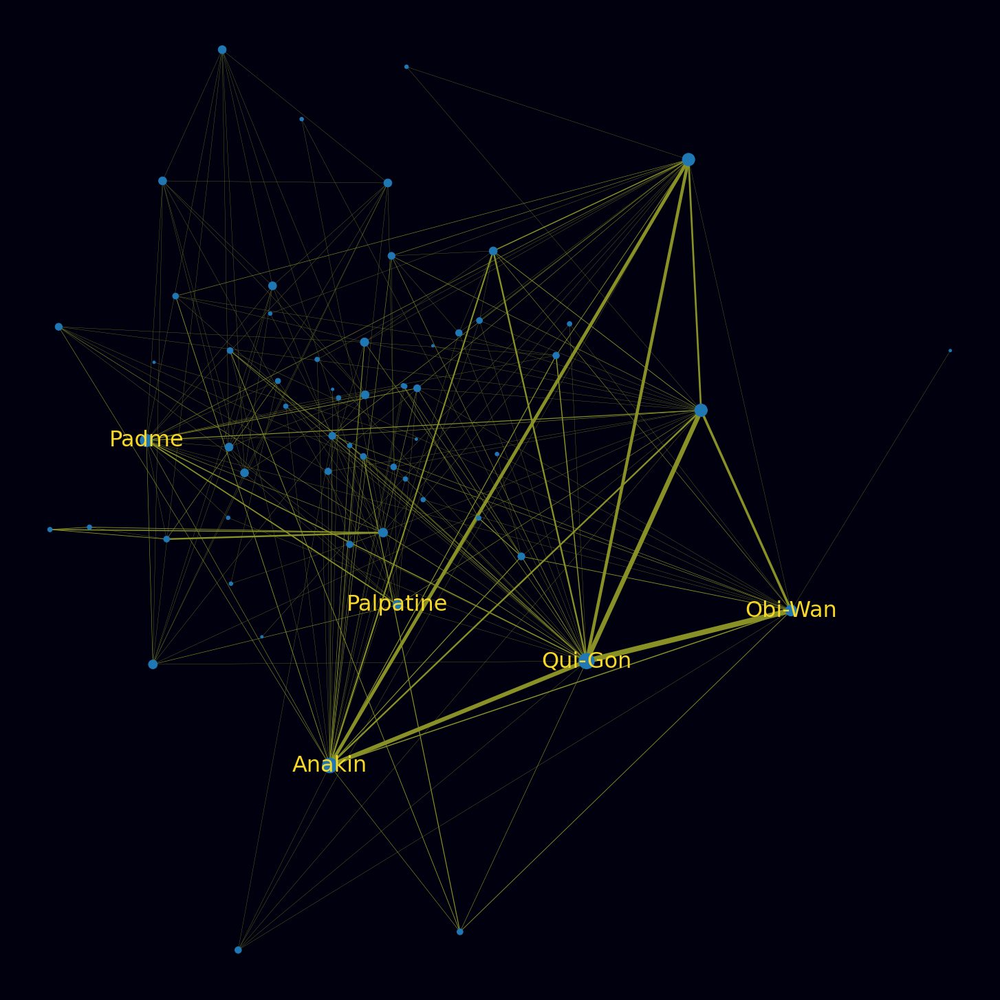

In [291]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

#### Building Interactive Graph

In [292]:
title = "The Phantom Menace"

#getting attributes known for the graphs
res = DF_filter(G.nodes(), char,'Episode I')


Graph_enrich(G,res)


HOVER_TOOLTIPS = [("Character", "@index"),
                  ("Homeworld","@Homeworld"),
                  ("Residence","@Residence"),
                  ("Species","@Species"),
                  ("Gender","@Gender"),
                  
                 ]


node_positions = pairing_function(G.nodes(),positions)
node_size = pairing_function(G.nodes(), node_sizes)

nx.set_node_attributes(G, node_positions, 'node_pos')
nx.set_node_attributes(G, node_size, 'node_size')

plot = figure(tooltips=HOVER_TOOLTIPS,tools="pan,wheel_zoom,save,reset", active_scroll='wheel_zoom',
            plot_width=1000, plot_height=800,
            x_range=Range1d(-3.1,3.1), y_range=Range1d(-3.1,3.1),title = title)

graph_renderer = from_networkx(G, nx.spring_layout, scale=10, center=(0,0))

#style

graph_renderer.node_renderer.glyph = Circle(size=15, fill_color='skyblue')
#graph_renderer.node_renderer.data_source = node_source
#graph_renderer.node_renderer.glyph = Circle(fill_color = 'node_color',size = 'node_size', line_color = None)

#graph_renderer.edge_renderer.glyph = MultiLine(line_color="#CCCCCC", line_alpha=0.8, line_width=2)

#network_graph.edge_renderer.glyph = MultiLine(line_alpha=0.5, line_width=1)

plot.renderers.append(graph_renderer)

show(plot)
output_file(filename="HTML/EpisodeI.html", title='EpisodeI')
save(plot)

'/home/chrypapa/Desktop/DTU/2nd Semester/Social Graphs and Interactions/Final Project/Project Part B/HTML/EpisodeI.html'

### EPISODE II: Attack of the Clones

#### Count dialogues between characters

In [293]:
temp_data = data_scenes[data_scenes['Movie']=='Star-Wars-Attack-of-the-Clones'].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-293-bf569d5c5e9d>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [294]:
char = pd.read_csv('./Data/Characters.csv')

G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge])  

#### Visualize the network

In [295]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

100%|██████████| 1000/1000 [00:00<00:00, 5755.99it/s]

BarnesHut Approximation  took  0.05  seconds
Repulsion forces  took  0.09  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.02  seconds


####  Creating Interactive File

In [296]:
title = "Attack of the Clones"

#getting attributes known for the graphs
res = DF_filter(G.nodes(), char,'Episode II')


Graph_enrich(G,res)


HOVER_TOOLTIPS = [("Character", "@index"),
                  ("Homeworld","@Homeworld"),
                  ("Residence","@Residence"),
                  ("Species","@Species"),
                  ("Gender","@Gender"),
                  
                 ]


node_positions = pairing_function(G.nodes(),positions)
node_size = pairing_function(G.nodes(), node_sizes)

nx.set_node_attributes(G, node_positions, 'node_pos')
nx.set_node_attributes(G, node_size, 'node_size')

plot = figure(tooltips=HOVER_TOOLTIPS,tools="pan,wheel_zoom,save,reset", active_scroll='wheel_zoom',
            plot_width=1000, plot_height=800,
            x_range=Range1d(-3.1,3.1), y_range=Range1d(-3.1,3.1),title = title)

graph_renderer = from_networkx(G, nx.spring_layout, scale=10, center=(0,0))

#style

graph_renderer.node_renderer.glyph = Circle(size=15, fill_color='skyblue')
#graph_renderer.node_renderer.data_source = node_source
#graph_renderer.node_renderer.glyph = Circle(fill_color = 'node_color',size = 'node_size', line_color = None)

#graph_renderer.edge_renderer.glyph = MultiLine(line_color="#CCCCCC", line_alpha=0.8, line_width=2)

#network_graph.edge_renderer.glyph = MultiLine(line_alpha=0.5, line_width=1)

plot.renderers.append(graph_renderer)

show(plot)
output_file(filename="HTML/EpisodeII.html", title='EpisodeII')
save(plot)

'/home/chrypapa/Desktop/DTU/2nd Semester/Social Graphs and Interactions/Final Project/Project Part B/HTML/EpisodeII.html'

### EPISODE III: Revenge of the Sith

#### Count dialogues between characters

In [297]:
temp_data = data_scenes[data_scenes['Movie']=='Star-Wars-Revenge-of-the-Sith'].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-297-2404902ea155>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


In [298]:
char = pd.read_csv('./Data/Characters.csv')


G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge])  

#### Visualize the network

In [299]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

100%|██████████| 1000/1000 [00:00<00:00, 18914.82it/s]

BarnesHut Approximation  took  0.02  seconds
Repulsion forces  took  0.02  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.01  seconds


#### Creating Interactive File

In [300]:
title = "Attack of the Clones"

title = "Revenge of the Sith"

#getting attributes known for the graphs
res = DF_filter(G.nodes(), char,'Episode III')


Graph_enrich(G,res)


HOVER_TOOLTIPS = [("Character", "@index"),
                  ("Homeworld","@Homeworld"),
                  ("Residence","@Residence"),
                  ("Species","@Species"),
                  ("Gender","@Gender"),
                  
                 ]


node_positions = pairing_function(G.nodes(),positions)
node_size = pairing_function(G.nodes(), node_sizes)

nx.set_node_attributes(G, node_positions, 'node_pos')
nx.set_node_attributes(G, node_size, 'node_size')

plot = figure(tooltips=HOVER_TOOLTIPS,tools="pan,wheel_zoom,save,reset", active_scroll='wheel_zoom',
            plot_width=1000, plot_height=800,
            x_range=Range1d(-3.1,3.1), y_range=Range1d(-3.1,3.1),title = title)

graph_renderer = from_networkx(G, nx.spring_layout, scale=10, center=(0,0))

#style

graph_renderer.node_renderer.glyph = Circle(size=15, fill_color='skyblue')
#graph_renderer.node_renderer.data_source = node_source
#graph_renderer.node_renderer.glyph = Circle(fill_color = 'node_color',size = 'node_size', line_color = None)

#graph_renderer.edge_renderer.glyph = MultiLine(line_color="#CCCCCC", line_alpha=0.8, line_width=2)

#network_graph.edge_renderer.glyph = MultiLine(line_alpha=0.5, line_width=1)

plot.renderers.append(graph_renderer)

show(plot)
output_file(filename="HTML/EpisodeIII.html", title='Episode III')
save(plot)

'/home/chrypapa/Desktop/DTU/2nd Semester/Social Graphs and Interactions/Final Project/Project Part B/HTML/EpisodeIII.html'

### EPISODE IV: A New Hope

#### Count dialogues between characters

In [301]:
temp_data = data_scenes[data_scenes['Movie']=='Star-Wars-A-New-Hope'].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-301-54ac0a276aa7>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [302]:
char = pd.read_csv('./Data/Characters.csv')

G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge])  

#### Visualize the network

In [303]:
G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

100%|██████████| 1000/1000 [00:00<00:00, 4093.72it/s]

BarnesHut Approximation  took  0.06  seconds
Repulsion forces  took  0.13  seconds
Gravitational forces  took  0.01  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.02  seconds


In [304]:
char = pd.read_csv('./Data/Characters.csv')

title = "A New Hope"

#getting attributes known for the graphs
res = DF_filter(G.nodes(), char,'Episode IV')


Graph_enrich(G,res)


HOVER_TOOLTIPS = [("Character", "@index"),
                  ("Homeworld","@Homeworld"),
                  ("Residence","@Residence"),
                  ("Species","@Species"),
                  ("Gender","@Gender"),
                  
                 ]


node_positions = pairing_function(G.nodes(),positions)
node_size = pairing_function(G.nodes(), node_sizes)

nx.set_node_attributes(G, node_positions, 'node_pos')
nx.set_node_attributes(G, node_size, 'node_size')

plot = figure(tooltips=HOVER_TOOLTIPS,tools="pan,wheel_zoom,save,reset", active_scroll='wheel_zoom',
            plot_width=1000, plot_height=800,
            x_range=Range1d(-3.1,3.1), y_range=Range1d(-3.1,3.1),title = title)

graph_renderer = from_networkx(G, nx.spring_layout, scale=10, center=(0,0))

#style

graph_renderer.node_renderer.glyph = Circle(size=15, fill_color='skyblue')
#graph_renderer.node_renderer.data_source = node_source
#graph_renderer.node_renderer.glyph = Circle(fill_color = 'node_color',size = 'node_size', line_color = None)

#graph_renderer.edge_renderer.glyph = MultiLine(line_color="#CCCCCC", line_alpha=0.8, line_width=2)

#network_graph.edge_renderer.glyph = MultiLine(line_alpha=0.5, line_width=1)

plot.renderers.append(graph_renderer)

show(plot)
output_file(filename="HTML/EpisodeIV.html", title='Episode IV')
save(plot)

'/home/chrypapa/Desktop/DTU/2nd Semester/Social Graphs and Interactions/Final Project/Project Part B/HTML/EpisodeIV.html'

### EPISODE V: The Empire Strikes Back

#### Count dialogues between characters

In [305]:
temp_data = data_scenes[data_scenes['Movie']=='Star-Wars-The-Empire-Strikes-Back'].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-305-90278e58a6b9>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [306]:
char = pd.read_csv('./Data/Characters.csv')

G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

100%|██████████| 1000/1000 [00:00<00:00, 4614.43it/s]

BarnesHut Approximation  took  0.05  seconds
Repulsion forces  took  0.11  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.02  seconds


#### Create Interactive Network

In [307]:
title = "The Empire Strikes Back"

#getting attributes known for the graphs
res = DF_filter(G.nodes(), char,'Episode V')


Graph_enrich(G,res)


HOVER_TOOLTIPS = [("Character", "@index"),
                  ("Homeworld","@Homeworld"),
                  ("Residence","@Residence"),
                  ("Species","@Species"),
                  ("Gender","@Gender"),
                  
                 ]


node_positions = pairing_function(G.nodes(),positions)
node_size = pairing_function(G.nodes(), node_sizes)

nx.set_node_attributes(G, node_positions, 'node_pos')
nx.set_node_attributes(G, node_size, 'node_size')

plot = figure(tooltips=HOVER_TOOLTIPS,tools="pan,wheel_zoom,save,reset", active_scroll='wheel_zoom',
            plot_width=1000, plot_height=800,
            x_range=Range1d(-3.1,3.1), y_range=Range1d(-3.1,3.1),title = title)

graph_renderer = from_networkx(G, nx.spring_layout, scale=10, center=(0,0))

#style

graph_renderer.node_renderer.glyph = Circle(size=15, fill_color='skyblue')
#graph_renderer.node_renderer.data_source = node_source
#graph_renderer.node_renderer.glyph = Circle(fill_color = 'node_color',size = 'node_size', line_color = None)

#graph_renderer.edge_renderer.glyph = MultiLine(line_color="#CCCCCC", line_alpha=0.8, line_width=2)

#network_graph.edge_renderer.glyph = MultiLine(line_alpha=0.5, line_width=1)

plot.renderers.append(graph_renderer)

show(plot)
output_file(filename="HTML/EpisodeV.html", title='Episode V')
save(plot)

'/home/chrypapa/Desktop/DTU/2nd Semester/Social Graphs and Interactions/Final Project/Project Part B/HTML/EpisodeV.html'

### EPISODE VI: Return of the Jedi

#### Create Interactive Network

In [308]:
temp_data = data_scenes[data_scenes['Movie']=='Star-Wars-Return-of-the-Jedi'].reset_index(drop=True)
char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()

char_data = pd.DataFrame(columns=list(char_dial[0].unique()))
for char in list(char_dial[0].unique()):
    temp_char_dial = []
    for c_dial in list(char_dial[0].unique()):
        counter = 0
        for scene in range(len(temp_data)):
            if temp_data['Scene_Characters'][scene]!=None:
                if (c_dial in temp_data['Scene_Characters'][scene]) and (char in temp_data['Scene_Characters'][scene]):
                    counter += 1
        temp_char_dial.append(counter)
    char_data.loc[len(char_data)] = temp_char_dial    
char_data.index = list(char_dial[0].unique())

<ipython-input-308-48ade0796064>:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  char_dial = temp_data.apply(lambda x: pd.Series(x['Scene_Characters']),axis=1).stack().reset_index(level=1, drop=True).reset_index()


#### Create the network

In [309]:
char = pd.read_csv('./Data/Characters.csv')

G = nx.DiGraph()
for temp_char in list(char_dial[0].unique()):
    # Add nodes
    G.add_node(temp_char)
    
    # Add edges
    for char_edge in list(char_dial[0].unique()):
        if (temp_char != char_edge) and (char_data.loc[temp_char, char_edge] != 0):
            G.add_edge(temp_char, char_edge, weight=char_data.loc[temp_char, char_edge])  

#### Visualize the network

In [312]:
char = pd.read_csv('./Data/Characters.csv')

G = G.to_undirected()

forceatlas2 = ForceAtlas2(scalingRatio = 100, gravity = 1000)
positions = forceatlas2.forceatlas2_networkx_layout(G, pos = None, iterations = 1000)

node_sizes = [degree*15 for degree in dict(G.degree()).values()]
edge_sizes = [G[u][v]['weight']*0.3 for u,v in G.edges()]

100%|██████████| 1000/1000 [00:00<00:00, 9608.97it/s]

BarnesHut Approximation  took  0.03  seconds
Repulsion forces  took  0.05  seconds
Gravitational forces  took  0.00  seconds
Attraction forces  took  0.00  seconds
AdjustSpeedAndApplyForces step  took  0.01  seconds


In [313]:
print(G.nodes())

print('HF' in 'fhjfghf'.upper())
print(isinstance('fhjfghf', str))

def name_filtering(list1,element):
    assert isinstance(element, dict) , 'element is not a dictionary' 
    for i in list1:
        assert isinstance(i, str) , 'list wit non str element' 
        if( i.upper()) in element['Name'].upper() : return element ,i
    return None
print(name_filtering(['vaggelis', 'Maria', 'Scizor'], {'Name':'---'})) 

def DF_filter(list ,df, episode ):
    assert isinstance(episode, str), "episodde is not a string"
    assert isinstance(df, pd.core.frame.DataFrame), 'df not a Dataframe'
    filtered = [name_filtering(list,dict(row)) for _,row in df.iterrows()]
    res = []
    for i in filtered:
        if i != None:
            if i[0][episode] == 1:
             res.append(i)
    return res

def Graph_enrich(G, List):
    for attr,node in List:
        G.nodes[node].update(attr)
    
res = DF_filter(G.nodes(), char,'Episode VI')
Graph_enrich(G,res)

['SHUTTLE CAPTAIN', 'OFFICER', 'OPERATOR', 'JERJERROD', 'VADER', 'LUKE', 'EMPEROR', 'PIETT', 'GUARD', 'COMMANDER', 'LURE', 'ANAKIN', 'THREEPIO', 'STRANGE VOICE', 'BIB', 'JABBA', 'NINEDENINE', 'OOLA', 'BOUSHH', 'HAN', 'LEIA', 'LANDO', 'MON MOTHMA', 'ACKBAR', 'GENERAL MADINE', 'STORMTROOPER', 'BUNKER COMMANDER', 'YODA', 'BEN', 'WEDGE', 'GRAY LEADER', 'GREEN LEADER', 'CONTROLLER', 'REBEL PILOT', 'RED TWO', 'RED THREE', 'NAVIGATOR', 'YWING PILOT', 'PILOT', 'SCOUT', 'SECOND COMMANDER']
True
True
None


#### Creating Interactive Networks

In [314]:
char = pd.read_csv('./Data/Characters.csv')


title = "Return of the jedi"

#getting attributes known for the graphs
res = DF_filter(G.nodes(), char,'Episode VI')


Graph_enrich(G,res)


HOVER_TOOLTIPS = [("Character", "@index"),
                  ("Homeworld","@Homeworld"),
                  ("Residence","@Residence"),
                  ("Species","@Species"),
                  ("Gender","@Gender"),
                  
                 ]


node_positions = pairing_function(G.nodes(),positions)
node_size = pairing_function(G.nodes(), node_sizes)

nx.set_node_attributes(G, node_positions, 'node_pos')
nx.set_node_attributes(G, node_size, 'node_size')

plot = figure(tooltips=HOVER_TOOLTIPS,tools="pan,wheel_zoom,save,reset", active_scroll='wheel_zoom',
            plot_width=1000, plot_height=800,
            x_range=Range1d(-3.1,3.1), y_range=Range1d(-3.1,3.1),title = title)

graph_renderer = from_networkx(G, nx.spring_layout, scale=10, center=(0,0))

#style

graph_renderer.node_renderer.glyph = Circle(size=15, fill_color='skyblue')
#graph_renderer.node_renderer.data_source = node_source
#graph_renderer.node_renderer.glyph = Circle(fill_color = 'node_color',size = 'node_size', line_color = None)

#graph_renderer.edge_renderer.glyph = MultiLine(line_color="#CCCCCC", line_alpha=0.8, line_width=2)

#network_graph.edge_renderer.glyph = MultiLine(line_alpha=0.5, line_width=1)

plot.renderers.append(graph_renderer)

show(plot)
output_file(filename="HTML/EpisodeVI.html", title='Episode VI')
save(plot)

'/home/chrypapa/Desktop/DTU/2nd Semester/Social Graphs and Interactions/Final Project/Project Part B/HTML/EpisodeVI.html'

# Discussion. Think critically about your creation

As we were able to download the scripts for the movies, it gave us the opportunity to get a better overview around the universe of Star Wars. It was really interesting to see the low sentiment scores behind the movies and how they possibly correlate with the importance of the character and not necessarily if he is considered good or bad.

Unfortunately, there were many things that could have gone better. Firstly it would be nice to have a more organised and concentrated analysis behind Anakin Skywalker, from the beginning of the movie when he was a child to its end where he became Darth Vader. Furthermore, as the universe is so big we could also explore the latest movie, but also the tv series.

Moreover, our analysis could also have been better. Firstly, we didn't spend time analysing the attributes of the network and their statistics behind it. Attributes like homeworld, gender and species were completely unexploited. Also we extracted so many data that could have high correlation between them, but were also unexploited. 

Lastly, the webpage could have been more user friendly, explaining more thing and having much more interaction with the user.

# Contributions. Who did what?

- Chrysostomos Papadopoulos (S210603) was responsible for the video.
- Chrysostomos Papadopoulos (S210603) was responsible for the website.
- Chrysostomos Papadopoulos (S210603) was responsible for downloading the pages from Wikia.
- Chrysostomos Papadopoulos (S210603) was responsible for downloading and preprocessing the scripts.
- Chrysostomos Papadopoulos (S210603) was responsible for the video.
- Chrysostomos Papadopoulos (S210603) was responsible for creating and visualizing the networks.
- Chrysostomos Papadopoulos (S210603) was responsible for mentioned characters.
- Chrysostomos Papadopoulos (S210603) was responsible for the sentiment analysis of the characters.
- Chrysostomos Papadopoulos (S210603) was responsible for comparing character's timeline with sentiment timeline.
- Chrysostomos Papadopoulos (S210603) was responsible for wordclouds.
- Evangelos Kalimantzalis Lianas (S210260) was responsible for creating the interactive networks.